**Integrantes** (Grupo 7):
*   Jorge Palacios
*   Rodrigo Araos
* Fernando Guerrero
* Ademir Muñoz

#Instalación de librerías necesarias

In [ ]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
from plotnine import *
from sklearn.model_selection import train_test_split, cross_val_score, KFold
from sklearn.svm import SVC
from sklearn.multiclass import OneVsOneClassifier
from sklearn.multiclass import OneVsRestClassifier
from sklearn.metrics import classification_report
from sklearn.impute import SimpleImputer
from sklearn.preprocessing import StandardScaler
from sklearn.tree import DecisionTreeClassifier
from sklearn.tree import plot_tree
from sklearn.ensemble import RandomForestClassifier
from pandas.plotting import scatter_matrix
from mlxtend.plotting import plot_decision_regions

#Importación de datasets

In [ ]:
!git clone "https://github.com/Sylver640/DatasetsIA.git"

Cloning into 'DatasetsIA'...
remote: Enumerating objects: 5, done.
remote: Counting objects: 100% (5/5), done.
remote: Compressing objects: 100% (5/5), done.
remote: Total 5 (delta 0), reused 0 (delta 0), pack-reused 0
Unpacking objects: 100% (5/5), 92.58 KiB | 1.42 MiB/s, done.


In [ ]:
redWines = pd.read_csv("DatasetsIA/winequality-red.csv", sep=";")
whiteWines = pd.read_csv("DatasetsIA/winequality-white.csv", sep=";")

In [ ]:
redWines.head()

,fixed acidity,volatile acidity,citric acid,residual sugar,chlorides,free sulfur dioxide,total sulfur dioxide,density,pH,sulphates,alcohol,quality
0,7.4,0.70,0.00,1.9,0.076,11.0,34.0,0.9978,3.51,0.56,9.4,5
1,7.8,0.88,0.00,2.6,0.098,25.0,67.0,0.9968,3.20,0.68,9.8,5
2,7.8,0.76,0.04,2.3,0.092,15.0,54.0,0.9970,3.26,0.65,9.8,5
3,11.2,0.28,0.56,1.9,0.075,17.0,60.0,0.9980,3.16,0.58,9.8,6
4,7.4,0.70,0.00,1.9,0.076,11.0,34.0,0.9978,3.51,0.56,9.4,5


In [ ]:
whiteWines.head()

,fixed acidity,volatile acidity,citric acid,residual sugar,chlorides,free sulfur dioxide,total sulfur dioxide,density,pH,sulphates,alcohol,quality
0,7.0,0.27,0.36,20.7,0.045,45.0,170.0,1.0010,3.00,0.45,8.8,6
1,6.3,0.30,0.34,1.6,0.049,14.0,132.0,0.9940,3.30,0.49,9.5,6
2,8.1,0.28,0.40,6.9,0.050,30.0,97.0,0.9951,3.26,0.44,10.1,6
3,7.2,0.23,0.32,8.5,0.058,47.0,186.0,0.9956,3.19,0.40,9.9,6
4,7.2,0.23,0.32,8.5,0.058,47.0,186.0,0.9956,3.19,0.40,9.9,6


#Análisis exploratorio de datos
Al igual que el laboratorio anterior, tomaremos en consideración los dos datasets de vino portugués: `winequality-white.csv` y `winequality-red.csv`. Cada uno, tal como lo dice en sus nombres, contiene datos de vinos blancos y rojos respectivamente. En esta ocasión lo que queremos realizar es clasificar los vinos de acuerdo a su calidad. Por lo que para ello realizaremos un análisis de acuerdo a estas necesidades.

Para comenzar, crearemos una nueva columna en cada dataset, la que llamaremos "category". Ésta se dividirá en tres atributos, los cuales se definirán de la siguiente manera:
* LowQuality (quality = 0, 1, 2, 3, 4, 5)
* Average (quality = 6)
* HighQuality (quality = 7, 8, 9, 10)

In [ ]:
# Creamos la nueva columna
qualityNames = {0: 'LowQuality', 1: 'LowQuality', 2: 'LowQuality', 3: 'LowQuality',
                4: 'LowQuality', 5: 'LowQuality', 6: 'Average', 7: 'HighQuality',
                8: 'HighQuality', 9: 'HighQuality', 10: 'HighQuality'}

whiteWines['category'] = whiteWines['quality'].map(qualityNames) #Lo agregamos a los vinos blancos
redWines['category'] = redWines['quality'].map(qualityNames) #Y también a los rojos

Por lo que, con estos datos ya incluidos, es seguro comenzar nuestro análisis con tal de realizar una clasificación.

In [ ]:
whiteWines.head()

,fixed acidity,volatile acidity,citric acid,residual sugar,chlorides,free sulfur dioxide,total sulfur dioxide,density,pH,sulphates,alcohol,quality,category
0,7.0,0.27,0.36,20.7,0.045,45.0,170.0,1.0010,3.00,0.45,8.8,6,Average
1,6.3,0.30,0.34,1.6,0.049,14.0,132.0,0.9940,3.30,0.49,9.5,6,Average
2,8.1,0.28,0.40,6.9,0.050,30.0,97.0,0.9951,3.26,0.44,10.1,6,Average
3,7.2,0.23,0.32,8.5,0.058,47.0,186.0,0.9956,3.19,0.40,9.9,6,Average
4,7.2,0.23,0.32,8.5,0.058,47.0,186.0,0.9956,3.19,0.40,9.9,6,Average


In [ ]:
redWines.head()

,fixed acidity,volatile acidity,citric acid,residual sugar,chlorides,free sulfur dioxide,total sulfur dioxide,density,pH,sulphates,alcohol,quality,category
0,7.4,0.70,0.00,1.9,0.076,11.0,34.0,0.9978,3.51,0.56,9.4,5,LowQuality
1,7.8,0.88,0.00,2.6,0.098,25.0,67.0,0.9968,3.20,0.68,9.8,5,LowQuality
2,7.8,0.76,0.04,2.3,0.092,15.0,54.0,0.9970,3.26,0.65,9.8,5,LowQuality
3,11.2,0.28,0.56,1.9,0.075,17.0,60.0,0.9980,3.16,0.58,9.8,6,Average
4,7.4,0.70,0.00,1.9,0.076,11.0,34.0,0.9978,3.51,0.56,9.4,5,LowQuality


Para comenzar, mostraremos en pantalla la información de lo que contiene cada set de datos, con lo que veremos si es que alguno de estos contiene datos nulos y definir el tipo de dato de cada columna.

In [ ]:
whiteWines.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 4898 entries, 0 to 4897
Data columns (total 13 columns):
 #   Column                Non-Null Count  Dtype  
---  ------                --------------  -----  
 0   fixed acidity         4898 non-null   float64
 1   volatile acidity      4898 non-null   float64
 2   citric acid           4898 non-null   float64
 3   residual sugar        4898 non-null   float64
 4   chlorides             4898 non-null   float64
 5   free sulfur dioxide   4898 non-null   float64
 6   total sulfur dioxide  4898 non-null   float64
 7   density               4898 non-null   float64
 8   pH                    4898 non-null   float64
 9   sulphates             4898 non-null   float64
 10  alcohol               4898 non-null   float64
 11  quality               4898 non-null   int64  
 12  category              4898 non-null   object 
dtypes: float64(11), int64(1), object(1)
memory usage: 497.6+ KB


In [ ]:
redWines.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1599 entries, 0 to 1598
Data columns (total 13 columns):
 #   Column                Non-Null Count  Dtype  
---  ------                --------------  -----  
 0   fixed acidity         1599 non-null   float64
 1   volatile acidity      1599 non-null   float64
 2   citric acid           1599 non-null   float64
 3   residual sugar        1599 non-null   float64
 4   chlorides             1599 non-null   float64
 5   free sulfur dioxide   1599 non-null   float64
 6   total sulfur dioxide  1599 non-null   float64
 7   density               1599 non-null   float64
 8   pH                    1599 non-null   float64
 9   sulphates             1599 non-null   float64
 10  alcohol               1599 non-null   float64
 11  quality               1599 non-null   int64  
 12  category              1599 non-null   object 
dtypes: float64(11), int64(1), object(1)
memory usage: 162.5+ KB


Como podemos apreciar, ninguno de los dos contienen datos nulos, por lo que no es necesario realizar alguna limpieza de estos. Además, de todos los datos 11 son de tipo flotante, mientras que `quality` es de tipo entero y `category` es objeto, puesto que está compuesto de solo cadenas.

Ahora, con ayuda del comando `describe` veremos cómo es que distribuyen los datos de acuerdo a distintas métricas.

In [ ]:
whiteWines.describe()

,fixed acidity,volatile acidity,citric acid,residual sugar,chlorides,free sulfur dioxide,total sulfur dioxide,density,pH,sulphates,alcohol,quality
count,4898.000000,4898.000000,4898.000000,4898.000000,4898.000000,4898.000000,4898.000000,4898.000000,4898.000000,4898.000000,4898.000000,4898.000000
mean,6.854788,0.278241,0.334192,6.391415,0.045772,35.308085,138.360657,0.994027,3.188267,0.489847,10.514267,5.877909
std,0.843868,0.100795,0.121020,5.072058,0.021848,17.007137,42.498065,0.002991,0.151001,0.114126,1.230621,0.885639
min,3.800000,0.080000,0.000000,0.600000,0.009000,2.000000,9.000000,0.987110,2.720000,0.220000,8.000000,3.000000
25%,6.300000,0.210000,0.270000,1.700000,0.036000,23.000000,108.000000,0.991723,3.090000,0.410000,9.500000,5.000000
50%,6.800000,0.260000,0.320000,5.200000,0.043000,34.000000,134.000000,0.993740,3.180000,0.470000,10.400000,6.000000
75%,7.300000,0.320000,0.390000,9.900000,0.050000,46.000000,167.000000,0.996100,3.280000,0.550000,11.400000,6.000000
max,14.200000,1.100000,1.660000,65.800000,0.346000,289.000000,440.000000,1.038980,3.820000,1.080000,14.200000,9.000000


En el caso de los vinos blancos, vemos cómo es que la calidad promedio es cercana a 6, es decir, muchos de éstos pueden ser de categoria `Average`, siendo además este valor la mediana. La calidad mínima en este dataset es de 3 y la máxima es de 9.

In [ ]:
redWines.describe()

,fixed acidity,volatile acidity,citric acid,residual sugar,chlorides,free sulfur dioxide,total sulfur dioxide,density,pH,sulphates,alcohol,quality
count,1599.000000,1599.000000,1599.000000,1599.000000,1599.000000,1599.000000,1599.000000,1599.000000,1599.000000,1599.000000,1599.000000,1599.000000
mean,8.319637,0.527821,0.270976,2.538806,0.087467,15.874922,46.467792,0.996747,3.311113,0.658149,10.422983,5.636023
std,1.741096,0.179060,0.194801,1.409928,0.047065,10.460157,32.895324,0.001887,0.154386,0.169507,1.065668,0.807569
min,4.600000,0.120000,0.000000,0.900000,0.012000,1.000000,6.000000,0.990070,2.740000,0.330000,8.400000,3.000000
25%,7.100000,0.390000,0.090000,1.900000,0.070000,7.000000,22.000000,0.995600,3.210000,0.550000,9.500000,5.000000
50%,7.900000,0.520000,0.260000,2.200000,0.079000,14.000000,38.000000,0.996750,3.310000,0.620000,10.200000,6.000000
75%,9.200000,0.640000,0.420000,2.600000,0.090000,21.000000,62.000000,0.997835,3.400000,0.730000,11.100000,6.000000
max,15.900000,1.580000,1.000000,15.500000,0.611000,72.000000,289.000000,1.003690,4.010000,2.000000,14.900000,8.000000


Por otro lado, con los vinos rojos se repite la misma situación, siendo la mediana la calidad de valor 6 y el promedio un valor cercano a éste, aunque ahora menor en dos décimas en comparación al anterior. La calidad mínima en este dataset es de 3 y la máxima es de 8.

Para observar mejor cómo se distribuyen estas categorías, con ayuda de un gráfico contaremos cuántas instancias hay de cada una en el dataset.

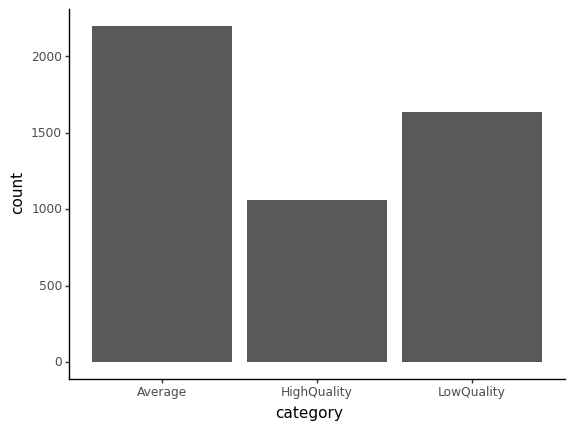

<ggplot: (8735112213198)>

In [ ]:
#Vinos blancos
(
    ggplot(whiteWines)+
    aes(x='category', y='..count..')+
    geom_bar()+
    theme_classic()
)

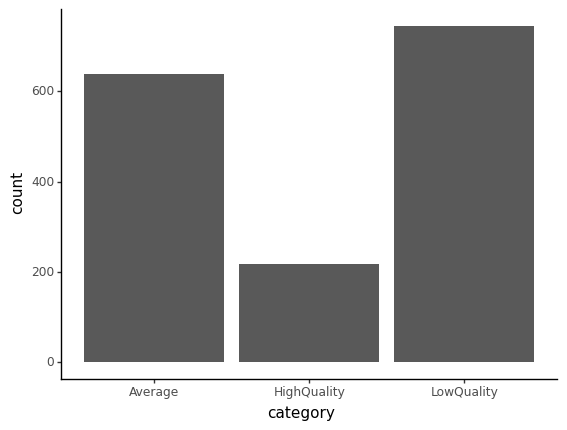

<ggplot: (8735112158212)>

In [ ]:
#Vinos rojos
(
    ggplot(redWines)+
    aes(x='category', y='..count..')+
    geom_bar()+
    theme_classic()
)

Tras realizar los gráficos anteriores, observamos como es que en dataset se repite el caso en donde la categoría menos prominente es `HighQuality`, habiendo 1000 en los vinos blancos y cerca de 200 en los vinos rojos. No obstante, la principal diferencia está con la categoría con **más** apariciones, puesto que, en el caso de los vinos blancos, muchos de los datos corresponden a la categoría `Average`, mientras que los vinos rojos contienen en su mayoría aquellos de `LowQuality`.

Con ayuda de la librería **Seaborn** y su comando "pairplot" veremos cómo se ve cada gráfico para cada atributo con su scatterplot correspondiente, cuyos puntos se ajustarán para que su color corresponda a una categoría.

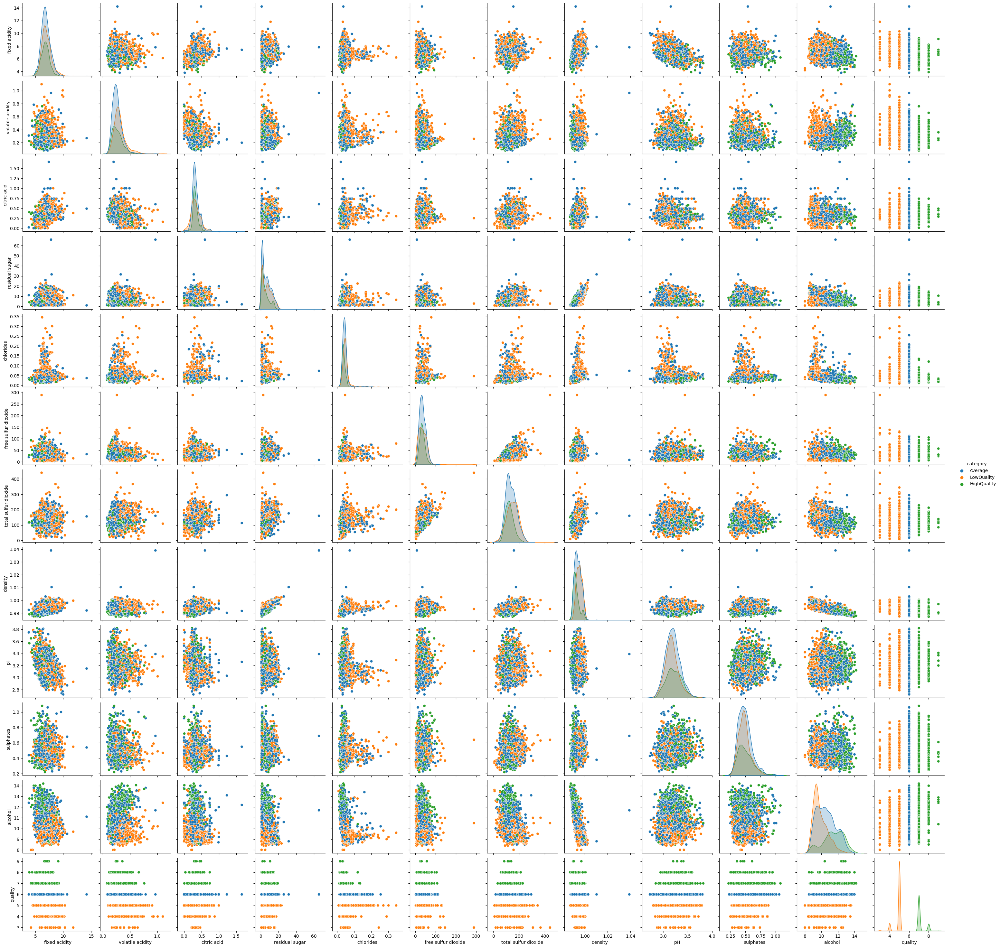

In [ ]:
#Vinos blancos
sns.pairplot(whiteWines, hue='category');

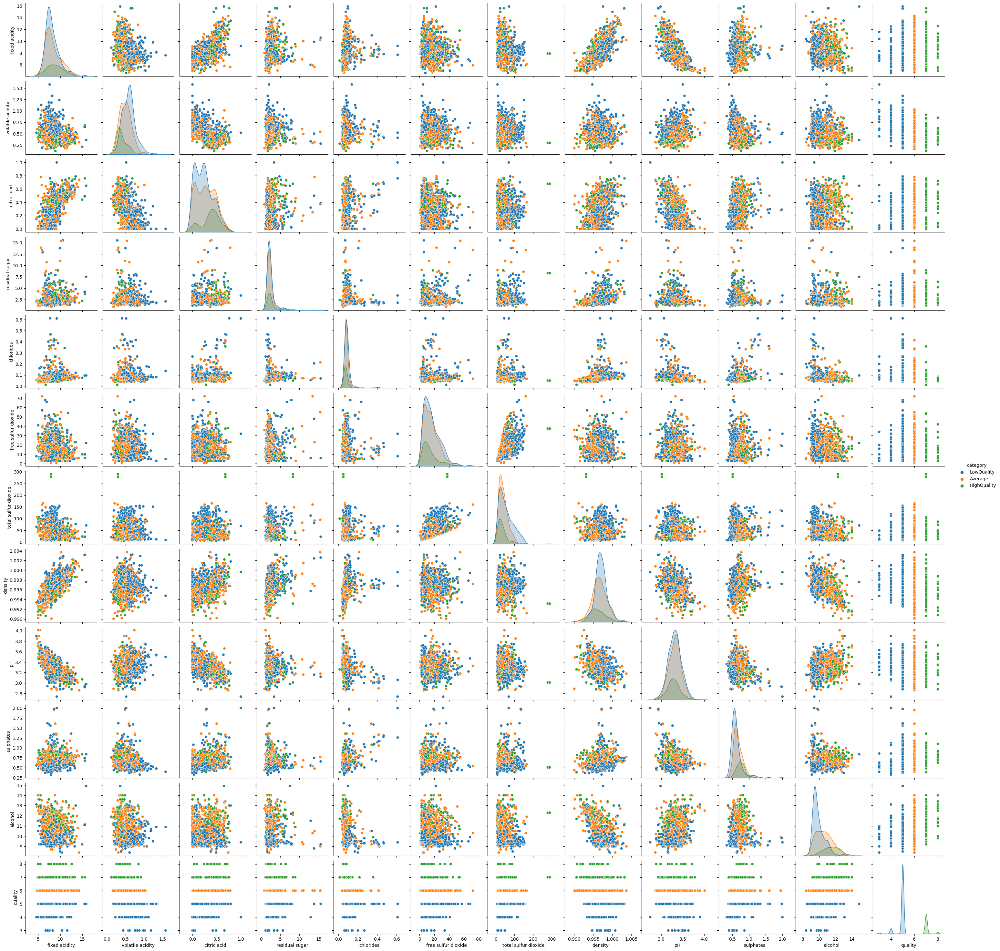

In [ ]:
#Vinos rojos
sns.pairplot(redWines, hue='category');

##Boxplots

Al observar las colecciones de gráficos nos podemos hacer una idea de cómo están distribuidos los datos. En el laboratorio pasado explicamos que ambos datasets poseen una cantidad importante de outliers, lo que en esa ocasión no nos generaba mayor inconveniente. No obstante, a la hora de desear clasificar estos sí es probable que nuestros resultados no sean los más óptimos.

Estos outliers se pueden ver claramente en algunos de los scatterplots visibles, pero para un mejor análisis revisaremos en detalle los boxplots generados con cada atributo, esto para vinos blancos y rojos.

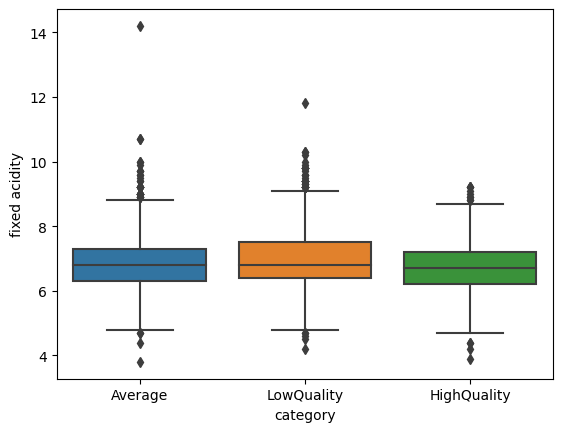

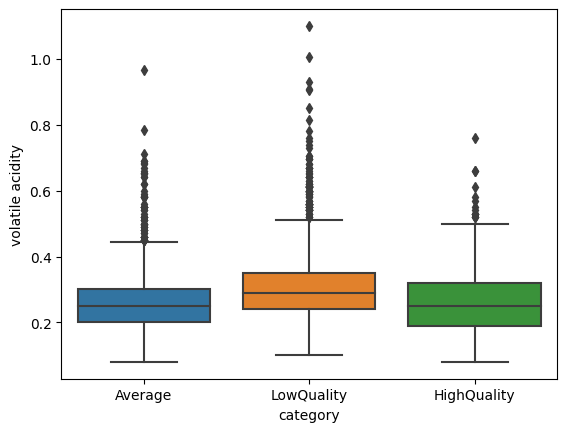

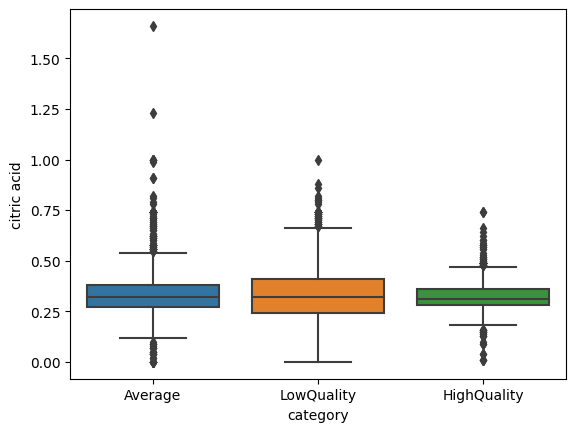

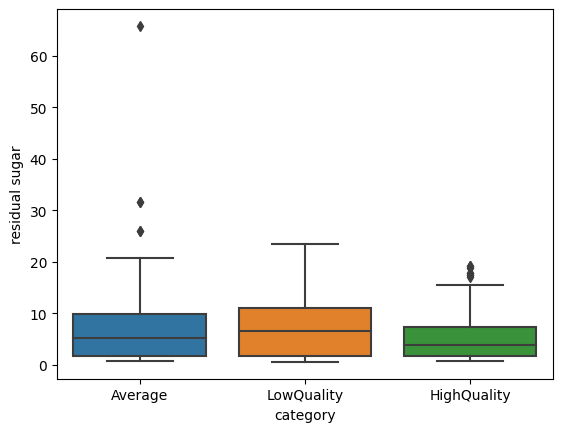

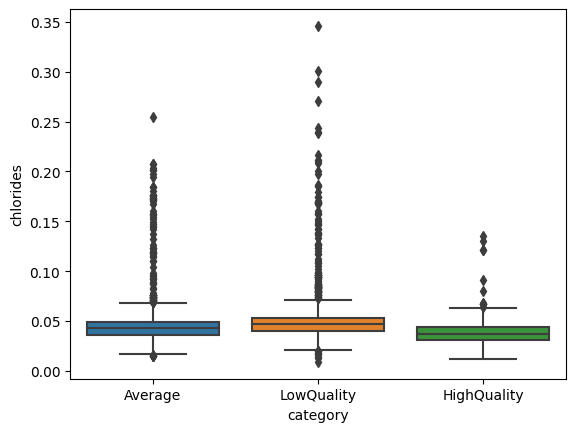

...

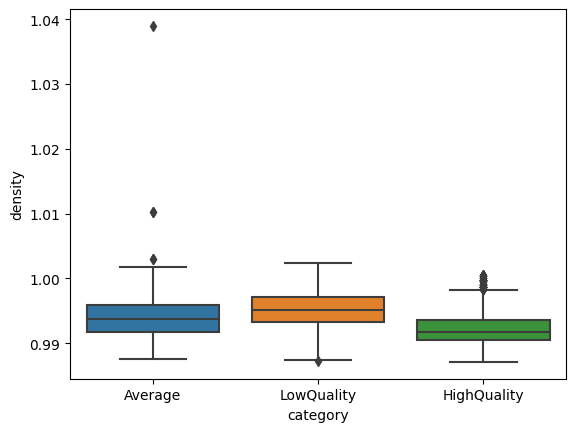

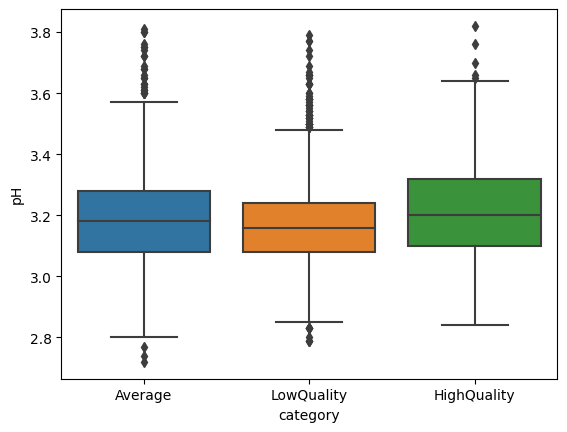

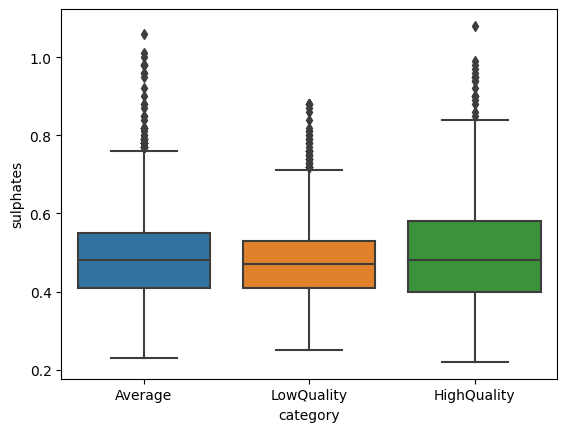

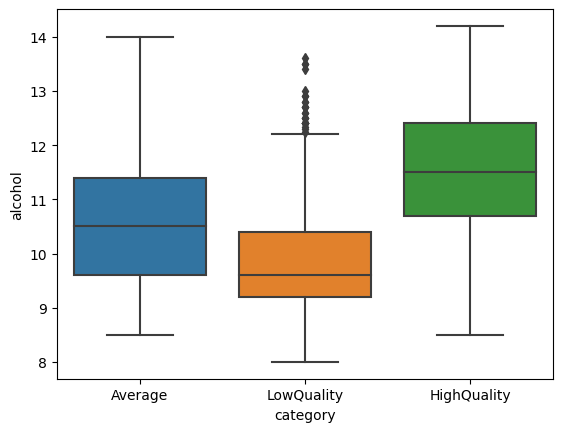

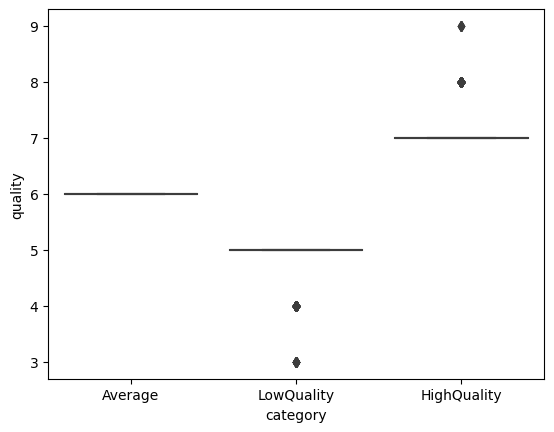

In [ ]:
#Vinos blancos
for i in range(12):
  sns.boxplot(x='category', y=whiteWines.columns[i], data = whiteWines)
  plt.show()

En el caso de las cajas y bigotes provenientes del dataset de vinos blancos, nos damos cuenta que efectivamente muchos de los atributos presentan muchos outliers al momento de definir cada categoría, en especial con "volatile acidity" y "chlorides".

No obstante, sin contar el atributo de "quality", podemos observar que dentro de la colección de boxplots existen algunos que están mejor distribuidos que otros, donde cada caja está más separada de otra, lo cual facilitaría el trabajo del clasificador y otorgaría mejores resultados. En nuestro caso, elegiremos tres: **"alcohol", "density" y "total sulfur dioxide"**.

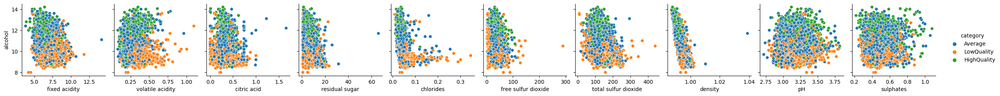

In [ ]:
#Gráficos de punto de alcohol
sns.pairplot(whiteWines, hue='category', x_vars=["fixed acidity", "volatile acidity", "citric acid", "residual sugar",
                                                 "chlorides", "free sulfur dioxide", "total sulfur dioxide", "density", "pH", "sulphates"],
             y_vars=['alcohol'])

Observando en detalle, utilizaremos el gráfico "alcohol v/s volatile acidity", debido a que nos otorga una mejor distribución visual.

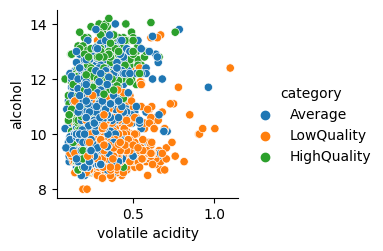

In [ ]:
sns.pairplot(whiteWines, hue='category', x_vars=["volatile acidity"], y_vars=["alcohol"])

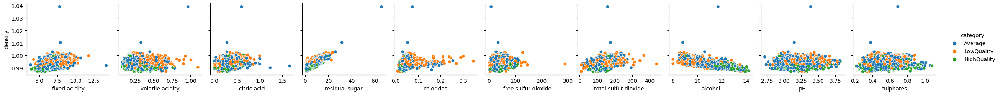

In [ ]:
#Gráficos de punto de density
sns.pairplot(whiteWines, hue='category', x_vars=["fixed acidity", "volatile acidity", "citric acid", "residual sugar",
                                                 "chlorides", "free sulfur dioxide", "total sulfur dioxide", "alcohol", "pH", "sulphates"],
             y_vars=['density'])

En este caso, pensamos que el mejor es "density v/s volatile acidity", el cual, aunque posea muchos de sus puntos muy pegados unos a los otros, es posible ver cómo es el que tiene mejor distribución de cada categoría.

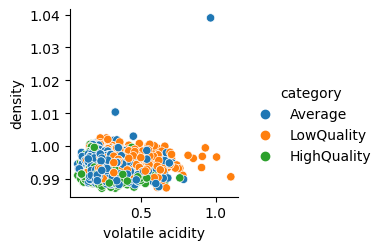

In [ ]:
sns.pairplot(whiteWines, hue='category', x_vars=["volatile acidity"], y_vars=["density"])

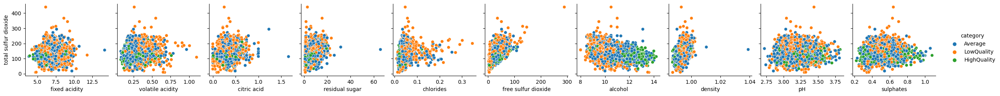

In [ ]:
#Gráficos de punto de total sulfur dioxide
sns.pairplot(whiteWines, hue='category', x_vars=["fixed acidity", "volatile acidity", "citric acid", "residual sugar",
                                                 "chlorides", "free sulfur dioxide", "alcohol", "density", "pH", "sulphates"],
             y_vars=['total sulfur dioxide'])

Terminando con los vinos blancos, tomaremos como gráfico de "total sulfur dioxide" aquel que tiene como variable independiente o en el eje x al atributo "alcohol".

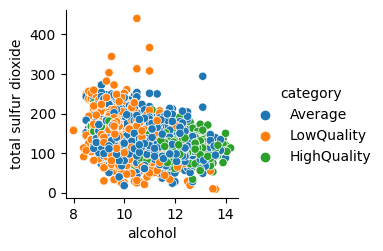

In [ ]:
sns.pairplot(whiteWines, hue='category', x_vars=["alcohol"], y_vars=["total sulfur dioxide"])

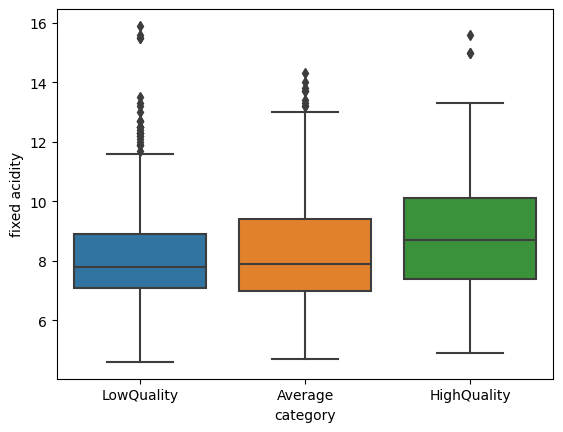

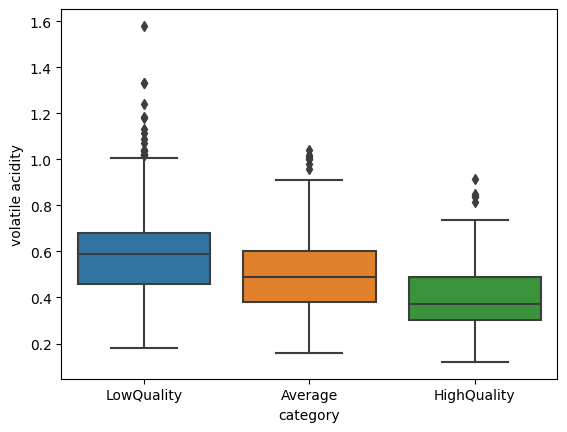

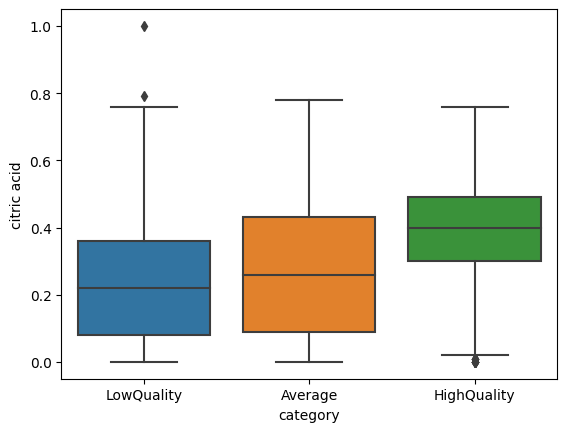

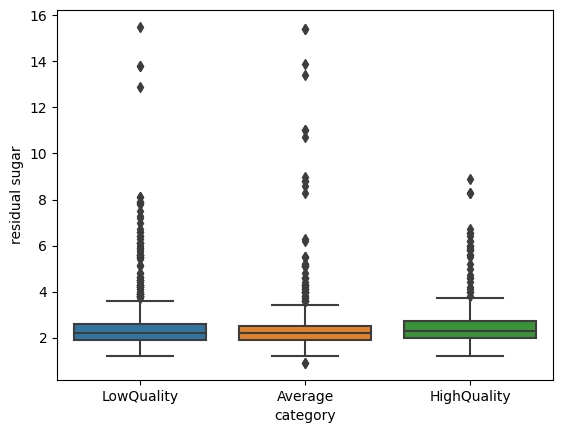

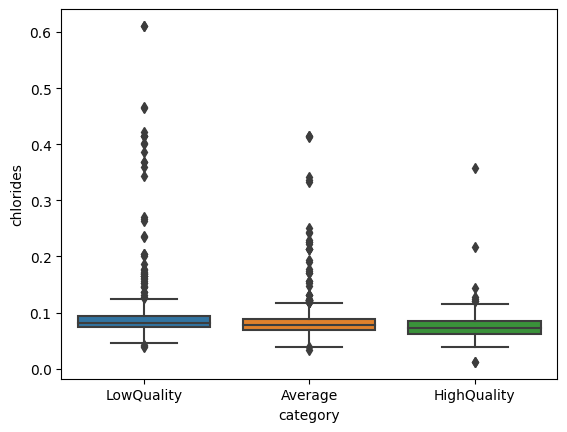

...

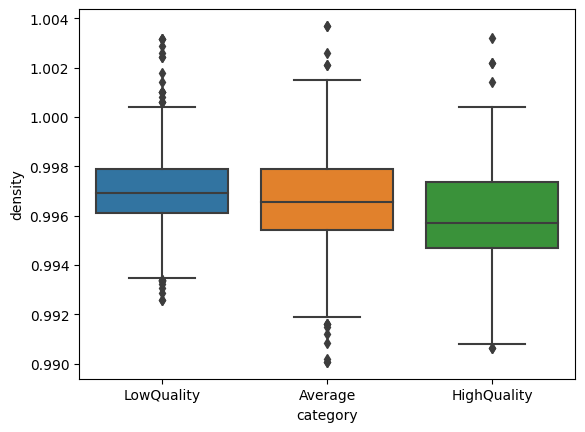

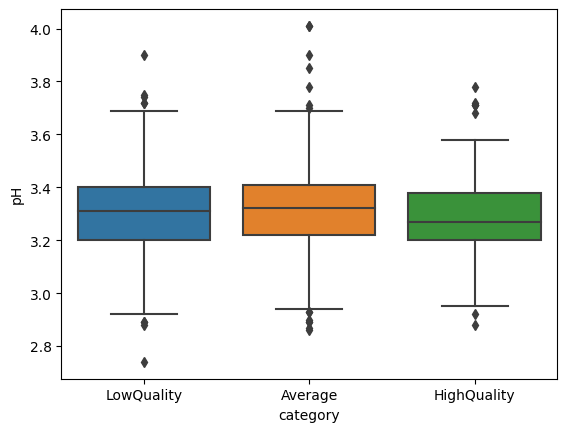

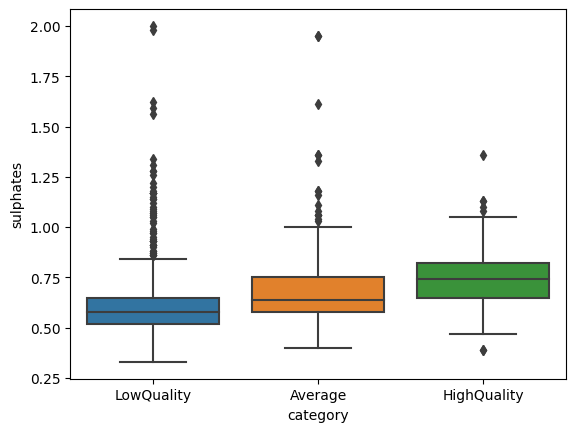

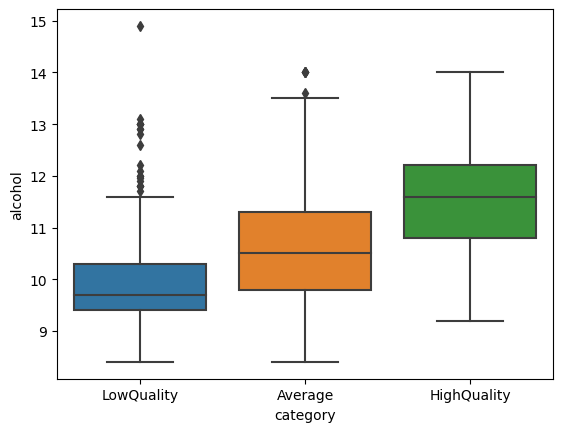

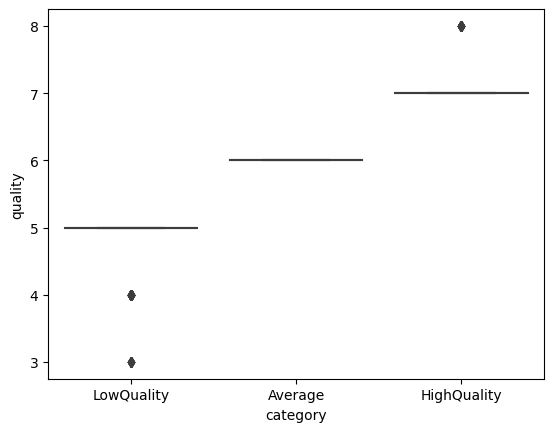

In [ ]:
#Vinos rojos
for i in range(12):
  sns.boxplot(x='category', y=redWines.columns[i], data = redWines)
  plt.show()

Lo mismo podemos decir del dataset de vinos rojos, que nos provee resultados similares al anterior, siendo en este caso los atributos con mayor cantidad de outliers "residual sugar" y "chlorides".

Así, analizando la distribución de estos, los atributos que analizaremos de este dataset serán: **"alcohol", "volatile acidity" y "sulphates"**.

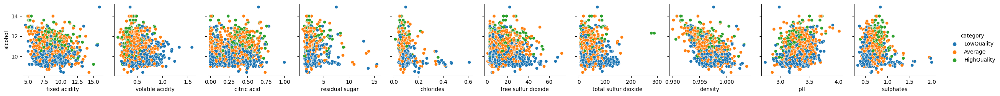

In [ ]:
#Gráficos de punto de alcohol
sns.pairplot(redWines, hue='category', x_vars=["fixed acidity", "volatile acidity", "citric acid", "residual sugar",
                                                 "chlorides", "free sulfur dioxide", "total sulfur dioxide", "density", "pH", "sulphates"],
             y_vars=['alcohol'])

En el caso del atributo "alcohol" elegiremos como variable del eje x a "sulphates", puesto que pensamos es aquel que tiene mejor distribución.

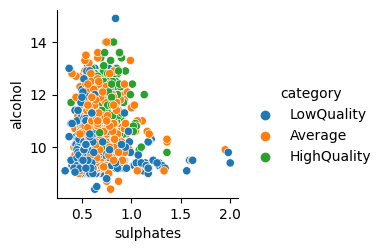

In [ ]:
sns.pairplot(redWines, hue='category', x_vars=["sulphates"], y_vars=["alcohol"])

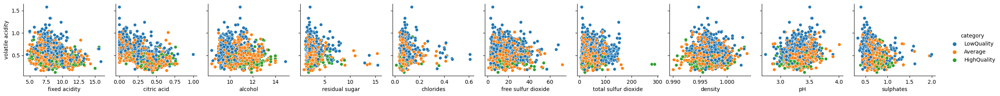

In [ ]:
#Gráficos de punto de volatile acidity
sns.pairplot(redWines, hue='category', x_vars=["fixed acidity", "citric acid", "alcohol", "residual sugar",
                                                 "chlorides", "free sulfur dioxide", "total sulfur dioxide", "density", "pH", "sulphates"],
             y_vars=['volatile acidity'])

Con el atributo "volatile acidity", si bien la mayoría de gráficos no nos otorgan las mejores opciones para clasificar, "alcohol" es el que posee una mejor distribución a nuestro criterio.

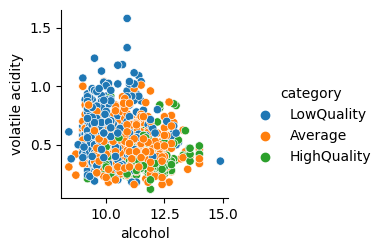

In [ ]:
sns.pairplot(redWines, hue='category', x_vars=["alcohol"], y_vars=["volatile acidity"])

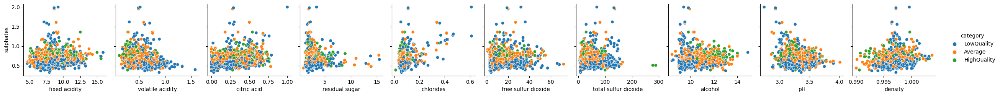

In [ ]:
#Gráficos de punto de sulphates
sns.pairplot(redWines, hue='category', x_vars=["fixed acidity", "volatile acidity", "citric acid", "residual sugar",
                                                 "chlorides", "free sulfur dioxide", "total sulfur dioxide", "alcohol", "pH", "density"],
             y_vars=['sulphates'])

Por último, en cuanto al atributo "sulphates" utilizaremos el gráfico de puntos que posee junto a la variable independiente "free sulfur dioxide".

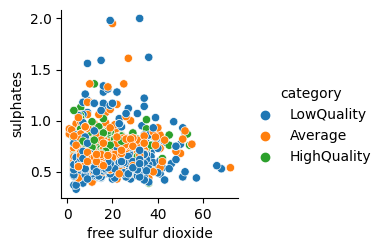

In [ ]:
sns.pairplot(redWines, hue='category', x_vars=["free sulfur dioxide"], y_vars=["sulphates"])

#Clasificación
A continuación, en este punto procederemos al proceso de machine learning referente a la **clasificación de los datos**. Como se vio en el EDA, decidimos que para lograr mejores resultados, considerando la mala distribución de los datos al momento de graficar, lo mejor es elegir los gráficos cuyos puntos permitan un mejor modelo.

Para realizar la clasificación de cada gráfica implementaremos tres modelos diferentes:
* A base de máquina de soporte vectorial (SVM)
* A base de árboles de decisión
* A base de random forest (SVM)

Para cada uno de ellos existirán dos ejecuciones: una que considere el procedimiento de K-Fold Cross Validation, y otra que no; a partir de las cuales se realizará un análisis para ver cuál tuvo mejor rendimiento.

Finalmente, para una mejor compatibilidad con las diferentes funciones de aprendizaje, se añadirá una nueva columna llamada "categoryNum", que almacena de forma numérica cada categoría de la siguiente forma: LowQuality es igual a 1, Average es igual a 2 y HighQuality es igual a 3.

In [ ]:
categoryNum={0:1, 1:1, 2:1, 3:1, 4:1, 5:1, 6:2, 7:3, 8:3, 9:3, 10:3}
#vinos blancos
whiteWines['categoryNum'] = whiteWines['quality'].map(categoryNum)
whiteWines['categoryNum'] = pd.to_numeric(whiteWines['categoryNum'])
#vinos tintos
redWines['categoryNum'] = redWines['quality'].map(categoryNum)
redWines['categoryNum'] = pd.to_numeric(redWines['categoryNum'])

##1. Support Vector Machine (SVM)
Para analizar este algoritmo de clasificación procederemos a comparar, además de la implementación de K-Fold Cross Validation, el uso de dos estrategias para trabajar con múltiples clases: **One v/s One** y **One v/s All**.

###Funciones
A continuación se encuentran aquellas necesarias para un funcionamiento y análisis correcto del presente modelo.

In [ ]:
from itertools import combinations

def svmClassification(var1, var2, classifier, dataset, strategy, kFold = False):
  #Inicializamos los datos
  x = dataset[[var1, var2]] #var1 = x; var2 = y
  y = dataset[classifier] #Clasificador

  #Dividimos los datos en test y train, con un tamaño 20/80 respectivamente
  xTrain, xTest, yTrain, yTest = train_test_split(x, y, test_size=0.2)

  #Estrategia OneVsOne
  if (strategy == "ovo"):
    #Creamos nuestro modelo a base del clasificador indicado, pero indicando que es un SVM lineal
    model = OneVsOneClassifier(SVC(kernel='linear'))
    if (kFold): #Entrenamos nuestro datos con kFold Cross Validation
      kfold = KFold(n_splits=5, shuffle=True, random_state=42)
      score = cross_val_score(model,xTrain,yTrain,cv=kfold)
    model.fit(xTrain, yTrain) #Ajustamos el modelo
    yPred = model.predict(xTest) #Predecimos el modelo
    print(classification_report(yTest, yPred)) #Se muestra en pantalla el reporte de clasificación con los detalles de la matriz de confusión

    #Con tal de graficar, se convierten nuestros datos de series a arreglos
    x_show = x.values
    y_show = y.values

    #Segmento para graficar el modelo

    #Se calculan los valores mínimos y máximos para los ejes x e y
    xMin, xMax = x_show[:,0].min() - 1, x_show[:,0].max()+1
    yMin, yMax = x_show[:,1].min() - 1, x_show[:,1].max()+1

    #Se crea la cuadrícula de puntos utilizando como referencia los valores obtenidos previamente
    xPlot, yPlot = np.meshgrid(np.arange(xMin, xMax, 0.1), np.arange(yMin, yMax, 0.1))
    modelPlot = model.predict(np.c_[xPlot.ravel(),yPlot.ravel()]) #Se predicen los datos en la cuadrícula
    modelPlot = modelPlot.reshape(xPlot.shape) #Remodelamos la predicción de acuerdo a la que encontramos en la variable "xPlot"

    #Se dibujan los contornos de decisión
    plt.contourf(xPlot,yPlot,modelPlot, alpha=0.5)
    plt.scatter(x_show[:,0], x_show[:,1], c=y_show, cmap=plt.cm.get_cmap('viridis', 3), edgecolors='k') #Creamos el scatterplot
    plt.colorbar(label='Quality Category')
    plt.title("Estrategia One vs One")
    plt.xlabel(var1)
    plt.ylabel(var2)
    plt.show() #Se muestra el gráfico en pantalla

  #Estrategia OneVsAll
  elif (strategy == "ovr"):
    model = OneVsRestClassifier(SVC(kernel='linear'))
    if (kFold):
      kfold = KFold(n_splits=5, shuffle=True, random_state=42)
      score = cross_val_score(model,xTrain,yTrain,cv=kfold)
    model.fit(xTrain, yTrain)
    yPred = model.predict(xTest)
    print(classification_report(yTest, yPred))
    x_show = x.values
    y_show = y.values

    xMin, xMax = x_show[:,0].min() - 1, x_show[:,0].max()+1
    yMin, yMax = x_show[:,1].min() - 1, x_show[:,1].max()+1

    xPlot, yPlot = np.meshgrid(np.arange(xMin, xMax, 0.1), np.arange(yMin, yMax, 0.1))
    modelPlot = model.predict(np.c_[xPlot.ravel(),yPlot.ravel()])
    modelPlot = modelPlot.reshape(xPlot.shape)

    plt.contourf(xPlot,yPlot,modelPlot, alpha=0.5)
    plt.scatter(x_show[:,0], x_show[:,1], c=y_show, cmap=plt.cm.get_cmap('viridis', 3), edgecolors='k')
    plt.colorbar(label='Quality Category')
    plt.title("Estrategia One vs All")
    plt.xlabel(var1)
    plt.ylabel(var2)
    plt.show()
  else:
    print("not valid strategy") #Si no se ingresa una estrategia válida, se imprime por pantalla este mensaje

###Vinos blancos

####Atributo *alcohol*

#####Con K-Fold Cross Validation

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
/usr/local/lib/python3.10/dist-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but OneVsOneClassifier was fitted with feature names


              precision    recall  f1-score   support

           1       0.58      0.62      0.60       306
           2       0.52      0.74      0.61       455
           3       0.00      0.00      0.00       219

    accuracy                           0.54       980
   macro avg       0.36      0.45      0.40       980
weighted avg       0.42      0.54      0.47       980



<ipython-input-6-85caa080a0a2>:39: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.


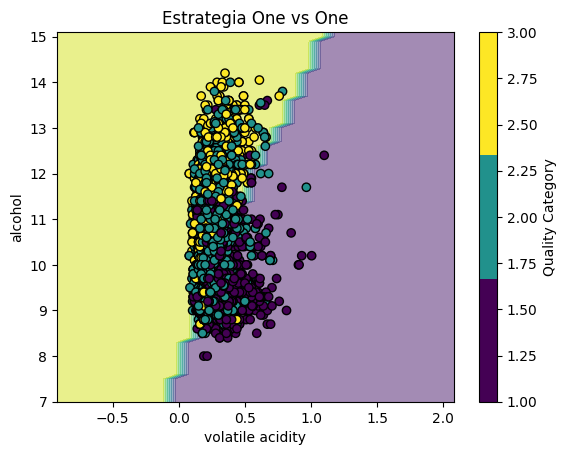

In [ ]:
svmClassification('volatile acidity','alcohol','categoryNum',whiteWines, "ovo", True);

              precision    recall  f1-score   support

           1       0.47      0.88      0.61       312
           2       0.49      0.42      0.45       446
           3       1.00      0.03      0.06       222

    accuracy                           0.48       980
   macro avg       0.65      0.44      0.37       980
weighted avg       0.60      0.48      0.41       980



/usr/local/lib/python3.10/dist-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but SVC was fitted with feature names
/usr/local/lib/python3.10/dist-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but SVC was fitted with feature names
/usr/local/lib/python3.10/dist-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but SVC was fitted with feature names
<ipython-input-6-85caa080a0a2>:66: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.


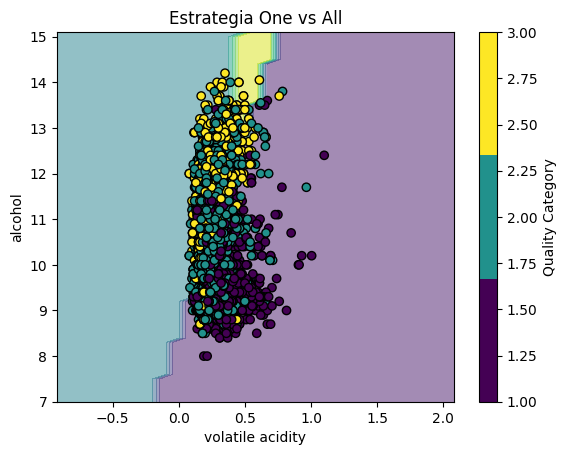

In [ ]:
svmClassification('volatile acidity','alcohol','categoryNum',whiteWines, "ovr", True);

#####Sin K-Fold Cross Validation

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
/usr/local/lib/python3.10/dist-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but OneVsOneClassifier was fitted with feature names


              precision    recall  f1-score   support

           1       0.64      0.63      0.64       333
           2       0.50      0.75      0.60       428
           3       0.00      0.00      0.00       219

    accuracy                           0.54       980
   macro avg       0.38      0.46      0.41       980
weighted avg       0.43      0.54      0.48       980



<ipython-input-6-85caa080a0a2>:39: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.


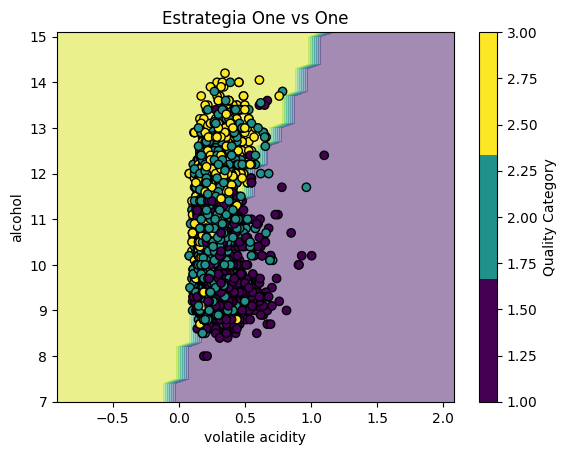

In [ ]:
svmClassification('volatile acidity','alcohol','categoryNum',whiteWines, "ovo");

              precision    recall  f1-score   support

           1       0.49      0.84      0.62       329
           2       0.49      0.43      0.46       437
           3       0.53      0.08      0.15       214

    accuracy                           0.49       980
   macro avg       0.50      0.45      0.41       980
weighted avg       0.50      0.49      0.44       980



/usr/local/lib/python3.10/dist-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but SVC was fitted with feature names
/usr/local/lib/python3.10/dist-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but SVC was fitted with feature names
/usr/local/lib/python3.10/dist-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but SVC was fitted with feature names
<ipython-input-6-85caa080a0a2>:66: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.


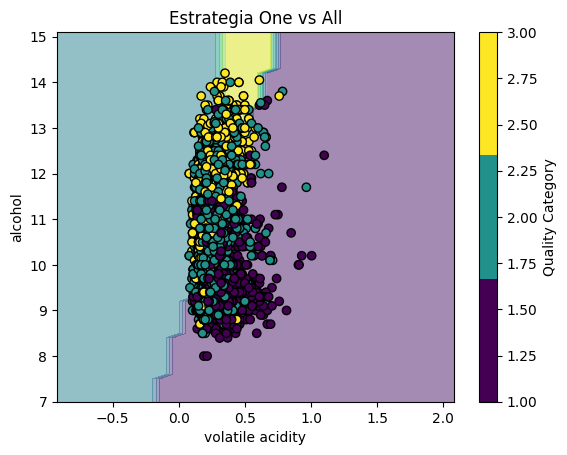

In [ ]:
svmClassification('volatile acidity','alcohol','categoryNum',whiteWines, "ovr");

#####Conclusiones y observaciones
* La estrategia de One v/s One presenta una precisión total de 0 para la tercera categoría, tanto en la implementación con K-Fold como la que no lo utiliza.
* En el caso de One v/s All con K-Fold observamos una precisión absoluta con la categoría de "HighQuality", lo que significa un bajísimo equilibrio entre verdaderos positivos y falsos negativos.
* En todos los modelos la exactitud de los modelos es cercana al 50%.
* Mejores resultados: modelos sin la métrica de K-Fold, donde One v/s All es al menos 1% más eficiente que aquel que la implementa.

####Atributo *density*

#####Con K-Fold Cross Validation

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
/usr/local/lib/python3.10/dist-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but OneVsOneClassifier was fitted with feature names
<ipython-input-6-85caa080a0a2>:39: MatplotlibDeprecationWarning: 

              precision    recall  f1-score   support

           1       0.50      0.14      0.23       352
           2       0.45      0.93      0.61       429
           3       0.00      0.00      0.00       199

    accuracy                           0.46       980
   macro avg       0.32      0.36      0.28       980
weighted avg       0.38      0.46      0.35       980



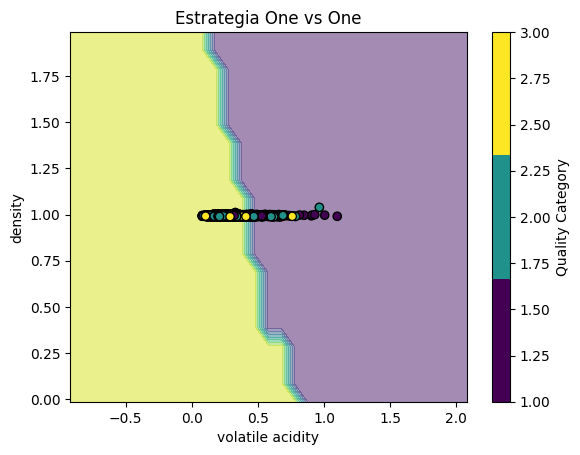

In [ ]:
svmClassification('volatile acidity','density','categoryNum',whiteWines, "ovo", True);

              precision    recall  f1-score   support

           1       0.45      0.80      0.57       326
           2       0.54      0.14      0.22       430
           3       0.38      0.48      0.42       224

    accuracy                           0.44       980
   macro avg       0.45      0.47      0.41       980
weighted avg       0.47      0.44      0.39       980



/usr/local/lib/python3.10/dist-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but SVC was fitted with feature names
/usr/local/lib/python3.10/dist-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but SVC was fitted with feature names
/usr/local/lib/python3.10/dist-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but SVC was fitted with feature names
<ipython-input-6-85caa080a0a2>:66: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.


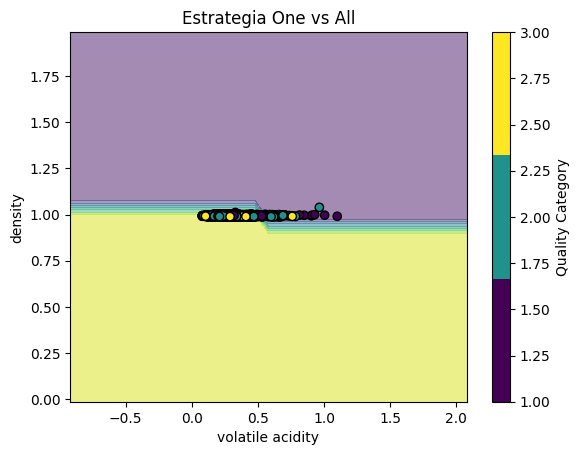

In [ ]:
svmClassification('volatile acidity','density','categoryNum',whiteWines, "ovr", True);

#####Sin K-Fold Cross Validation

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
/usr/local/lib/python3.10/dist-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but OneVsOneClassifier was fitted with feature names
<ipython-input-6-85caa080a0a2>:39: MatplotlibDeprecationWarning: 

              precision    recall  f1-score   support

           1       0.58      0.16      0.25       330
           2       0.49      0.95      0.64       458
           3       0.00      0.00      0.00       192

    accuracy                           0.50       980
   macro avg       0.36      0.37      0.30       980
weighted avg       0.42      0.50      0.39       980



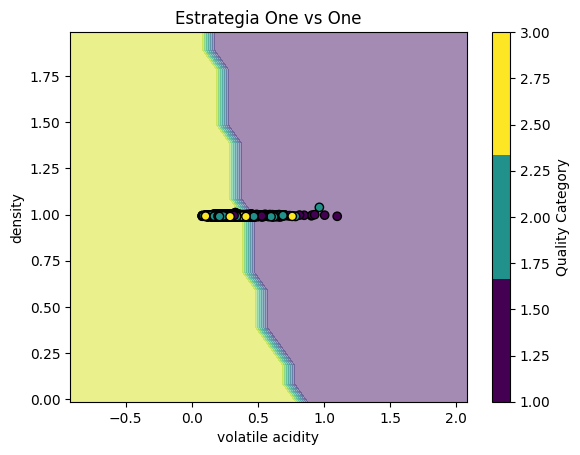

In [ ]:
svmClassification('volatile acidity','density','categoryNum',whiteWines, "ovo");

              precision    recall  f1-score   support

           1       0.49      0.79      0.60       354
           2       0.50      0.15      0.23       416
           3       0.38      0.52      0.44       210

    accuracy                           0.46       980
   macro avg       0.46      0.49      0.42       980
weighted avg       0.47      0.46      0.41       980



/usr/local/lib/python3.10/dist-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but SVC was fitted with feature names
/usr/local/lib/python3.10/dist-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but SVC was fitted with feature names
/usr/local/lib/python3.10/dist-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but SVC was fitted with feature names
<ipython-input-6-85caa080a0a2>:66: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.


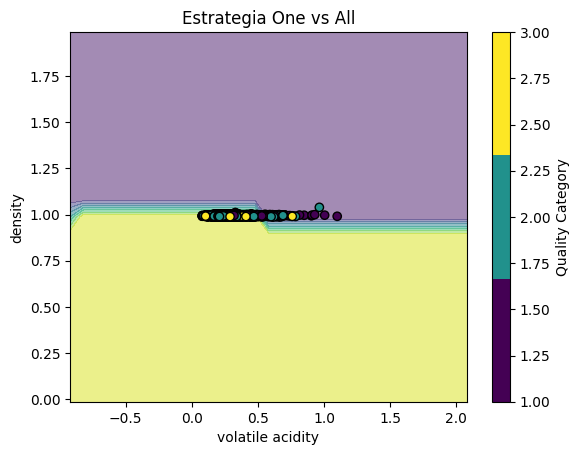

In [ ]:
svmClassification('volatile acidity','density','categoryNum',whiteWines, "ovr");

#####Conclusiones y observaciones
* Nuevamente las implementaciones que utilizan como base la estrategia de One v/s One presentan una precisión, recall y puntaje F1 del 0% en la tercera clasificante.
* La precisión de tanto "LowQuality" como "Average" presenta valores en el rango de 40%-60% en todos los modelos.
* En ambas clasificaciones de One v/s All la precisión de "HighQuality" fue del 38%. Estos resultados se pueden deber a que esta categoría es la que posee menos representantes al momento de dividir el dataset.
* Guiándonos por las exactitudes de cada modelo, vemos que para este atributo son mejores aquellos que no utilizan K-Fold, puesto que las dos estrategias presentes allí. Más específicamente la clasificación OvO tiene una exactitud del 50% y la OvA un valor de 46%, en contraste al 46% y 44% de los modelos que utilizan la técnica de entrenamiento.

####Atributo *total sulfure dioxide*

#####Con K-Fold Cross Validation

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
/usr/local/lib/python3.10/dist-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but OneVsOneClassifier was fitted with feature names


              precision    recall  f1-score   support

           1       0.48      0.64      0.55       295
           2       0.49      0.64      0.55       453
           3       0.00      0.00      0.00       232

    accuracy                           0.49       980
   macro avg       0.32      0.43      0.37       980
weighted avg       0.37      0.49      0.42       980



<ipython-input-6-85caa080a0a2>:39: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.


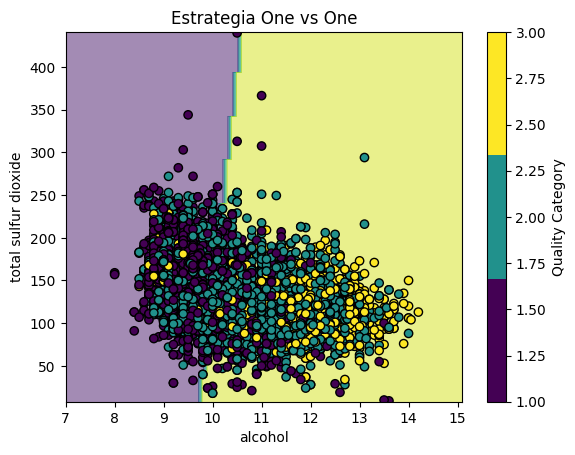

In [ ]:
svmClassification('alcohol','total sulfur dioxide','categoryNum',whiteWines, "ovo", True);

              precision    recall  f1-score   support

           1       0.55      0.67      0.61       325
           2       0.53      0.54      0.54       445
           3       0.48      0.30      0.37       210

    accuracy                           0.53       980
   macro avg       0.52      0.50      0.50       980
weighted avg       0.53      0.53      0.52       980



/usr/local/lib/python3.10/dist-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but SVC was fitted with feature names
/usr/local/lib/python3.10/dist-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but SVC was fitted with feature names
/usr/local/lib/python3.10/dist-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but SVC was fitted with feature names
<ipython-input-6-85caa080a0a2>:66: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.


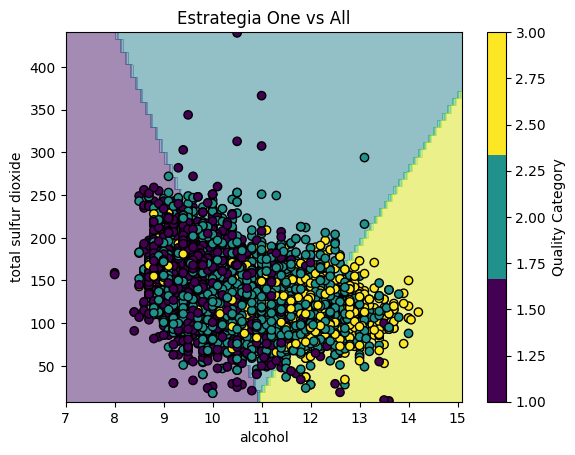

In [ ]:
svmClassification('alcohol','total sulfur dioxide','categoryNum',whiteWines, "ovr", True);

#####Sin K-Fold Cross Validation

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
/usr/local/lib/python3.10/dist-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but OneVsOneClassifier was fitted with feature names


              precision    recall  f1-score   support

           1       0.48      0.68      0.56       298
           2       0.49      0.59      0.54       463
           3       0.00      0.00      0.00       219

    accuracy                           0.49       980
   macro avg       0.32      0.42      0.37       980
weighted avg       0.38      0.49      0.43       980



<ipython-input-6-85caa080a0a2>:39: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.


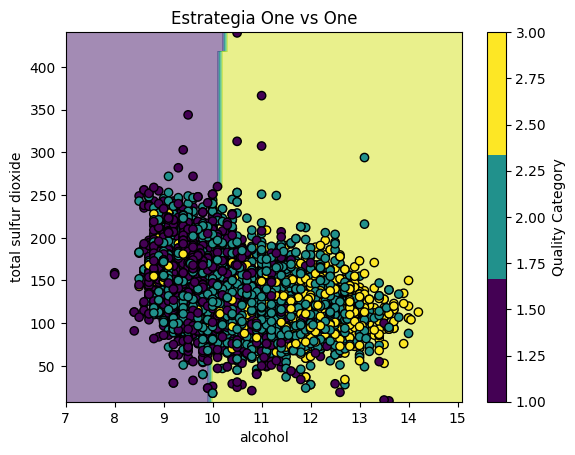

In [ ]:
svmClassification('alcohol','total sulfur dioxide','categoryNum',whiteWines, "ovo");

              precision    recall  f1-score   support

           1       0.54      0.65      0.59       347
           2       0.49      0.54      0.51       426
           3       0.56      0.26      0.35       207

    accuracy                           0.52       980
   macro avg       0.53      0.48      0.49       980
weighted avg       0.52      0.52      0.51       980



/usr/local/lib/python3.10/dist-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but SVC was fitted with feature names
/usr/local/lib/python3.10/dist-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but SVC was fitted with feature names
/usr/local/lib/python3.10/dist-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but SVC was fitted with feature names
<ipython-input-6-85caa080a0a2>:66: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.


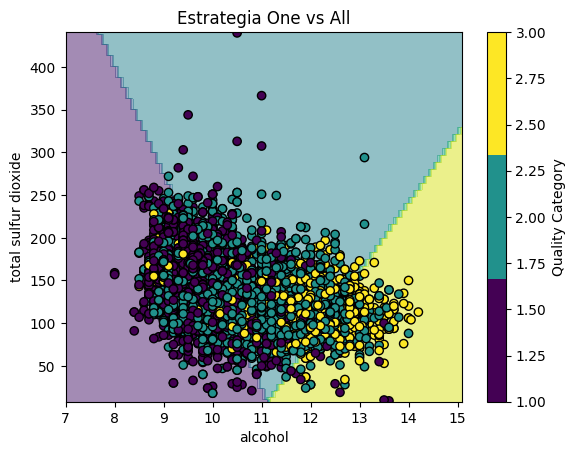

In [ ]:
svmClassification('alcohol','total sulfur dioxide','categoryNum',whiteWines, "ovr");

#####Conclusiones y observaciones
* Nuevamente las implementaciones que utilizan como base la estrategia de One v/s One presentan una precisión, recall y puntaje F1 del 0% en la tercera clasificante.
* Los resultados de cada modelo resultan ser bastante equilibrados, con la mayoría de precisiones de cada atributo siendo valores cercanos al 50%. Esto también se ve reflejado en las gráficas, especialmente aquellas pertenecientes a la estrategia One v/s All. Una razón para esto puede ser una buena distribución de los datos. Si bien ésta no es perfecta, el gráfico de puntos nos muestra posiciones claras para gran parte de los valores de cada categoría.
* En el caso de este atributo en específico, se obtienen mejores resultados al entrenar con K-Fold, donde OvO y OvA tienen una exactitud para clasificar de 49% y 53% respectivamente.

###Vinos tintos

####Atributo *alcohol*

#####Con K-Fold Cross Validation

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
/usr/local/lib/python3.10/dist-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but OneVsOneClassifier was fitted with feature names


              precision    recall  f1-score   support

           1       0.65      0.77      0.71       150
           2       0.46      0.54      0.50       122
           3       0.00      0.00      0.00        48

    accuracy                           0.57       320
   macro avg       0.37      0.44      0.40       320
weighted avg       0.48      0.57      0.52       320



<ipython-input-6-85caa080a0a2>:39: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.


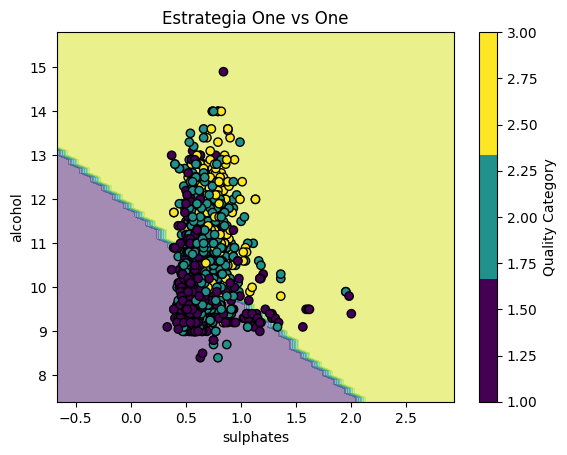

In [ ]:
svmClassification('sulphates','alcohol','categoryNum',redWines, "ovo", True);

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
/usr/local/lib/python3.10/dist-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but SVC was fitted with feature names
/usr/local/lib/python3.10/dist-packages/sklearn/base.py:439: UserWarning: X does

              precision    recall  f1-score   support

           1       0.57      0.94      0.71       142
           2       0.00      0.00      0.00       133
           3       0.34      0.67      0.45        45

    accuracy                           0.51       320
   macro avg       0.31      0.53      0.39       320
weighted avg       0.30      0.51      0.38       320



/usr/local/lib/python3.10/dist-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but SVC was fitted with feature names
<ipython-input-6-85caa080a0a2>:66: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.


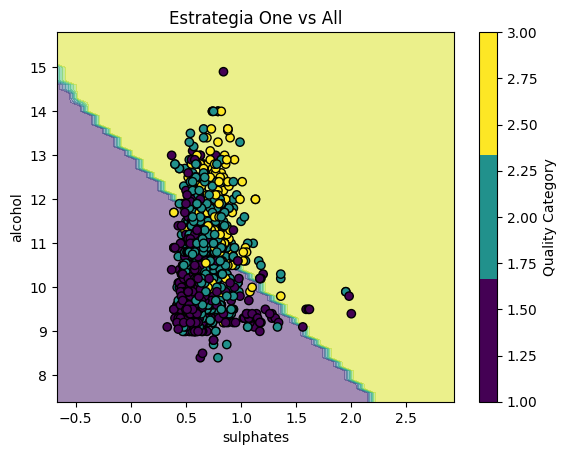

In [ ]:
svmClassification('sulphates','alcohol','categoryNum',redWines, "ovr", True);

#####Sin K-Fold Cross Validation

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
/usr/local/lib/python3.10/dist-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but OneVsOneClassifier was fitted with feature names


              precision    recall  f1-score   support

           1       0.71      0.82      0.76       160
           2       0.52      0.58      0.55       118
           3       0.00      0.00      0.00        42

    accuracy                           0.63       320
   macro avg       0.41      0.47      0.44       320
weighted avg       0.54      0.63      0.58       320



<ipython-input-6-85caa080a0a2>:39: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.


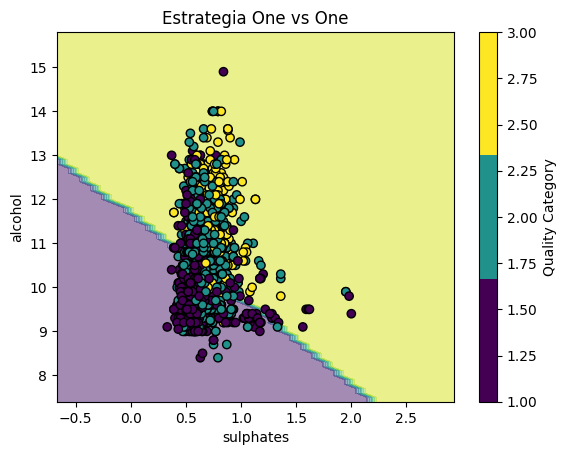

In [ ]:
svmClassification('sulphates','alcohol','categoryNum',redWines, "ovo");

              precision    recall  f1-score   support

           1       0.62      0.95      0.75       163
           2       0.43      0.26      0.32       113
           3       0.33      0.02      0.04        44

    accuracy                           0.58       320
   macro avg       0.46      0.41      0.37       320
weighted avg       0.51      0.58      0.50       320



/usr/local/lib/python3.10/dist-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but SVC was fitted with feature names
/usr/local/lib/python3.10/dist-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but SVC was fitted with feature names
/usr/local/lib/python3.10/dist-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but SVC was fitted with feature names
<ipython-input-6-85caa080a0a2>:66: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.


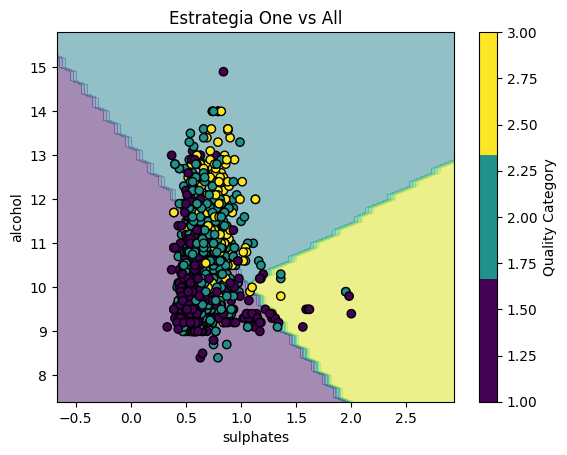

In [ ]:
svmClassification('sulphates','alcohol','categoryNum',redWines, "ovr");

#####Conclusiones y observaciones
* La estrategia One v/s One presenta el mismo problema observado anteriormente, y es que una de las categorías tiene un 0% de precisión, recall y F1-Score. No obstante, esto no solo sucedió con solo aquella estrategia, puesto que One v/s All del modelo con K-Fold también presenta este "problema", donde la categoría "Average" es la que no es correctamente clasificada, tal como se ve en el gráfico.
* La precisión de la categoría "LowQuality" es más alta en los modelos que no utilizan K-Fold, aunque en ambos casos presentan valores sobre el 55%, lo que si bien no es lo más óptimo, sí representa un rendimiento levemente mejor de lo normal.
* Los gráficos de los modelos con K-Fold implementado son muy similares. Esto es extraño, puesto que no había sucedido anteriormente, en especial si consideramos cómo se distribuyen los gráficos de One v/s All habitualmente. Si esto sucede se puede deber a la implementación de la técnica como tal, la cual puede estar afectando a la ejecución de la estrategia.
* Para este atributo notamos claramente que los mejores resultados los da las implementaciones que no consideran K-Fold, obteniendo mejor exactitud y precisión.

####Atributo *volatile acidity*

#####Con K-Fold Cross Validation

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
/usr/local/lib/python3.10/dist-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but OneVsOneClassifier was fitted with feature names


              precision    recall  f1-score   support

           1       0.64      0.78      0.70       147
           2       0.52      0.54      0.53       133
           3       0.00      0.00      0.00        40

    accuracy                           0.58       320
   macro avg       0.38      0.44      0.41       320
weighted avg       0.51      0.58      0.54       320



<ipython-input-6-85caa080a0a2>:39: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.


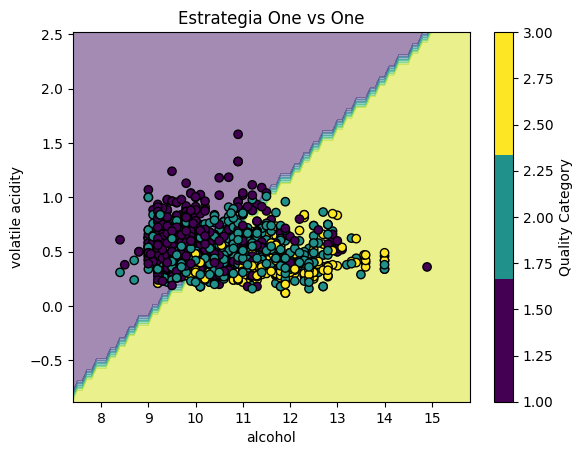

In [ ]:
svmClassification('alcohol','volatile acidity','categoryNum',redWines, "ovo", True);

              precision    recall  f1-score   support

           1       0.62      0.91      0.74       163
           2       0.50      0.30      0.37       125
           3       0.50      0.06      0.11        32

    accuracy                           0.59       320
   macro avg       0.54      0.42      0.41       320
weighted avg       0.56      0.59      0.53       320



/usr/local/lib/python3.10/dist-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but SVC was fitted with feature names
/usr/local/lib/python3.10/dist-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but SVC was fitted with feature names
/usr/local/lib/python3.10/dist-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but SVC was fitted with feature names
<ipython-input-6-85caa080a0a2>:66: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.


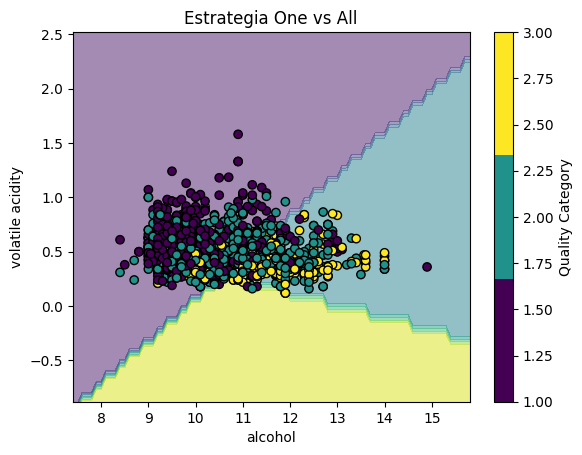

In [ ]:
svmClassification('alcohol','volatile acidity','categoryNum',redWines, "ovr", True);

#####Sin K-Fold Cross Validation

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
/usr/local/lib/python3.10/dist-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but OneVsOneClassifier was fitted with feature names


              precision    recall  f1-score   support

           1       0.69      0.82      0.75       149
           2       0.55      0.60      0.58       131
           3       0.00      0.00      0.00        40

    accuracy                           0.63       320
   macro avg       0.41      0.47      0.44       320
weighted avg       0.55      0.63      0.58       320



<ipython-input-6-85caa080a0a2>:39: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.


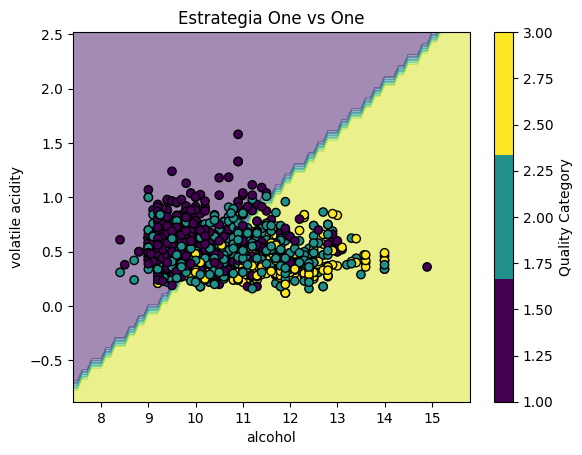

In [ ]:
svmClassification('alcohol','volatile acidity','categoryNum',redWines, "ovo");

              precision    recall  f1-score   support

           1       0.57      0.96      0.71       149
           2       0.00      0.00      0.00       136
           3       0.37      0.71      0.49        35

    accuracy                           0.53       320
   macro avg       0.31      0.56      0.40       320
weighted avg       0.31      0.53      0.39       320



/usr/local/lib/python3.10/dist-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but SVC was fitted with feature names
/usr/local/lib/python3.10/dist-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but SVC was fitted with feature names
/usr/local/lib/python3.10/dist-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but SVC was fitted with feature names
<ipython-input-6-85caa080a0a2>:66: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.


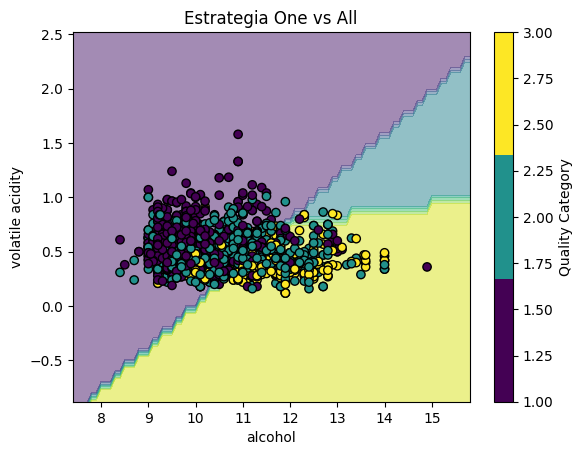

In [ ]:
svmClassification('alcohol','volatile acidity','categoryNum',redWines, "ovr");

#####Conclusiones y observaciones
* Siguiendo con la tendencia, observamos que la estrategia One v/s One no considera correctamente a la categoría "HighQuality".
* Además, nuevamente la estrategia One v/s All nos otorga un modelo cuya precisión es de 0%. Esto sucede en la implementación sin K-Fold, donde la categoría "Average" fue la afectada de no poder ser calificada casi en absoluto, ya que en el gráfico se observa como solo uno de los puntos logra ser calificado correctamente.
* Como es de esperar, la categoría "LowQuality" es la que, en la mayoría de casos, obtiene un mejor valor de precisión, puesto que es la que posee la mayor cantidad de valores presentes en el gráfico, aún con una división de por medio.
* En este atributo conseguimos que aquellos modelos con mejores resultados finalmente son los que consideran la utilización de la técnica de entrenamiento K-Fold Cross Validation, donde se obtienen exactitudes 58% y 59% para OvO y OvA respectivamente. Si bien podríamos decir que los que no utilizan K-Fold pueden llegar a ser mejores, como el 63% de exactitud del OvO, creemos que el tener dos resultados que se asemejen más entre sí nos entrega se espera más estabilidad.

####Atributo *sulphates*

#####Con K-Fold Cross Validation

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
/usr/local/lib/python3.10/dist-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but OneVsOneClassifier was fitted with feature names


              precision    recall  f1-score   support

           1       0.48      0.86      0.61       138
           2       0.43      0.22      0.29       140
           3       0.00      0.00      0.00        42

    accuracy                           0.47       320
   macro avg       0.30      0.36      0.30       320
weighted avg       0.39      0.47      0.39       320



<ipython-input-6-85caa080a0a2>:39: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.


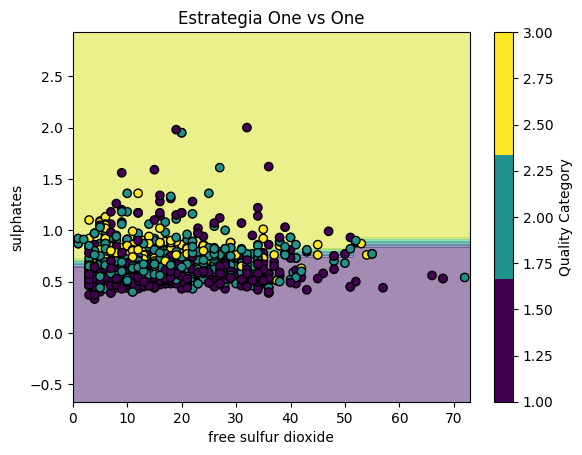

In [ ]:
svmClassification('free sulfur dioxide','sulphates','categoryNum',redWines, "ovo", True);

              precision    recall  f1-score   support

           1       0.46      0.89      0.61       145
           2       0.24      0.04      0.06       136
           3       0.05      0.03      0.03        39

    accuracy                           0.42       320
   macro avg       0.25      0.32      0.24       320
weighted avg       0.32      0.42      0.31       320



/usr/local/lib/python3.10/dist-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but SVC was fitted with feature names
/usr/local/lib/python3.10/dist-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but SVC was fitted with feature names
/usr/local/lib/python3.10/dist-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but SVC was fitted with feature names
<ipython-input-6-85caa080a0a2>:66: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.


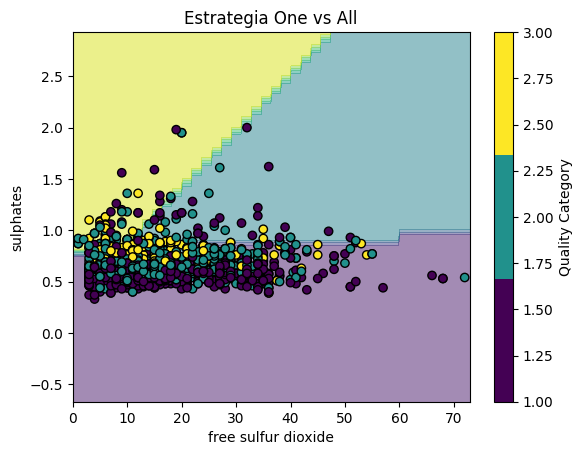

In [ ]:
svmClassification('free sulfur dioxide','sulphates','categoryNum',redWines, "ovr", True);

#####Sin K-Fold Cross Validation

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
/usr/local/lib/python3.10/dist-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but OneVsOneClassifier was fitted with feature names


              precision    recall  f1-score   support

           1       0.48      0.83      0.61       145
           2       0.46      0.24      0.31       135
           3       0.00      0.00      0.00        40

    accuracy                           0.48       320
   macro avg       0.32      0.36      0.31       320
weighted avg       0.41      0.48      0.41       320



<ipython-input-6-85caa080a0a2>:39: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.


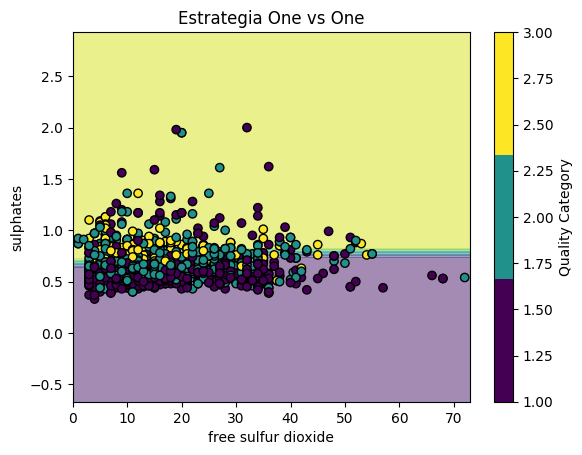

In [ ]:
svmClassification('free sulfur dioxide','sulphates','categoryNum',redWines, "ovo");

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
/usr/local/lib/python3.10/dist-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but SVC was fitted with feature names


              precision    recall  f1-score   support

           1       0.46      0.89      0.61       141
           2       0.33      0.12      0.17       126
           3       0.00      0.00      0.00        53

    accuracy                           0.44       320
   macro avg       0.26      0.34      0.26       320
weighted avg       0.33      0.44      0.34       320



/usr/local/lib/python3.10/dist-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but SVC was fitted with feature names
/usr/local/lib/python3.10/dist-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but SVC was fitted with feature names
<ipython-input-6-85caa080a0a2>:66: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.


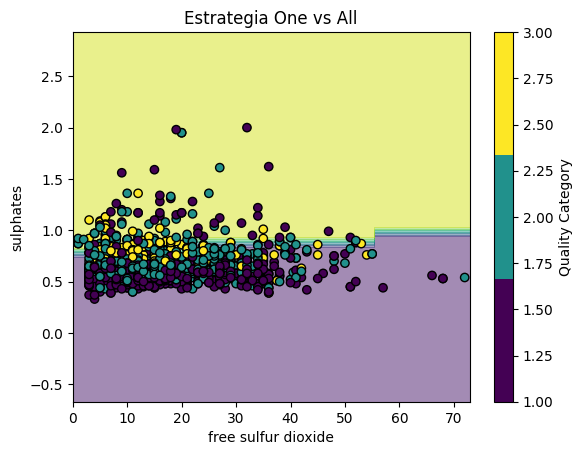

In [ ]:
svmClassification('free sulfur dioxide','sulphates','categoryNum',redWines, "ovr");

#####Conclusiones y observaciones
* Finalmente, obtenemos nuevamente que la estrategia One v/s One no es capaz de identificar y clasificar correctamente la tercera categoría ("HighQuality"), otorgándole valores iguales a 0% en sus métricas.
* Las medidas de precisión de cada categoría no son tan altas, llegando por poco al 50%, valor no muy óptimo. Esto se nota en los gráficos adjuntos para cada modelo, donde en la mayoría tan solo se puede formar una línea para clasificar la categoría de "Average", por ejemplo. Esto se ve más notoriamente con el modelo SVM sin K-Fold OvA ("HighQuality" con un 0%) y el modelo OvA con K-Fold ("HighQuality" con tan solo un 5% de precisión).
* Los mejores resultados para la clasificación con este atributo se observan en aquellos modelos que no consideran K-Fold para su entrenamiento (exactitud de 48% y 44%).

###Conclusiones
Por lo tanto, luego de analizar arduamente cada resultado, observamos que, en la mayoría de casos, un SVM que no considera la técnica de K-Fold Cross Validation es mejor para clasificar, entregándonos resultados un tanto más exactos para los modelos que lo utilizaban. Cabe recalcar que esto no sucedía con todos los atributos que fueron seleccionados. Además, los códigos que sí utilizaban esta técnica poseen un mayor tiempo de ejecución, lo cual significa otro contra para la utilización de K-Fold.

Por otro lado, en ambos datasets se observa una tendencia donde la clasificación posee una exactitud cercana al 50%, lo cual se hacía más evidente comparando nuestros resultados con los gráficos adjuntos.

Finalmente, concluimos que la estrategia One v/s One no es recomendable a la hora de realizar una clasificación a base de SVM en ambos datasets. Esto se puede deber a un desequilibrio de las clases utilizadas, como lo vimos durante el EDA, además del rendimiento del modelo como tal, que ya vimos no siempre era el más óptimo. Otro factor importante es la cantidad de datos como tal, ya que, como se vió con los vinos tintos, el entrenamiento se realizaba con una cantidad disminuida de datos, por lo que unos resultados óptimos en este caso no se veían como una opción.

##2. Decision Tree

###Funciones

In [ ]:
def ArbolDeDecision(var1,var2,var3,dataTable,booleano=False):
  #var1: Variable X
  #var2: Variable Y
  #var3: Variable Clasificadora
  #dataTAble: el Data frame de los vinos
  #booleano: si es TRUE se clasifica con kfold si es False no lo hace (por defecto esta en FAlSE)

  #obtenemos los datos
  x = dataTable[[var2,var1]]
  y = dataTable[var3]

  #separamos las variables de entrenamiento y testing
  xTrain,xTest,yTrain,yTest = train_test_split(x,y,test_size=0.2,random_state=42)

  #creamos clasificador de arbol
  tree = DecisionTreeClassifier(max_depth=3)

  if(booleano):
    #Cramos el kfold
    print("ARBOL CON KFOLD")
    kfold = KFold(n_splits=5,shuffle=True,random_state=42)
    scores = cross_val_score(tree,xTrain,yTrain,cv=kfold)

  #se entrena el modelo
  tree.fit(xTrain,yTrain)

  #realisamos las predicciones
  yPred = tree.predict(xTest)

  #evaluamos el modelo
  print(classification_report(yTest,yPred))

  table=[var1,var2]
  fig=plt.figure(figsize=(13,7))
  plot_tree(tree,
            feature_names=table,
            filled=True, impurity=True,
            rounded=True,fontsize=7.5)


###Vinos blancos

####Atributo *alcohol*

#####Con K-Fold Cross Validation

ARBOL CON KFOLD
              precision    recall  f1-score   support

           1       0.55      0.53      0.54       321
           2       0.49      0.56      0.53       432
           3       0.54      0.42      0.48       227

    accuracy                           0.52       980
   macro avg       0.53      0.51      0.51       980
weighted avg       0.52      0.52      0.52       980



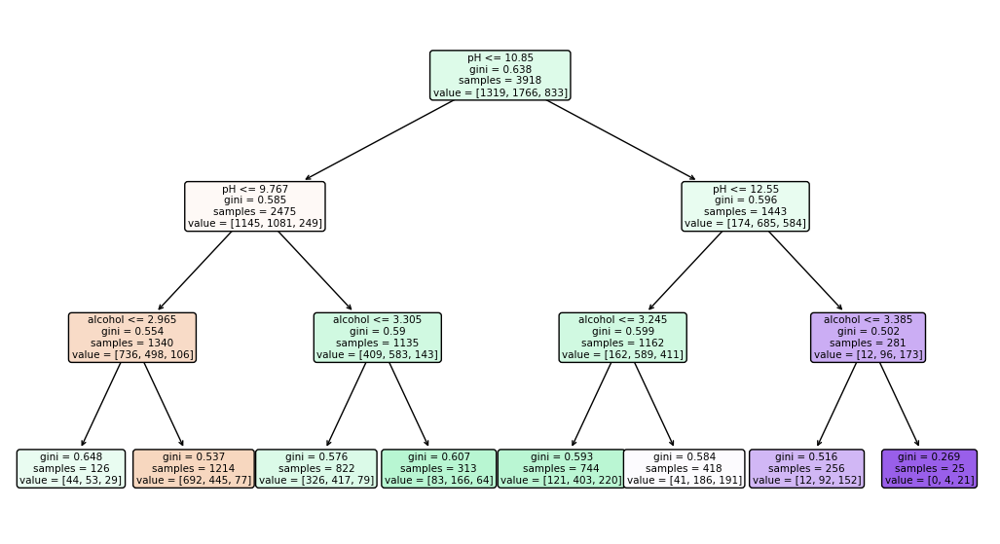

In [ ]:
ArbolDeDecision("pH","alcohol","categoryNum",whiteWines,True)

#####Sin K-Fold Cross Validation

              precision    recall  f1-score   support

           1       0.55      0.53      0.54       321
           2       0.49      0.56      0.53       432
           3       0.54      0.42      0.48       227

    accuracy                           0.52       980
   macro avg       0.53      0.51      0.51       980
weighted avg       0.52      0.52      0.52       980



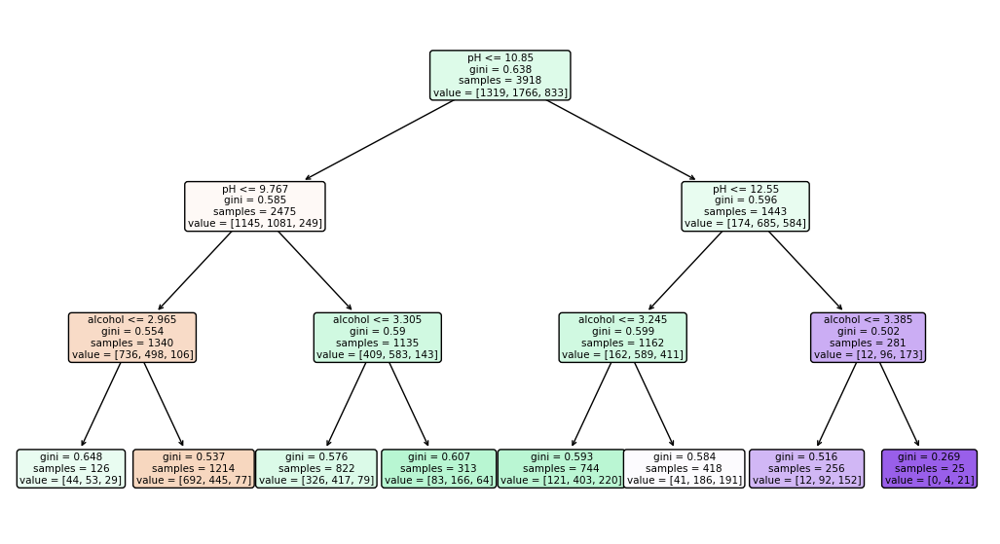

In [ ]:
ArbolDeDecision("pH","alcohol","categoryNum",whiteWines)

#####Conclusiones y observaciones
En el caso de este atributo, podemos observar que en este caso el árbol de decisión con o sin K-Fold tienen resultados iguales. Además de eso, la precisión de las categorias son similares o parecidas, y su accuracy es de 0.52 lo cual hace un modelo no muy preciso.

####Atributo *density*

#####Con K-Fold Cross Validation

ARBOL CON KFOLD
              precision    recall  f1-score   support

           1       0.50      0.61      0.55       321
           2       0.49      0.52      0.51       432
           3       0.51      0.30      0.38       227

    accuracy                           0.50       980
   macro avg       0.50      0.48      0.48       980
weighted avg       0.50      0.50      0.49       980



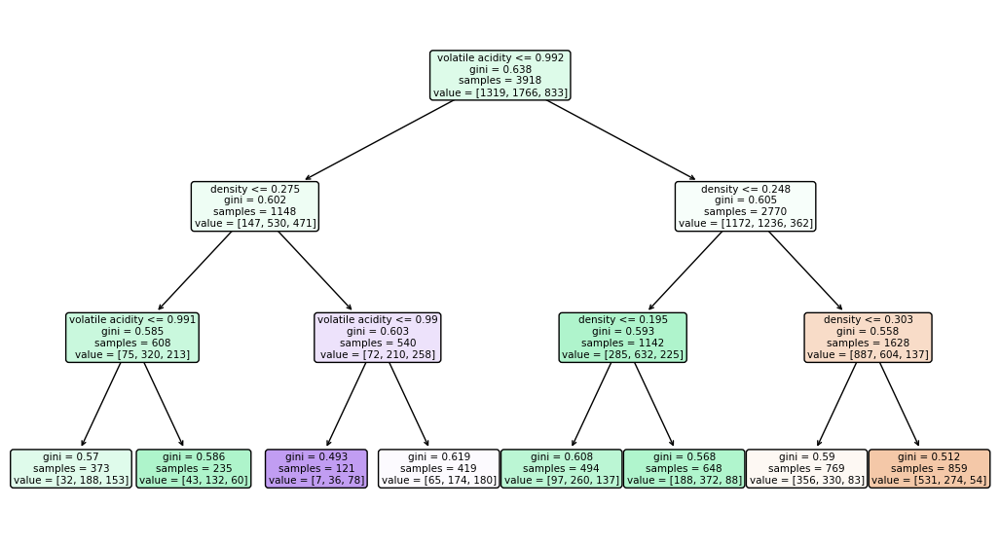

In [ ]:
ArbolDeDecision("volatile acidity","density","categoryNum",whiteWines,True)

#####Sin K-Fold Cross Validation

              precision    recall  f1-score   support

           1       0.50      0.61      0.55       321
           2       0.49      0.52      0.51       432
           3       0.51      0.30      0.38       227

    accuracy                           0.50       980
   macro avg       0.50      0.48      0.48       980
weighted avg       0.50      0.50      0.49       980



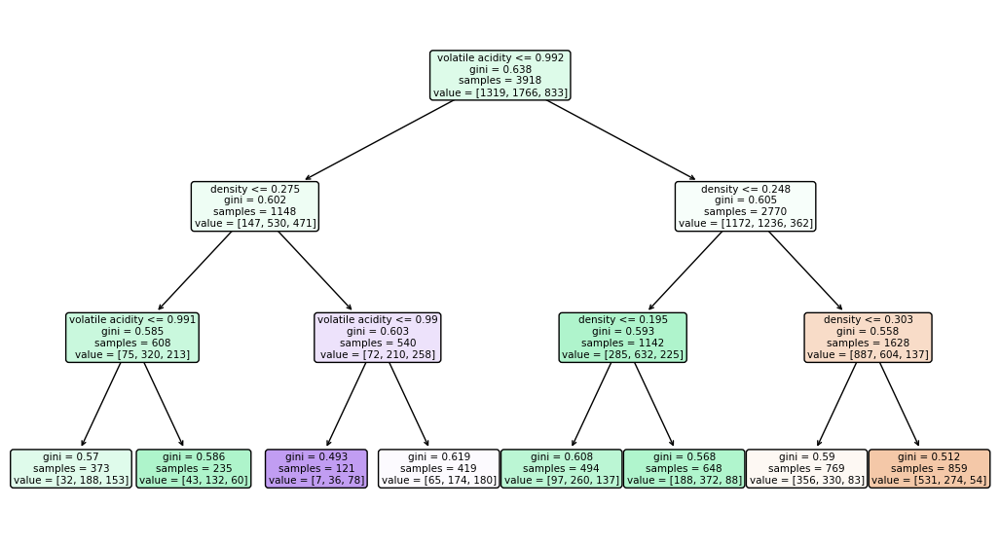

In [ ]:
ArbolDeDecision("volatile acidity","density","categoryNum",whiteWines)

#####Conclusiones y observaciones
Nuevamente los árboles de decisión tanto con K-Fold como sin K-Fold llegaron a resultados iguales en sus parámetros. La precisión de las categorías son muy iguales y su accuracy de 0.50 lo vuelve de momento el peor de los modelos para este dataset.

####Atributo *total sulfure dioxide*

#####Con K-Fold Cross Validation

ARBOL CON KFOLD
              precision    recall  f1-score   support

           1       0.57      0.50      0.53       321
           2       0.48      0.70      0.57       432
           3       0.67      0.21      0.32       227

    accuracy                           0.52       980
   macro avg       0.57      0.47      0.48       980
weighted avg       0.55      0.52      0.50       980



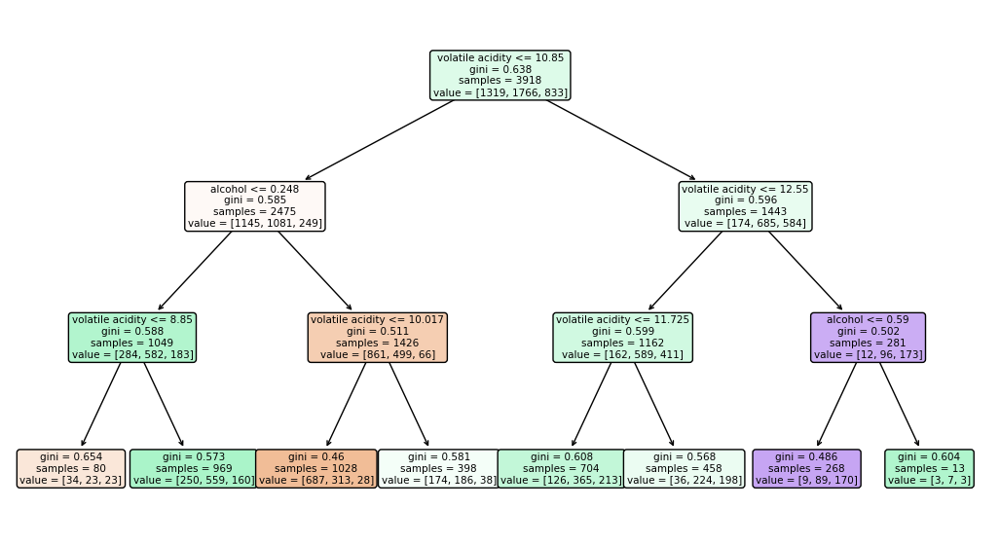

In [ ]:
ArbolDeDecision("alcohol","volatile acidity","categoryNum",whiteWines,True)

#####Sin K-Fold Cross Validation

              precision    recall  f1-score   support

           1       0.57      0.50      0.53       321
           2       0.48      0.70      0.57       432
           3       0.67      0.21      0.32       227

    accuracy                           0.52       980
   macro avg       0.57      0.47      0.48       980
weighted avg       0.55      0.52      0.50       980



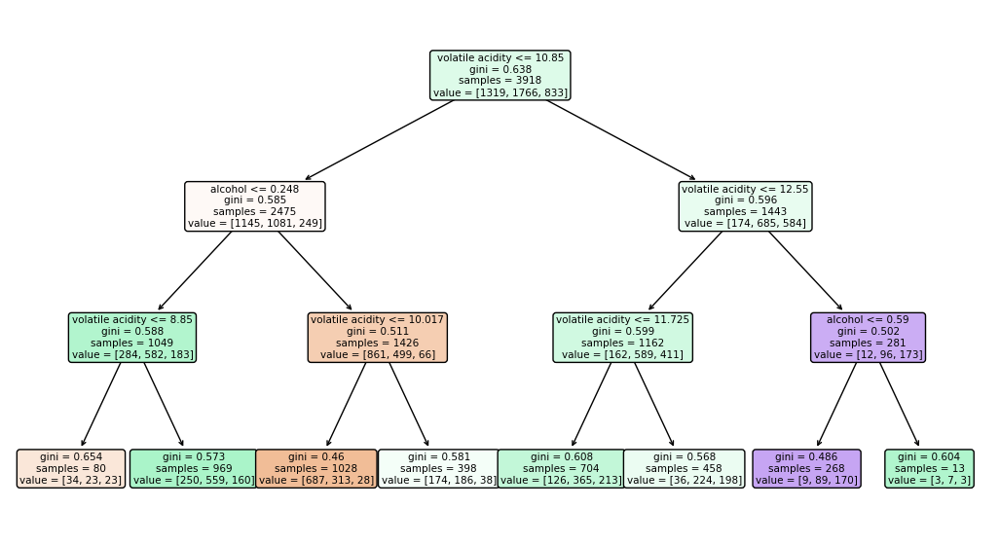

In [ ]:
ArbolDeDecision("alcohol","volatile acidity","categoryNum",whiteWines)

#####Conclusiones y observaciones
Ahora, por último, nuevamente el árbol de decisión no varía sus resultados con o sin K-Fold, sin embargo si vemos su precisión en la clasificación de la categoría 3 ("HighQuality") es casi decente siendo de 0.67, mientras que las categorias 1 y 2 tienen una precisión de 0.57 y 0.48 respectivamente, por lo que lo hace, de momento, el "mejor" modelo para los vinos blancos.

####Conclusión de los resultados

En el caso del dataset de vinos blancos, los arboles de decisión no cambiaron sus resultados, pero si comparamos los tres atributos **alcohol**, **density** y **total sulfur dioxide**, aquellos que tenían mejor exactitud a la hora de clasificar son **alcohol** y **total sulfur dioxide**, ambas con un accuracy de 0.52. Ahora si comparamos estos dos podemos ver que la precisión de las clasificaciones son mejor en **total sulfur dioxide**, a pesar de eso si bien es la mejor para este data set no se podría considerar como un buen modelo ya que tendería a equivocarse muy seguido.

Un detalle importante es que, observando los reportes de clasificación, no importaba el uso de K-Fold, puesto que como se mencionó anteriormente los resultados no variaron.

###Vinos tintos

####Atributo *alcohol*

#####Con K-Fold Cross Validation

ARBOL CON KFOLD
              precision    recall  f1-score   support

           1       0.64      0.78      0.70       141
           2       0.51      0.48      0.49       132
           3       0.58      0.30      0.39        47

    accuracy                           0.58       320
   macro avg       0.58      0.52      0.53       320
weighted avg       0.58      0.58      0.57       320



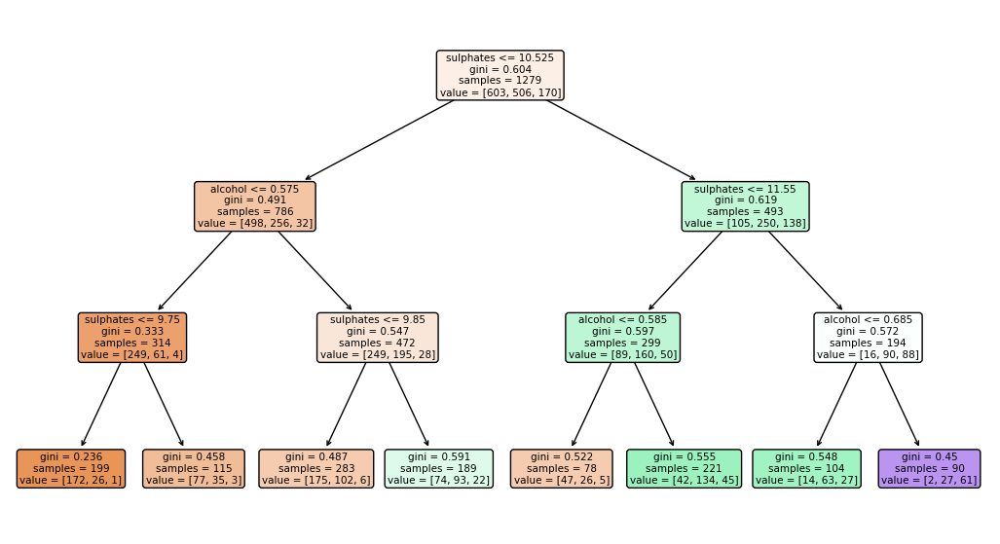

In [ ]:
ArbolDeDecision("sulphates","alcohol","categoryNum",redWines,True)

#####Sin K-Fold Cross Validation

              precision    recall  f1-score   support

           1       0.64      0.78      0.70       141
           2       0.51      0.48      0.49       132
           3       0.58      0.30      0.39        47

    accuracy                           0.58       320
   macro avg       0.58      0.52      0.53       320
weighted avg       0.58      0.58      0.57       320



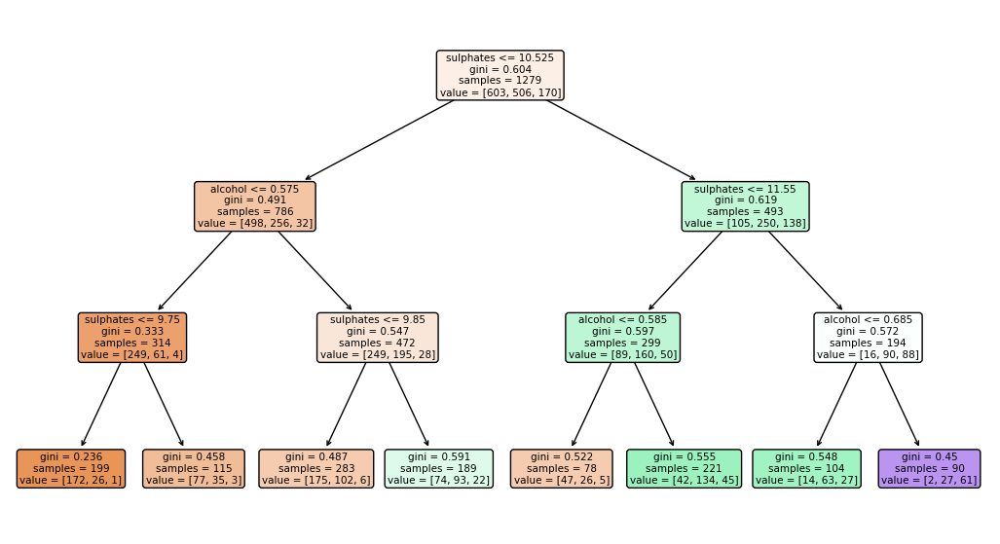

In [ ]:
ArbolDeDecision("sulphates","alcohol","categoryNum",redWines)

#####Conclusiones y observaciones
Como podemos ver con este atributo, el decision tree da los mismos resultados con o sin K-Fold. Vemos que puede predecir casi decentemente la categoria 1 con una precisión de 0.64, mientras que las clases 2 y 3 tienen una presision de 0.51 y 0.58, lo cuales son resultados medianamtente buenos, además de tener un accuracy de 0.58.

####Atributo *volatile acidity*

#####Con K-Fold Cross Validation

ARBOL CON KFOLD
              precision    recall  f1-score   support

           1       0.65      0.72      0.68       141
           2       0.47      0.48      0.48       132
           3       0.41      0.28      0.33        47

    accuracy                           0.55       320
   macro avg       0.51      0.49      0.50       320
weighted avg       0.54      0.55      0.55       320



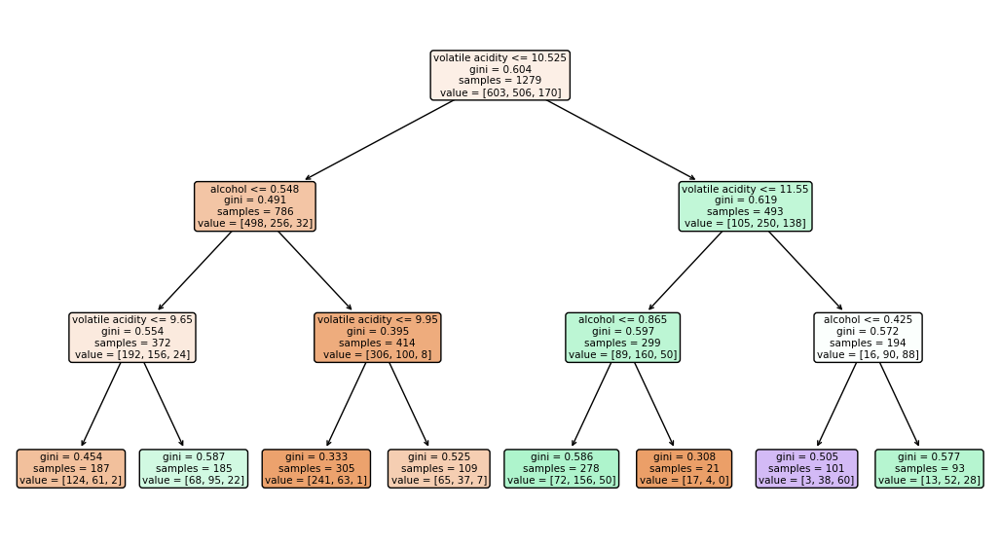

In [ ]:
ArbolDeDecision("alcohol","volatile acidity","categoryNum",redWines,True)

#####Sin K-Fold Cross Validation

              precision    recall  f1-score   support

           1       0.65      0.72      0.68       141
           2       0.47      0.48      0.48       132
           3       0.41      0.28      0.33        47

    accuracy                           0.55       320
   macro avg       0.51      0.49      0.50       320
weighted avg       0.54      0.55      0.55       320



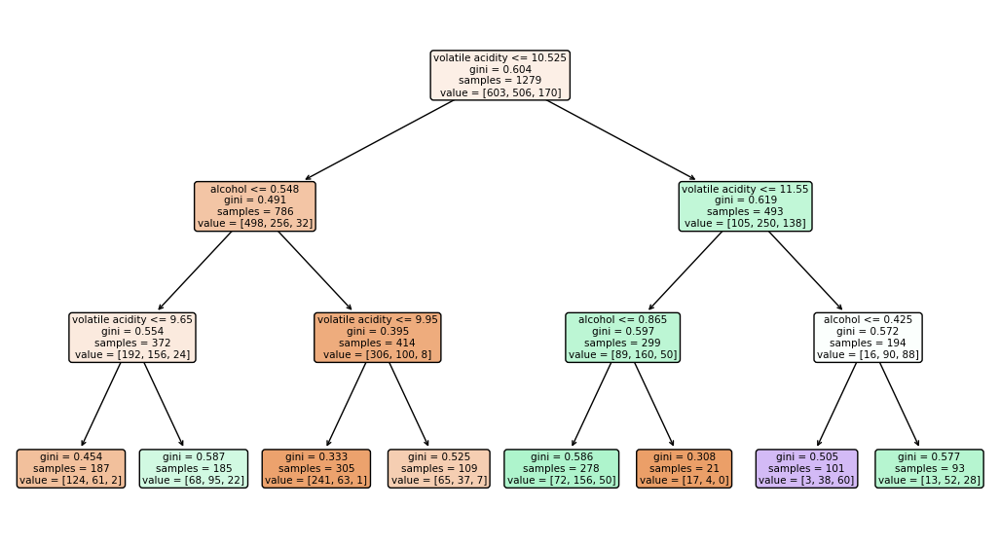

In [ ]:
ArbolDeDecision("alcohol","volatile acidity","categoryNum",redWines)

#####Conclusiones y observaciones
Nuevamente el árbol de decisión no se ve afectado por el uso de la técnica K-Fold, por lo cual veremos sus datos de manera general. El modelo, si bien predice decentemente la categoría 1, esto no ocurre con la clase 2 y 3 que tienen una precisión de 0.47 y 0.41, por lo cual el modelo no podría entregar muy buenos resultados generalmente.

####Atributo *sulphates*

#####Con K-Fold Cross Validation

ARBOL CON KFOLD
              precision    recall  f1-score   support

           1       0.56      0.74      0.64       141
           2       0.45      0.45      0.45       132
           3       0.00      0.00      0.00        47

    accuracy                           0.52       320
   macro avg       0.34      0.40      0.36       320
weighted avg       0.43      0.52      0.47       320



/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.


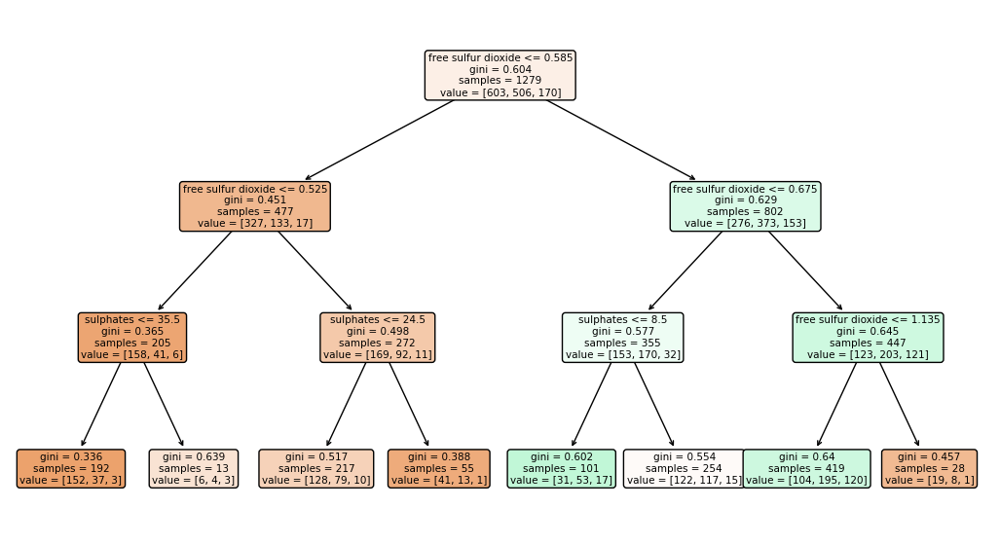

In [ ]:
ArbolDeDecision("free sulfur dioxide","sulphates","categoryNum",redWines,True)

#####Sin K-Fold Cross Validation

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.


              precision    recall  f1-score   support

           1       0.56      0.74      0.64       141
           2       0.45      0.45      0.45       132
           3       0.00      0.00      0.00        47

    accuracy                           0.52       320
   macro avg       0.34      0.40      0.36       320
weighted avg       0.43      0.52      0.47       320



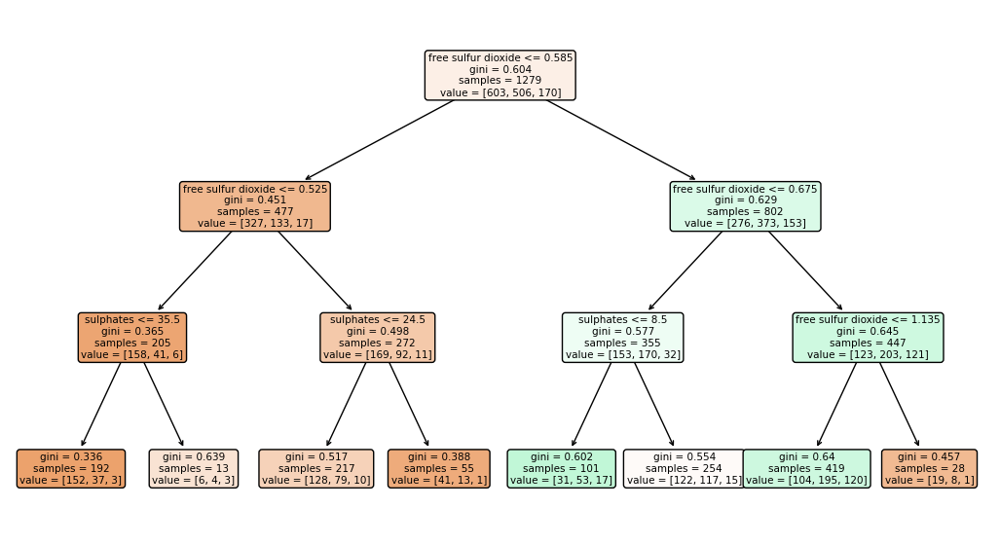

In [ ]:
ArbolDeDecision("free sulfur dioxide","sulphates","categoryNum",redWines)

#####Conclusiones y observaciones
Por último el decisionTree nuevamente es igual con o sin kfold. Analizando las tablas de ambos, las cuales inesperadamente son iguales, podemos apreciar que la categoría 3 el modelo no logra clasificarlo, lo que en general afecta su exactitud de 0.52. Esta inhabilidad para clasificar la categoría "HighQuality" se puede deber a que los datos están muy desequilibrados, lo cual se observa en la baja cantidad de vectores con los que trabaja la categoría afectada.

####Conclusión de los resultados
Comparando los 3 atributos **alcohol**, **volatile acidity** y **sulphates**, como en el anterior data set, los datos son iguales tanto con o sin kfold, por lo que podríamos llegar a la conclusión de que el uso de esta técnica de entrenamiento al momento de utilizar árboles de decisión no afecta su rendimiento debido a la naturaleza de éste. Al comparar la precisión y el accuracy, podemos ver que el mejor para este data set es alcohol ya que posee una exactitud de 0.58 y logra clasificar los datos decentemente, aun así el modelo podria tener errores en calcular varios datos.

##3. Random Forest

###Funciones

In [ ]:
from sklearn.tree import plot_tree

def RandomForest(var1,var2,var3,dataTable,booleano=False):
  #var1: Variable X
  #var2: Variable Y
  #var3: Variable Clasificadora
  #dataTAble: el Data frame de los vinos
  #booleano: si es TRUE se clasifica con kfold si es False no lo hace (por defecto esta en FAlSE)

  #obtenemos los datos
  x = dataTable[[var1,var2]]
  y = dataTable[var3]

  #separamos las varibales para entrenamiento y testing
  xTrain,xTest,yTrain,yTest = train_test_split(x,y,test_size=0.2,random_state=42)

  #generamos el clasificador Random Forest
  #Generaremos 4 arboles con una profundidad maxima de 3
  #Para facilitarnos la lectura del grafico
  randTree = RandomForestClassifier(n_estimators=4,max_depth=3)

  if(booleano):
    #Generamos el Kfold
    print("ARBOL CON KFOLD")
    kfold = KFold(n_splits=5,shuffle=True,random_state=42)
    scores = cross_val_score(randTree,xTrain,yTrain,cv=kfold)

  #se entrena el modelo
  randTree.fit(xTrain,yTrain)

  #realisamos las predicciones
  yPred = randTree.predict(xTest)

  #Variables que estan siendo clasificadas
  table=[var1,var2]
  #Clasificador
  table2=['1','2','3']

  #evaluamos el modelo
  print(classification_report(yTest,yPred),"\n")

  #Mostraremos los arboles generados
  for i in range(4):
      fig=plt.figure(figsize=(15,10))
      plot_tree(randTree.estimators_[i],
            feature_names=table,
            class_names=table2,
            filled=True, impurity=True,
            rounded=True)

###Vinos blancos

####Atributo *alcohol*

#####Con K-Fold Cross Validation

ARBOL CON KFOLD
              precision    recall  f1-score   support

           1       0.58      0.55      0.57       321
           2       0.49      0.64      0.55       432
           3       0.60      0.27      0.37       227

    accuracy                           0.53       980
   macro avg       0.55      0.49      0.50       980
weighted avg       0.54      0.53      0.52       980
 



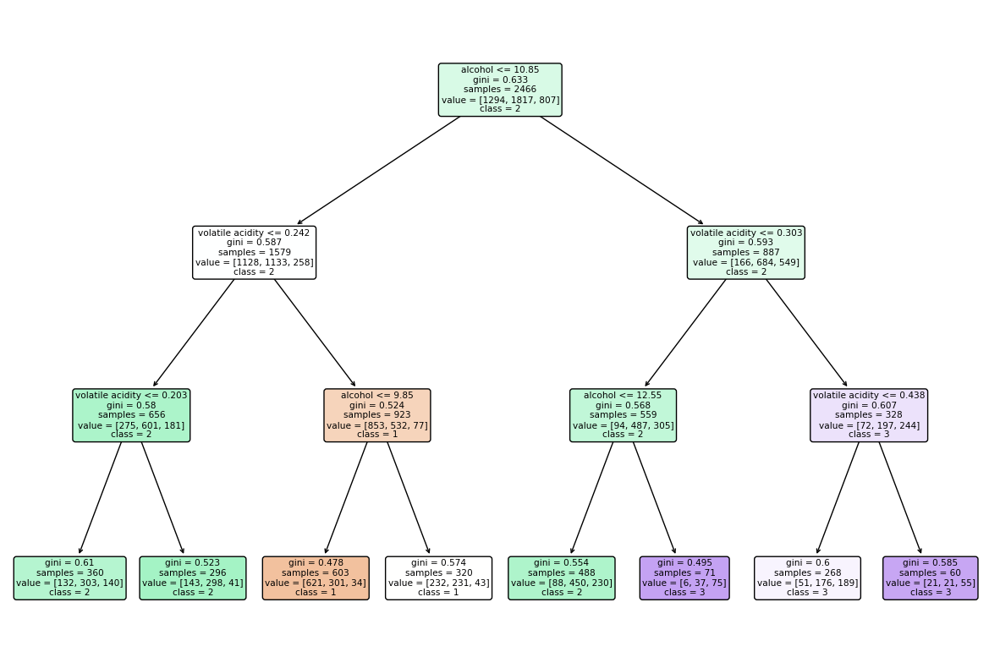

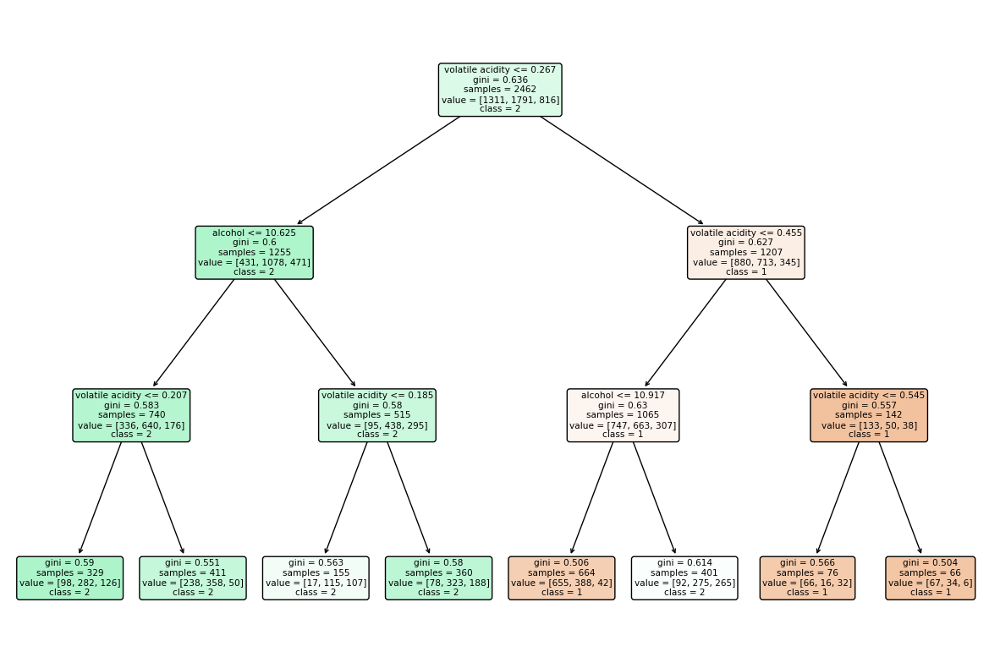

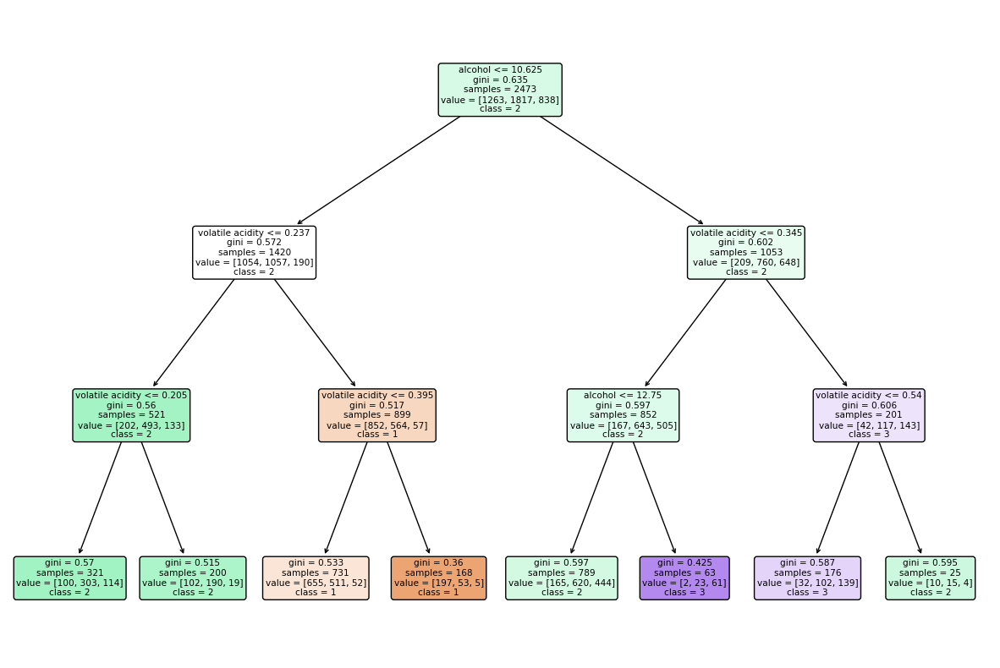

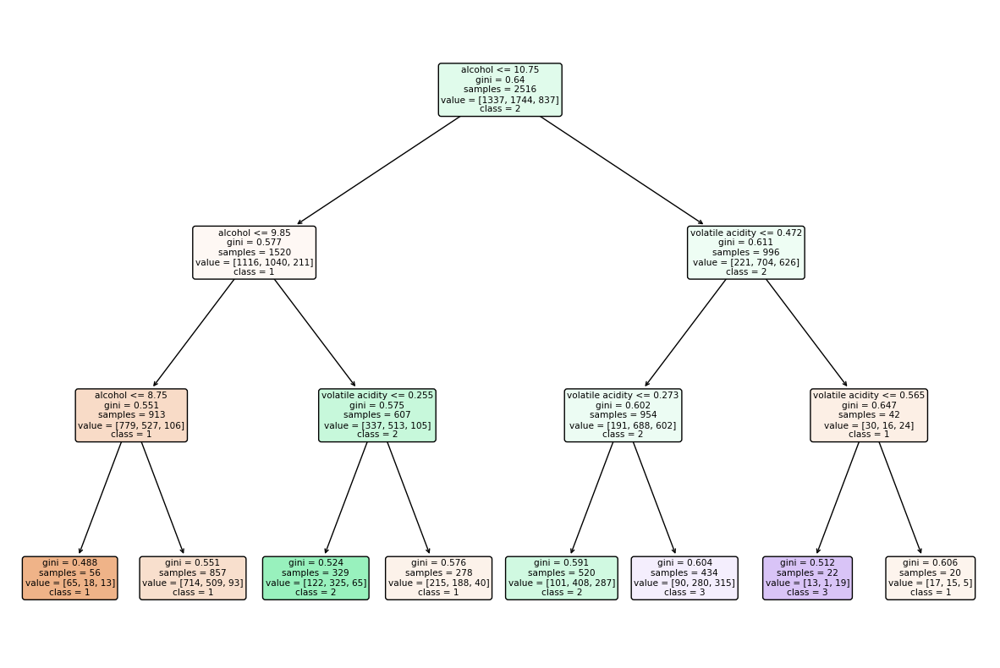

In [ ]:
RandomForest('volatile acidity','alcohol','categoryNum',whiteWines,True)

#####Sin K-Fold Cross Validation

              precision    recall  f1-score   support

           1       0.59      0.54      0.57       321
           2       0.47      0.72      0.57       432
           3       0.50      0.05      0.09       227

    accuracy                           0.51       980
   macro avg       0.52      0.44      0.41       980
weighted avg       0.52      0.51      0.46       980
 



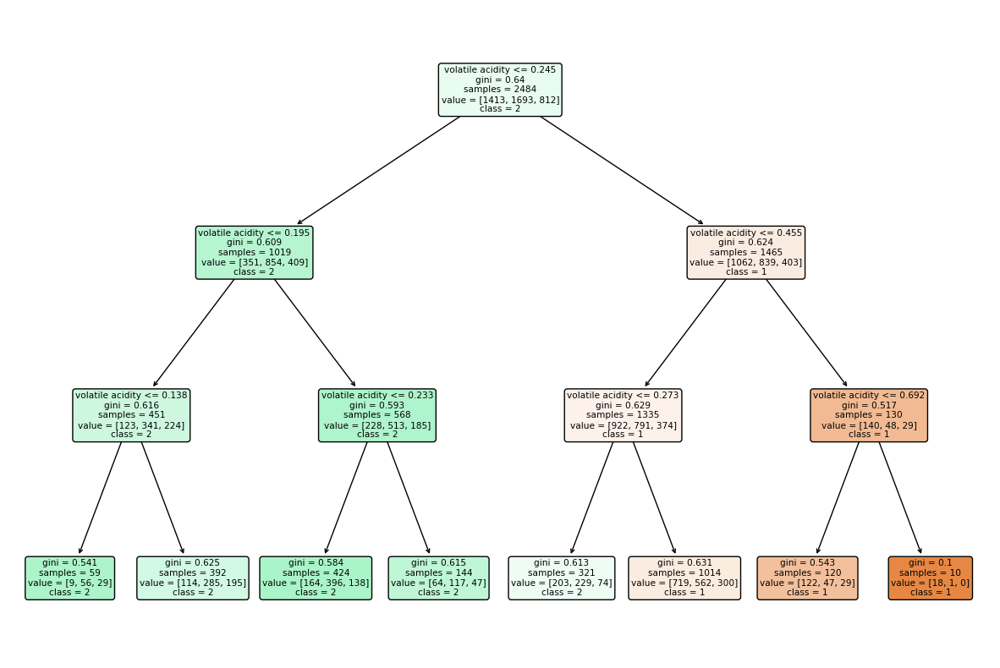

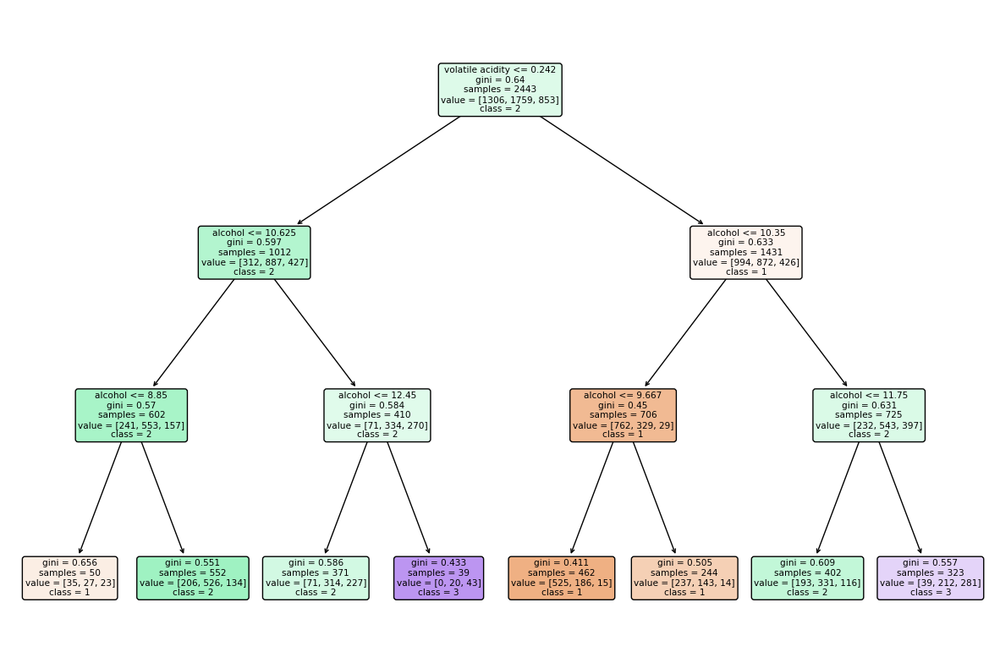

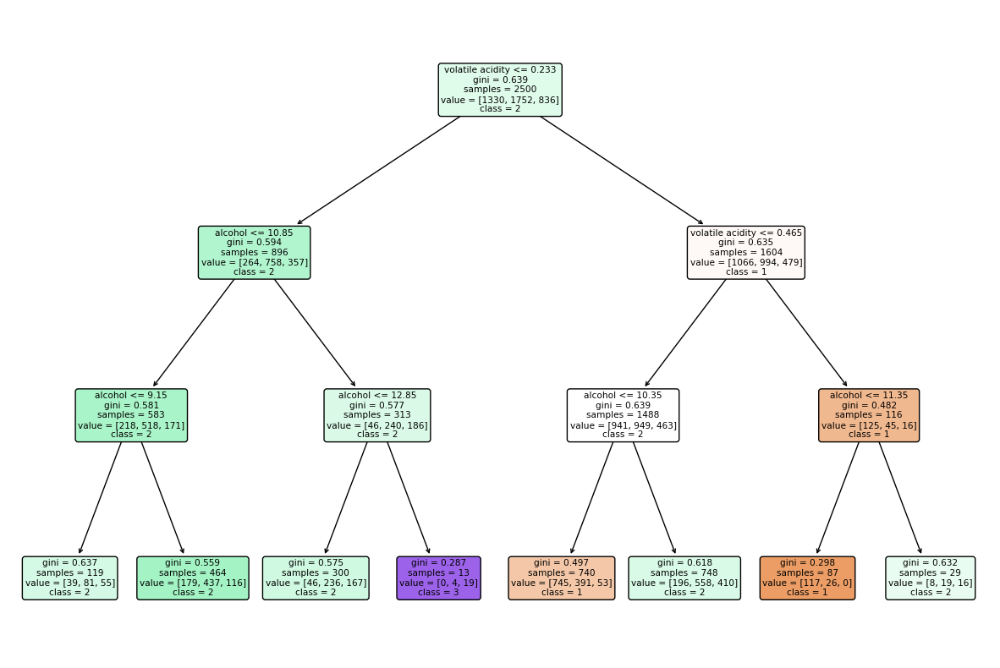

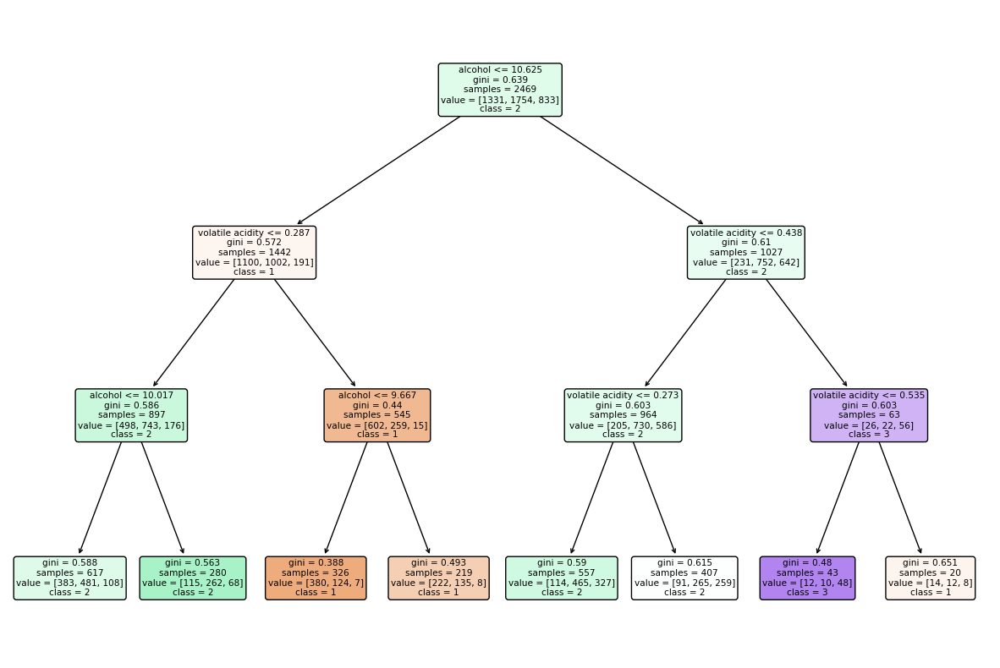

In [ ]:
RandomForest('volatile acidity','alcohol','categoryNum',whiteWines)

##### Conclusiones y observaciones

+ EL randomForest con kfold presenta mejores valores en el reporte de clasificación que el random forest sin kfold especialmente en los valores de la clase 3 (el clasificador) donde en recall con kfold se obtiene 0.27 mientras que sin kfold se obtiene un 0.05 significando que con kfold se obtiene una mayor cantidad de verdaderos positivos que falsos negativos mientras que sin kfold se obtiene una mayor cantidad de falsos negativos.

+ El randomforest sin kfold se puede ver una mejor homogeneidad con respecto al randomforest con kfold, obteniendo valores gui mas bajos en comparacion lo que implica que el randomforest sin kfold genera los subconjuntos de datos mas homogenea que el randomforest con kfold

####Atributo *density*

#####Con K-Fold Cross Validation

ARBOL CON KFOLD
              precision    recall  f1-score   support

           1       0.53      0.51      0.52       321
           2       0.50      0.61      0.55       432
           3       0.51      0.31      0.39       227

    accuracy                           0.51       980
   macro avg       0.51      0.48      0.49       980
weighted avg       0.51      0.51      0.50       980
 



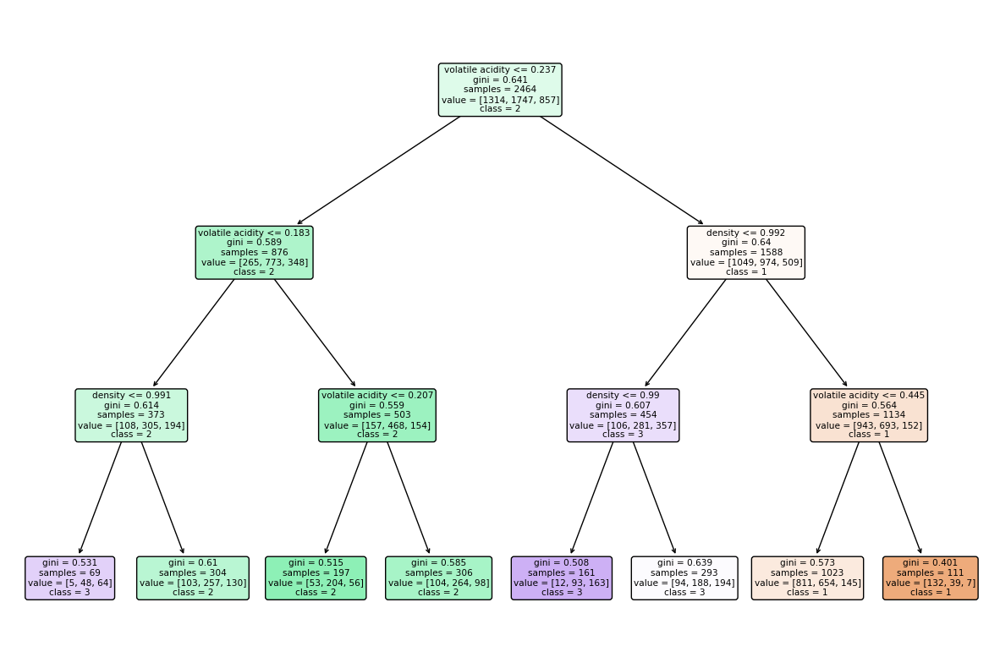

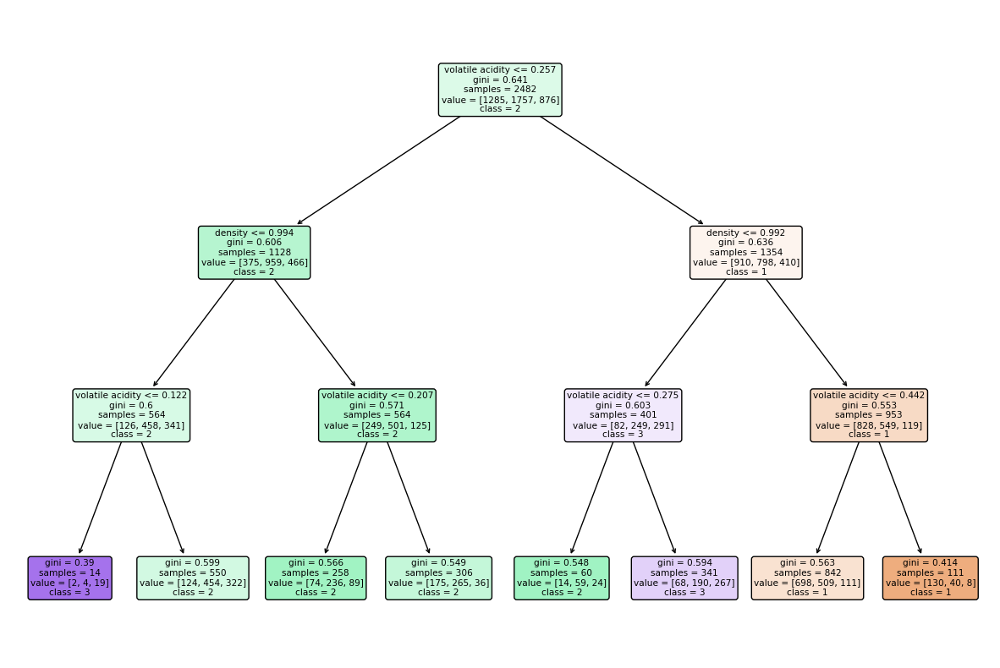

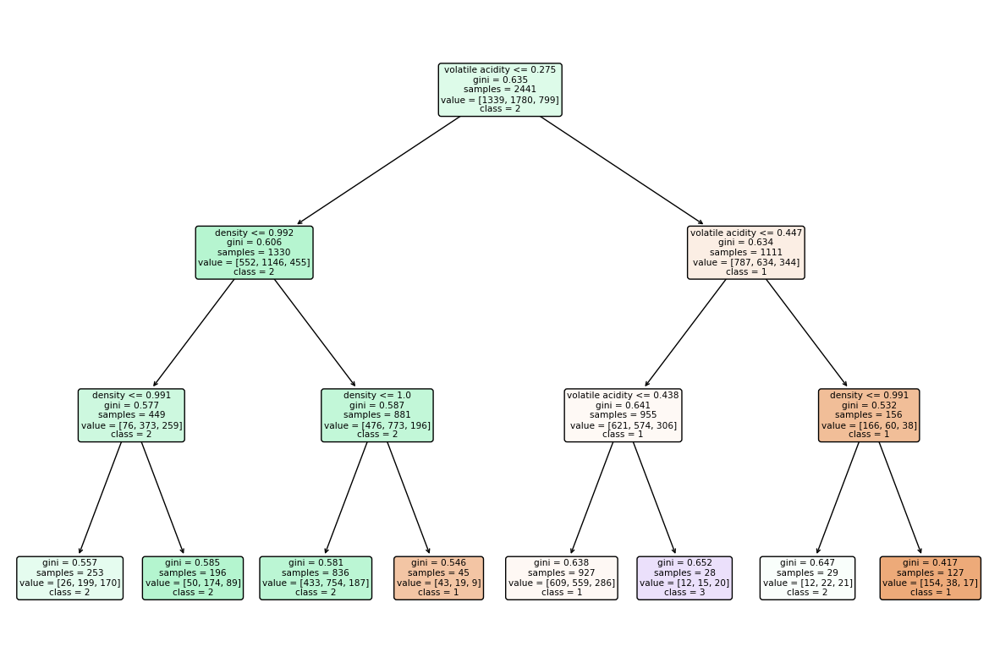

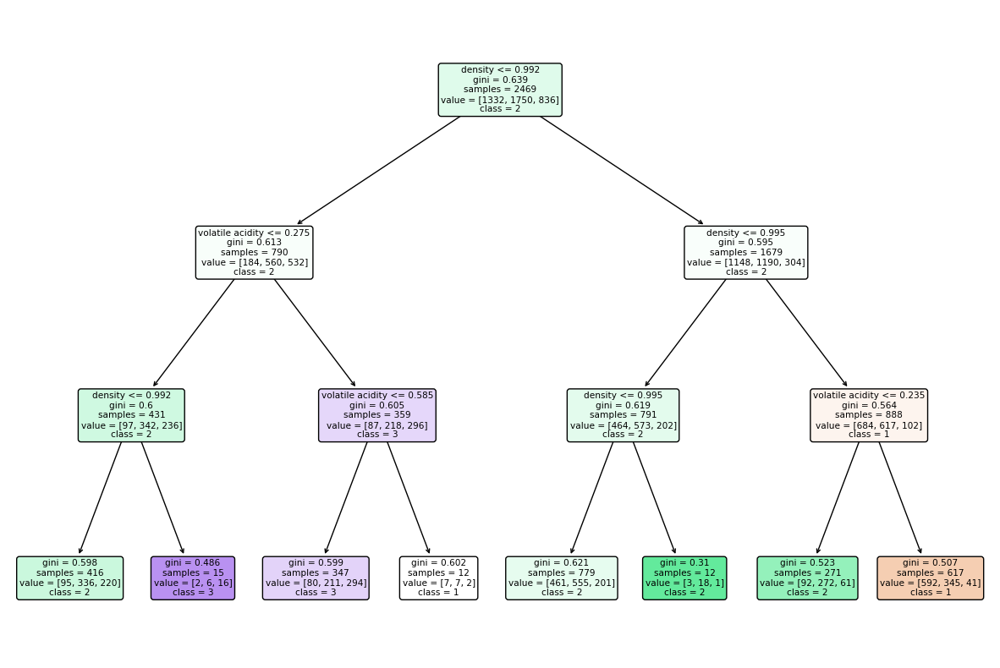

In [ ]:
RandomForest('volatile acidity','density','categoryNum',whiteWines,True)

#####Sin K-Fold Cross Validation

              precision    recall  f1-score   support

           1       0.54      0.50      0.51       321
           2       0.48      0.70      0.57       432
           3       0.61      0.13      0.22       227

    accuracy                           0.50       980
   macro avg       0.54      0.44      0.43       980
weighted avg       0.53      0.50      0.47       980
 



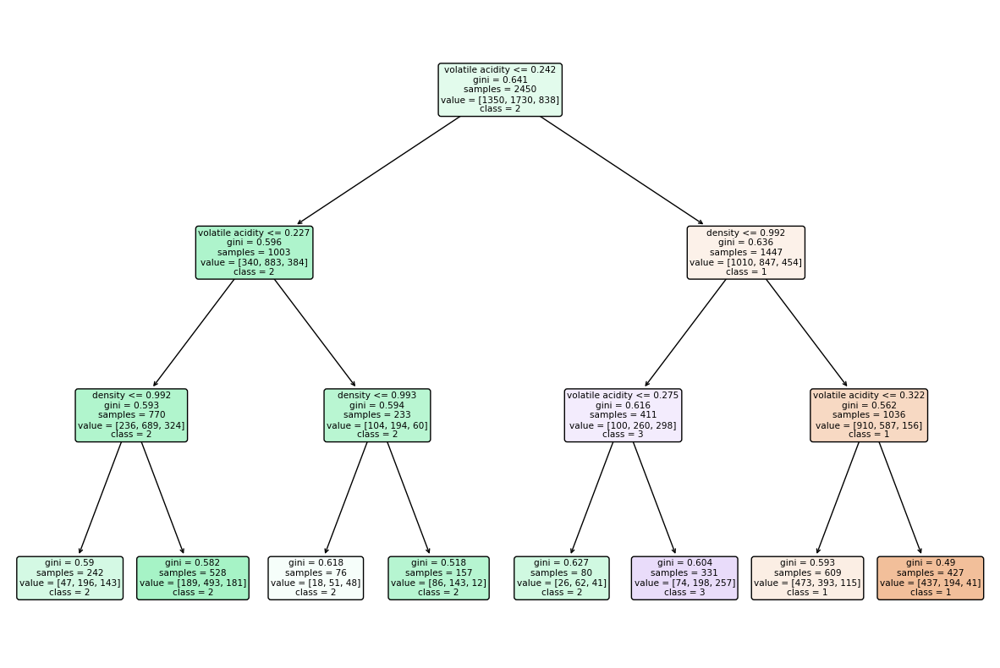

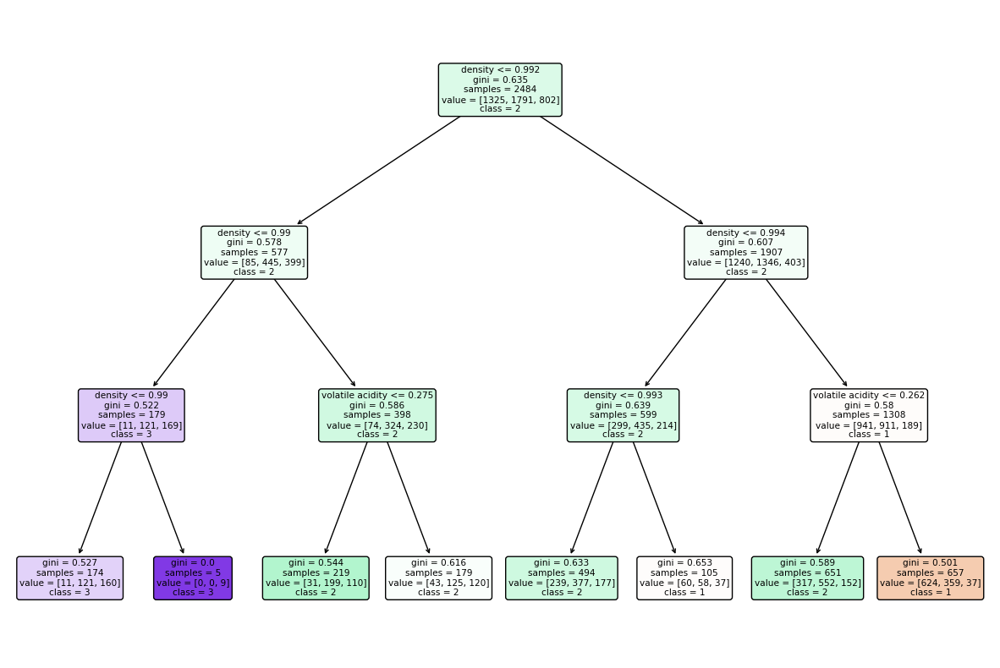

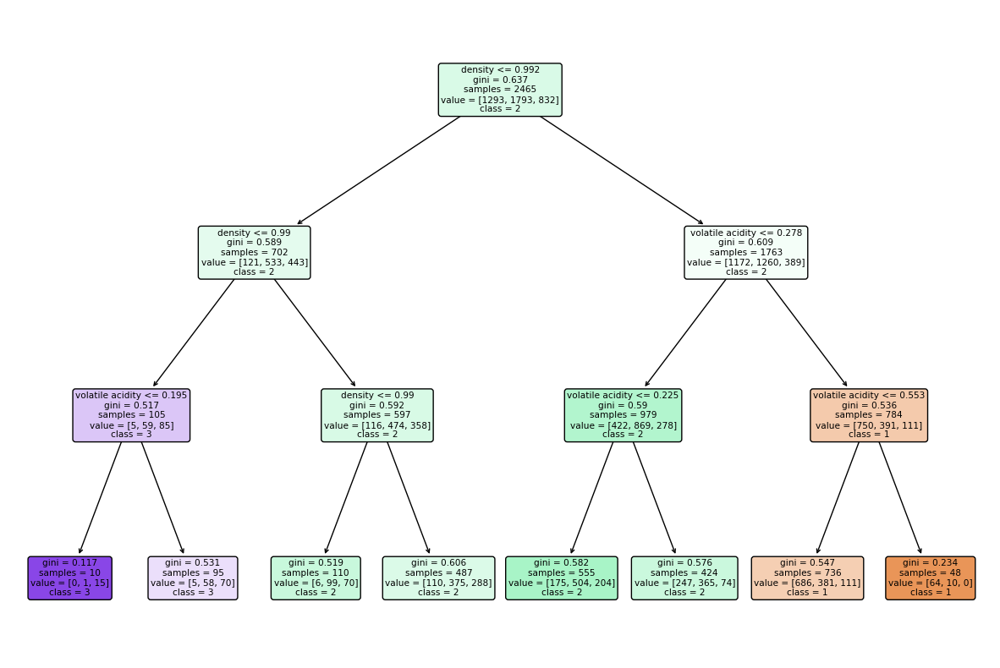

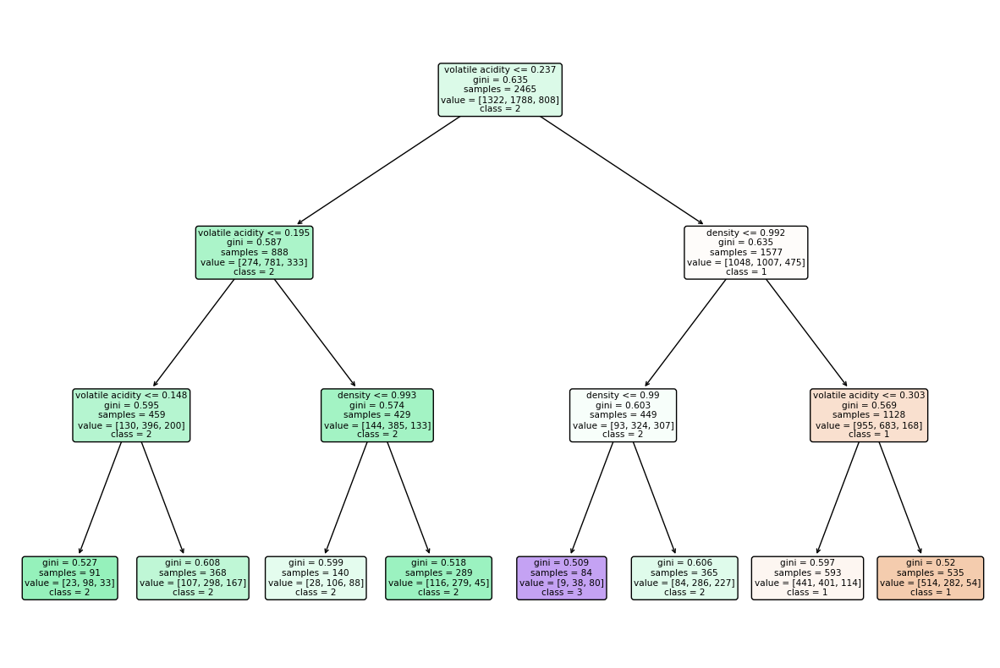

In [ ]:
RandomForest('volatile acidity','density','categoryNum',whiteWines)

##### Conclusiones y observaciones

+ EL randomforest con kfold presenta mejores valores, aunque en las dos primeras clases no se presenta una diferencia importante, pero en la clase del clasificador se presenta una leve diferencia, pero f1-score es mejor en el randomforest con kfold porque tiene un mayor equilibro entre los valores de precisión y recall en comparación al sin kfold que tiene un buen valor en precisión, pero el recall se obtiene un valor muy bajo.

+ En el randomforest sin kfold se obtuvieron valores de gui más bajos en comparación con kfold, por lo que el randomforest sin kfold es más homogéneo que con kfold.

####Atributo *total sulfure dioxide*

#####Con K-Fold Cross Validation

ARBOL CON KFOLD
              precision    recall  f1-score   support

           1       0.54      0.61      0.58       321
           2       0.47      0.67      0.55       432
           3       0.00      0.00      0.00       227

    accuracy                           0.50       980
   macro avg       0.34      0.43      0.38       980
weighted avg       0.39      0.50      0.43       980
 



/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.


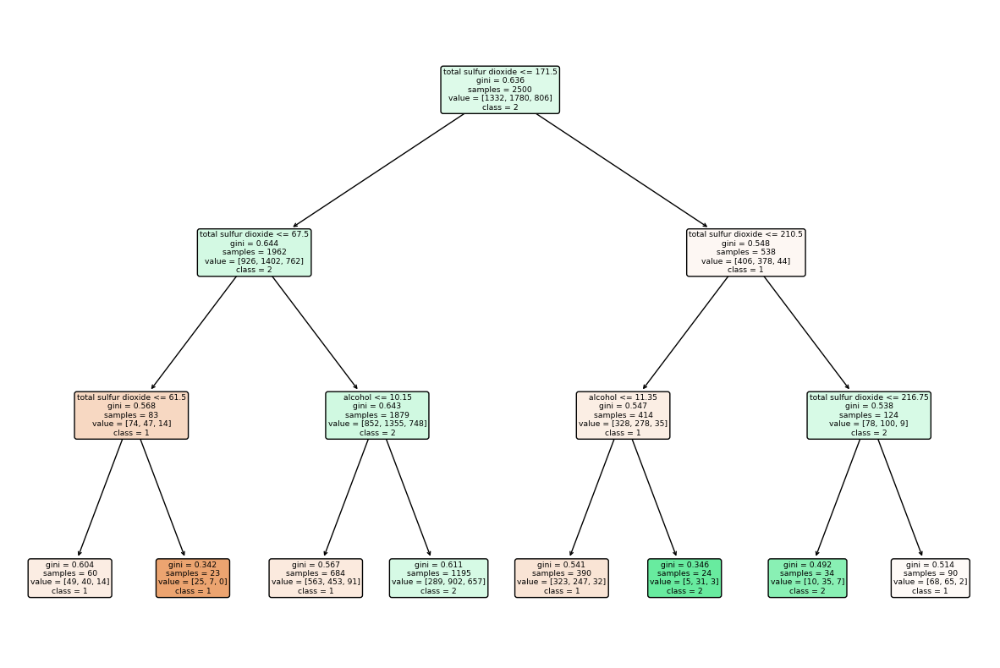

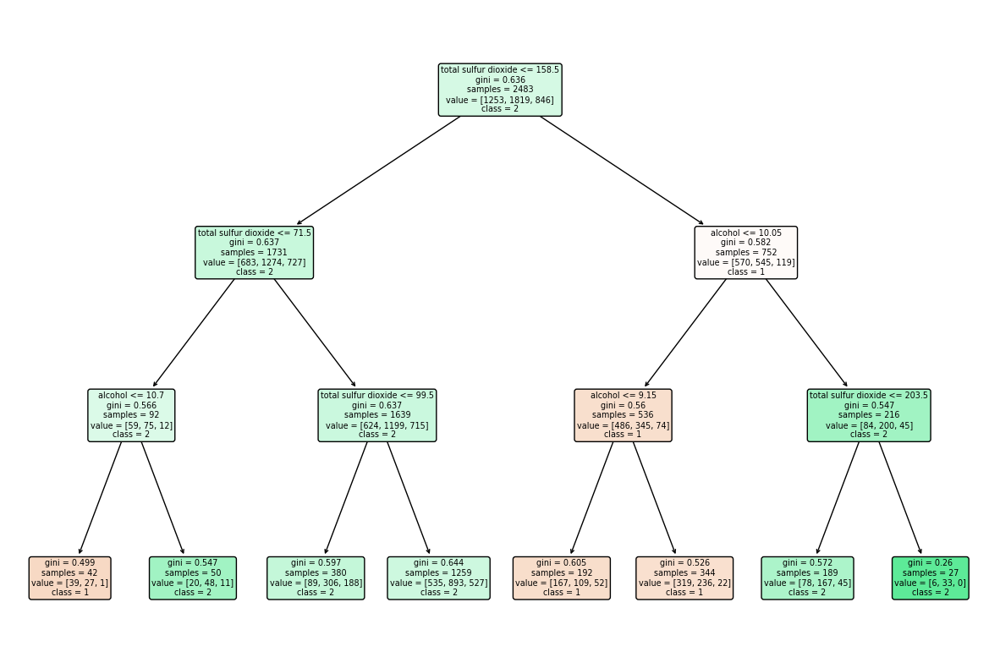

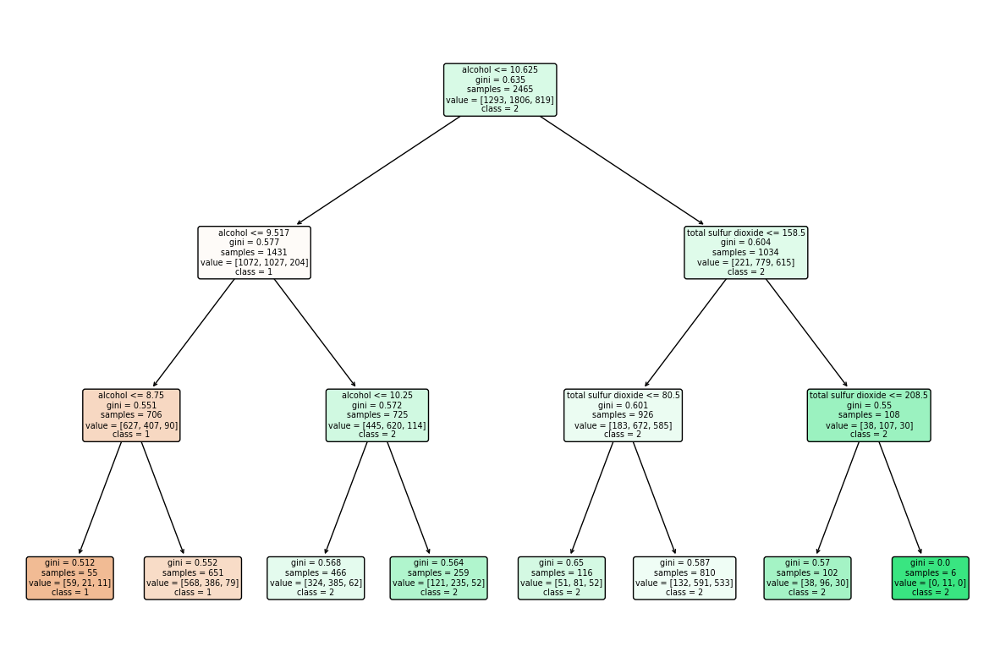

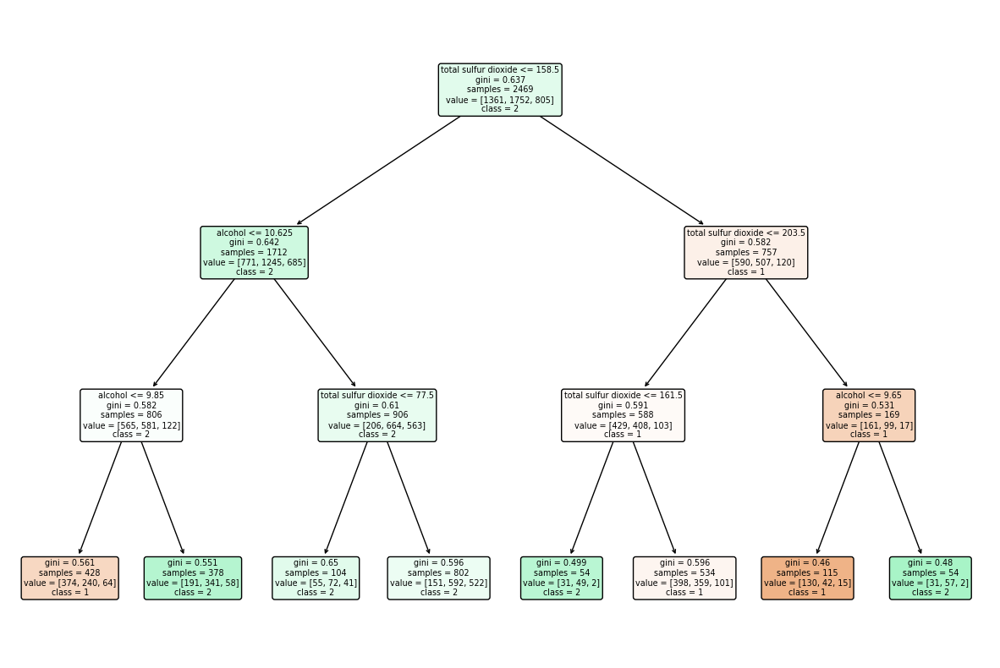

In [ ]:
RandomForest('alcohol','total sulfur dioxide','categoryNum',whiteWines,True)

#####Sin K-Fold Cross Validation

              precision    recall  f1-score   support

           1       0.54      0.57      0.56       321
           2       0.49      0.55      0.52       432
           3       0.56      0.39      0.46       227

    accuracy                           0.52       980
   macro avg       0.53      0.50      0.51       980
weighted avg       0.52      0.52      0.52       980
 



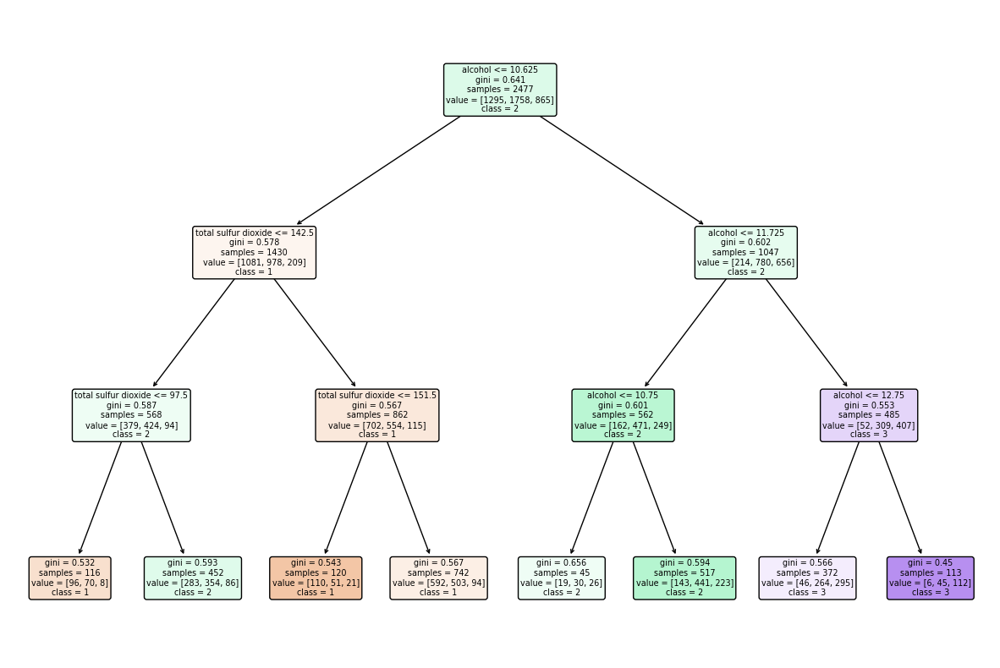

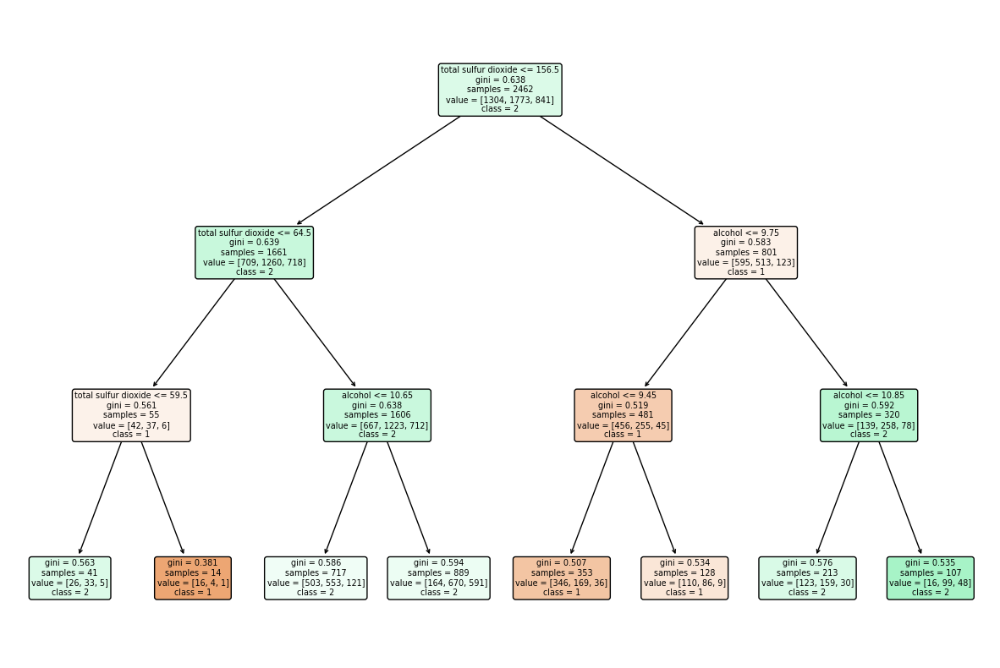

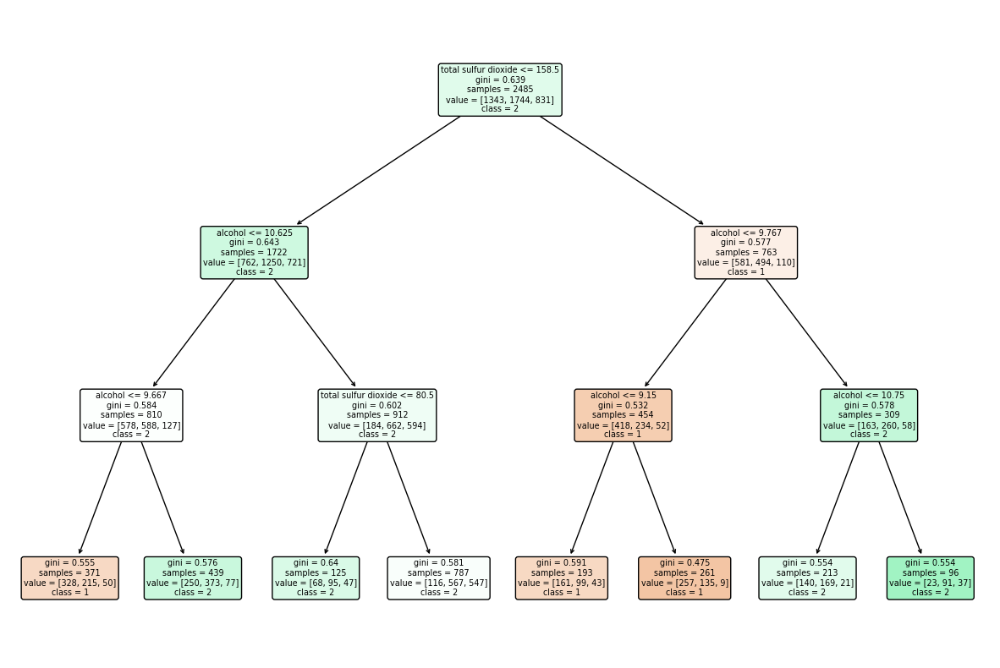

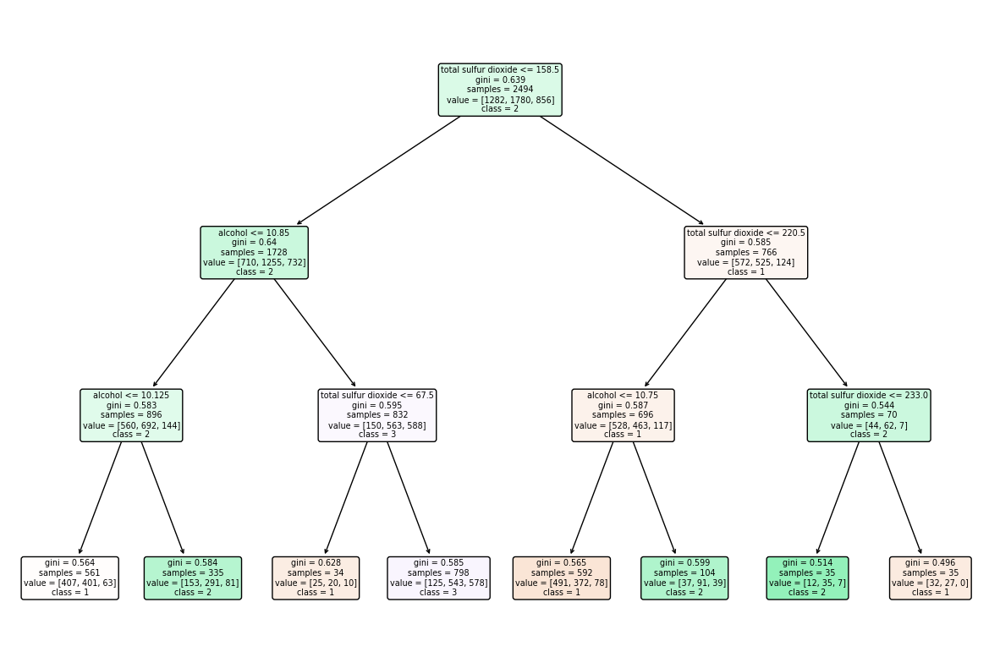

In [ ]:
RandomForest('alcohol','total sulfur dioxide','categoryNum',whiteWines)

##### Conclusiones y observaciones

+ El randomforest con kfold presenta una cualidad negativa que es tener en la clase del clasificador valores 0’s en precisión, recall y f1-score esto implica que no se pudo clasificar de buena manera con respecto a la clase clasificadora. Si ve el árbol más en detalle se observa que el randomforset con kfold nunca clasifica por la clase 3 (HighQuality) solo clasifica por la clase 1 y 2.

+ Este randomforest sin kfold presenta un mejor f1-score y recall que el resto de randomforest con buenos valores en el reporte de clasificación dentro de los dataset de vinos blancos.

###Vinos tintos

####Atributo *alcohol*

#####Con K-Fold Cross Validation

ARBOL CON KFOLD
              precision    recall  f1-score   support

           1       0.65      0.78      0.71       141
           2       0.52      0.53      0.53       132
           3       0.59      0.21      0.31        47

    accuracy                           0.59       320
   macro avg       0.59      0.51      0.52       320
weighted avg       0.59      0.59      0.58       320
 



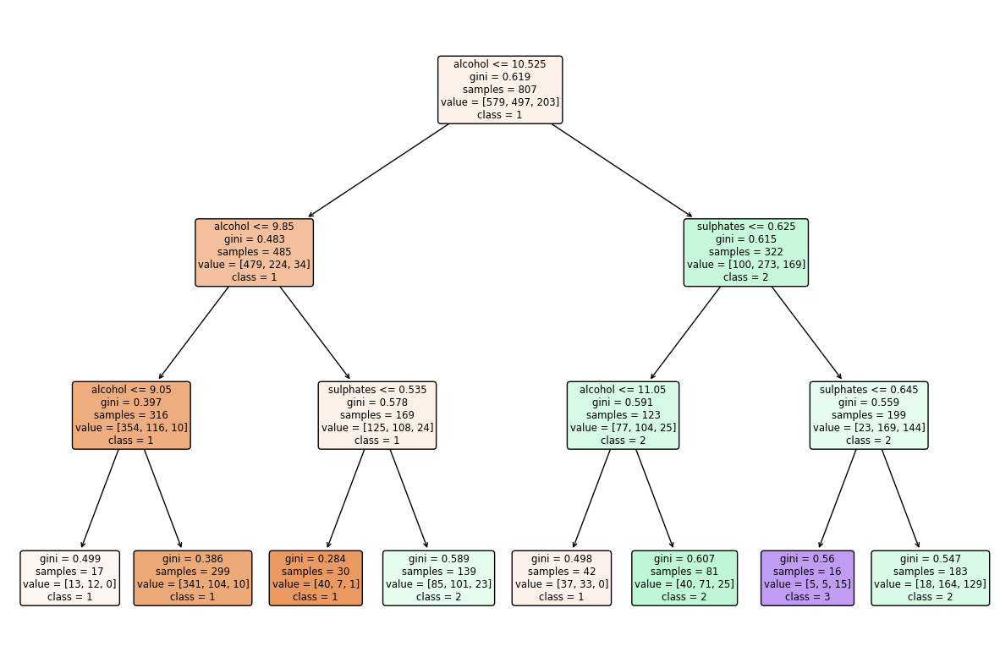

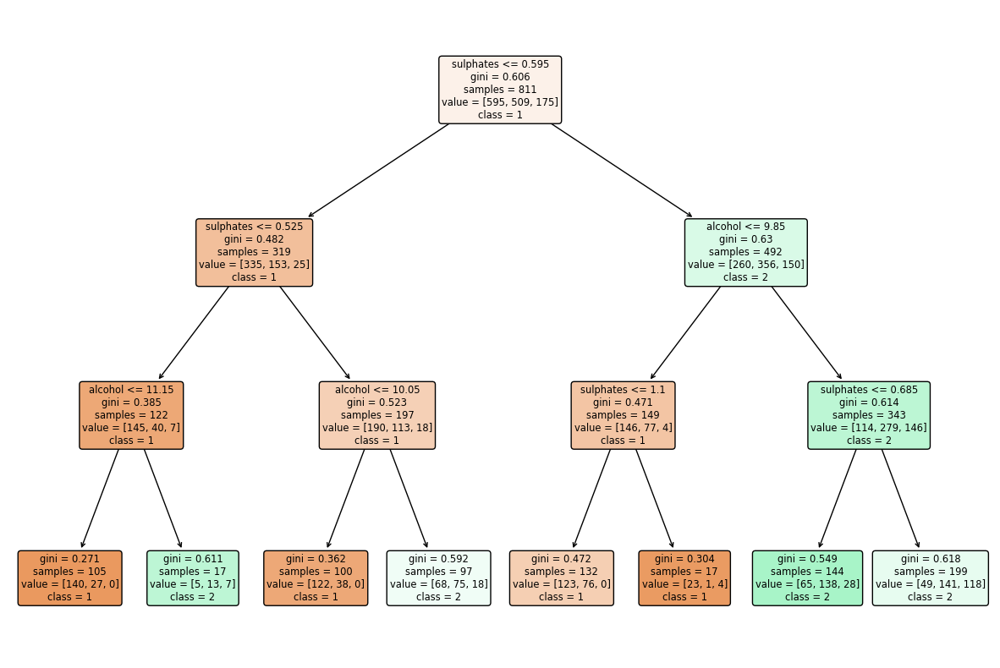

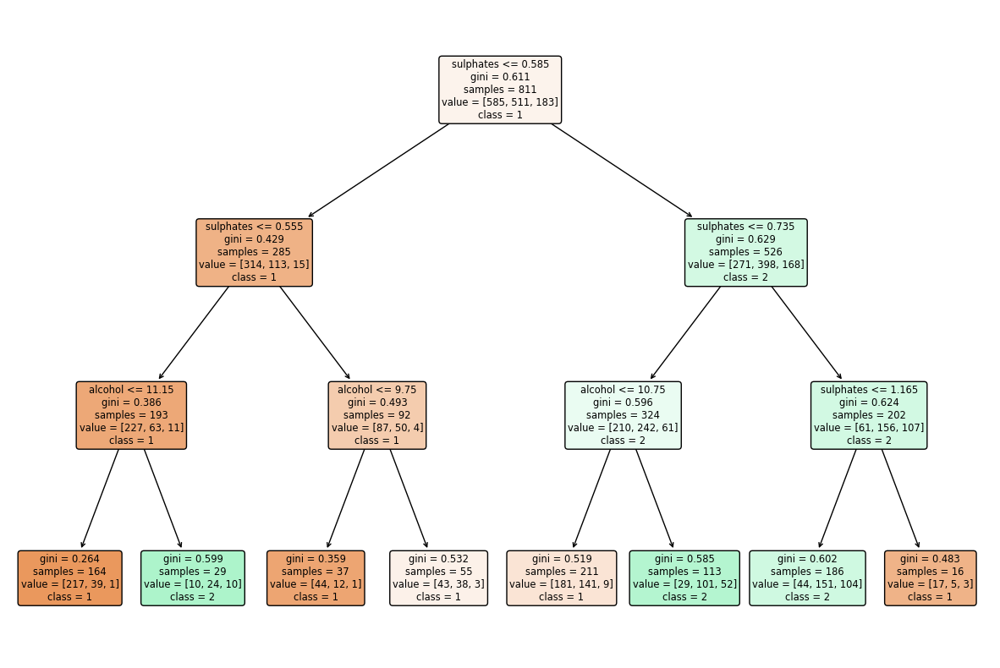

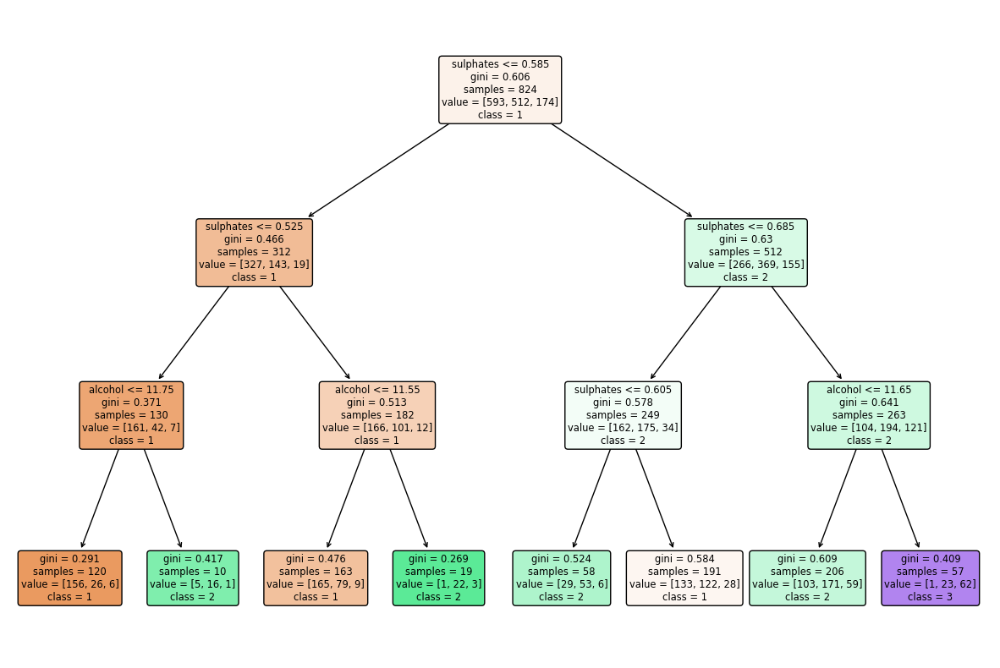

In [ ]:
RandomForest('sulphates','alcohol','categoryNum',redWines,True)

#####Sin K-Fold Cross Validation

              precision    recall  f1-score   support

           1       0.61      0.88      0.72       141
           2       0.56      0.40      0.47       132
           3       0.58      0.30      0.39        47

    accuracy                           0.60       320
   macro avg       0.59      0.53      0.53       320
weighted avg       0.59      0.60      0.57       320
 



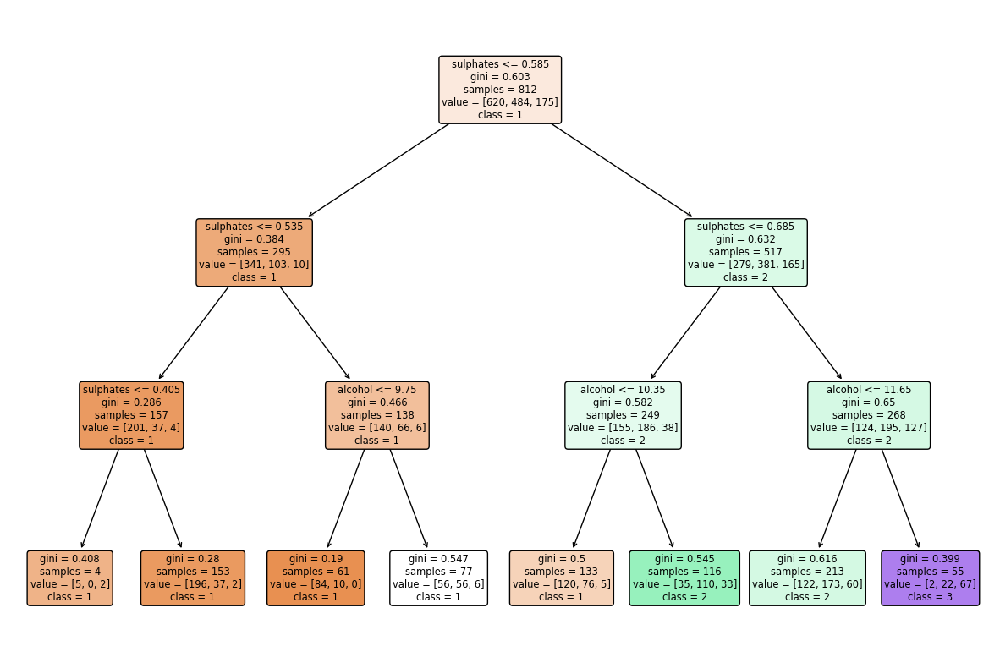

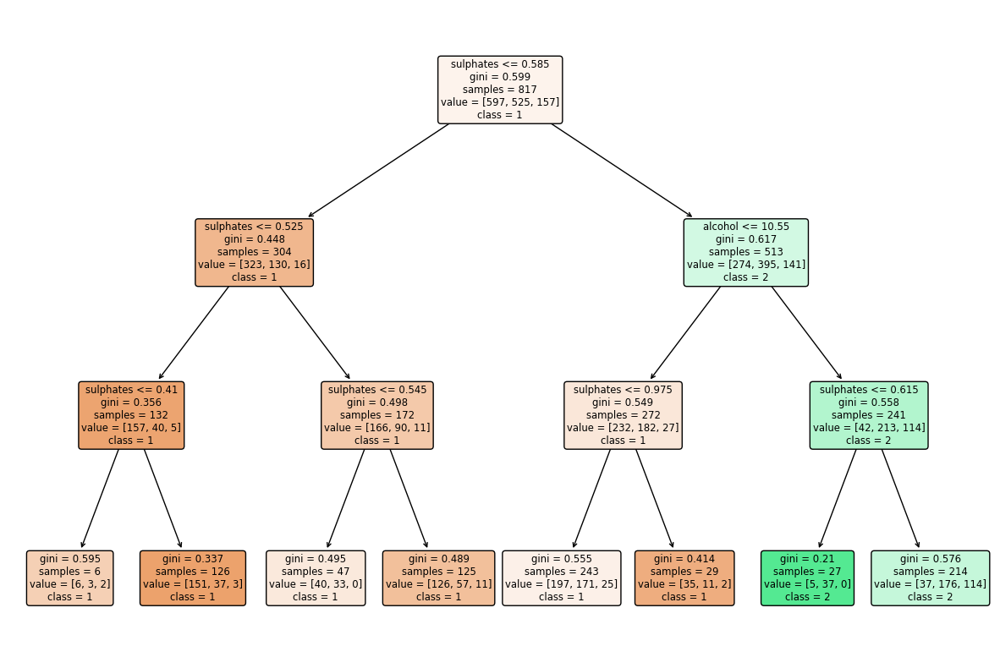

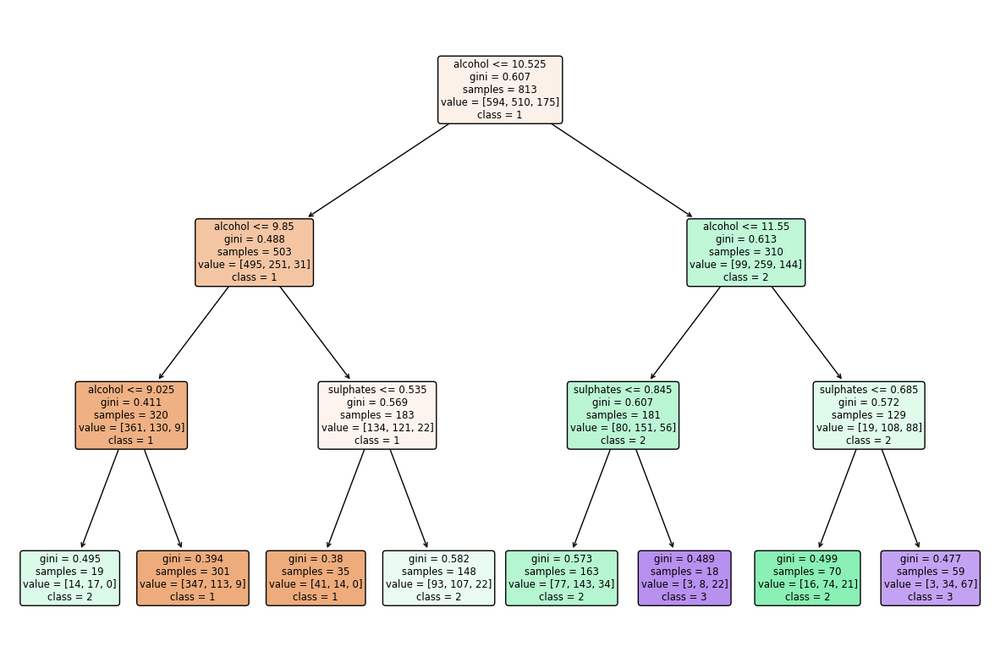

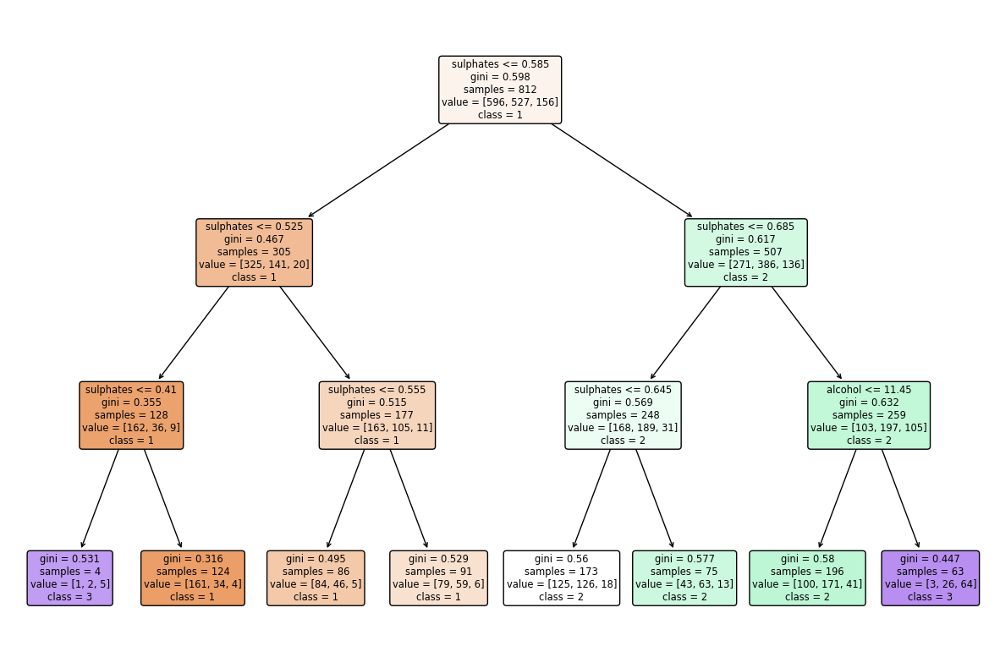

In [ ]:
RandomForest('sulphates','alcohol','categoryNum',redWines)

##### Conclusiones y observaciones

+ En el reporte de clasificación ambos casos con o sin kfold nos dan los mismos valores de precisión, recall y f1-score en las tres clases.

+ Viendo más en detalle la homogeneidad el randomforest sin kfold presenta un mejor promedio que con kfold:

Con kfold:

+ 1st Tree promedio: 0.49

+ 2nd Tree promedio: 0.47

+ 3rd Tree promedio: 0.49

+ 4th Tree promedio: 0.44

+ Promedio Total : 0.47

Sin kfold:

+ 1st Tree promedio: 0.43

+ 2nd Tree promedio: 0.45

+ 3rd Tree promedio: 0.48

+ 4th Tree promedio: 0.5

+ Promedio Total: 0.465

EL randomforest sin kfold es mejor por un margen muy pequeño.

####Atributo *volatile acidity*

#####Con K-Fold Cross Validation

ARBOL CON KFOLD
              precision    recall  f1-score   support

           1       0.69      0.75      0.72       141
           2       0.52      0.63      0.57       132
           3       0.33      0.04      0.08        47

    accuracy                           0.60       320
   macro avg       0.51      0.47      0.45       320
weighted avg       0.57      0.60      0.56       320
 



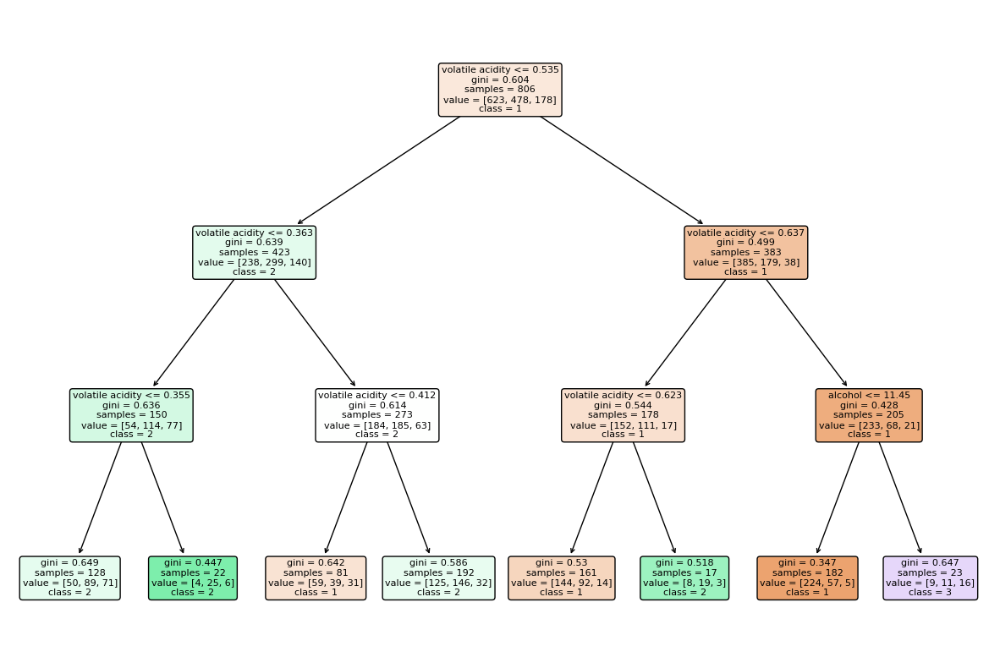

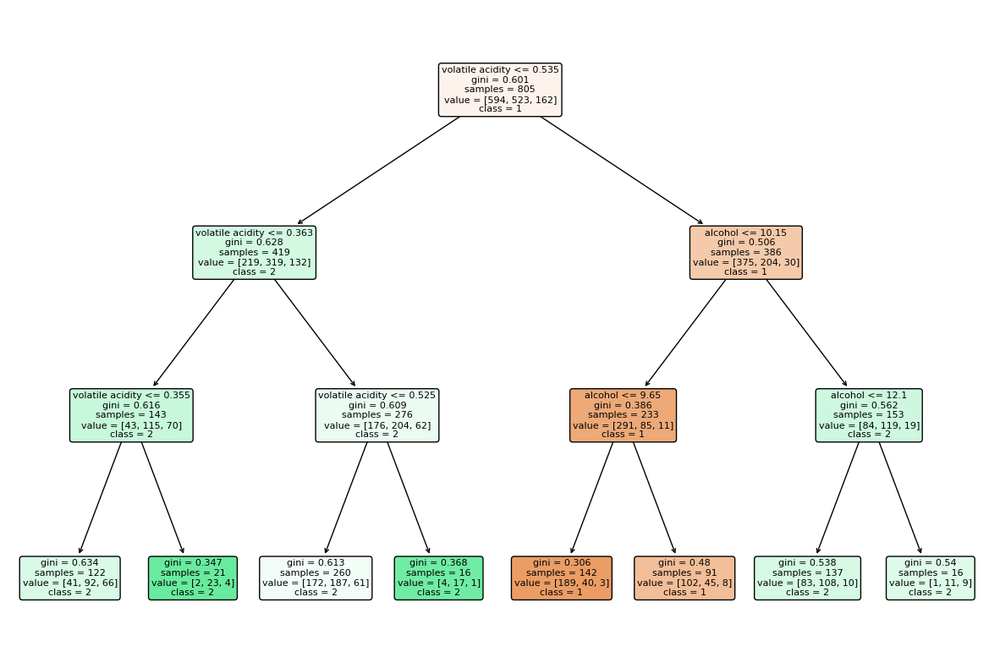

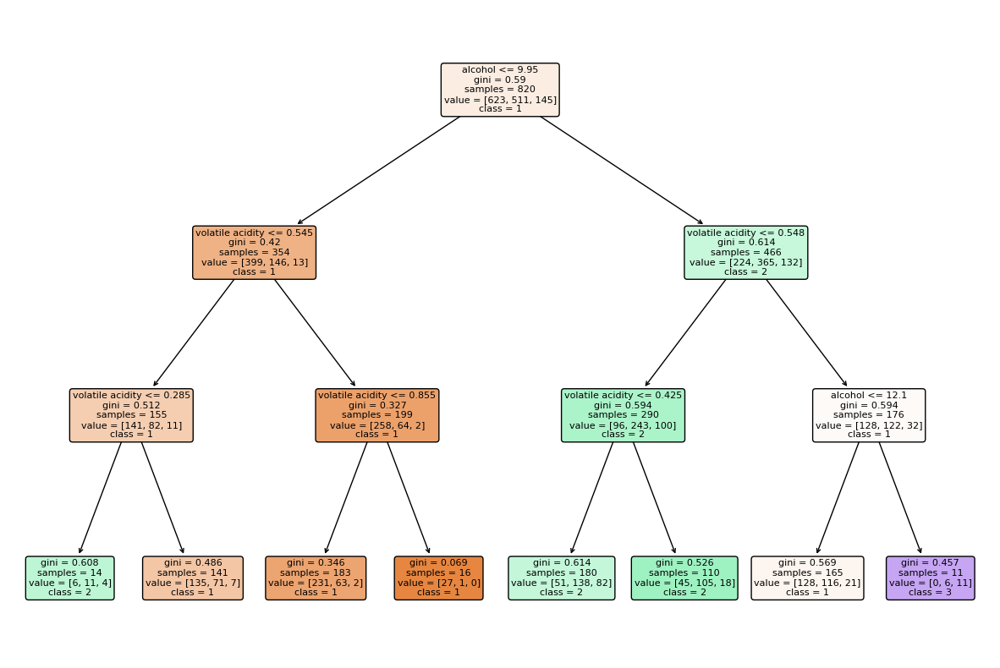

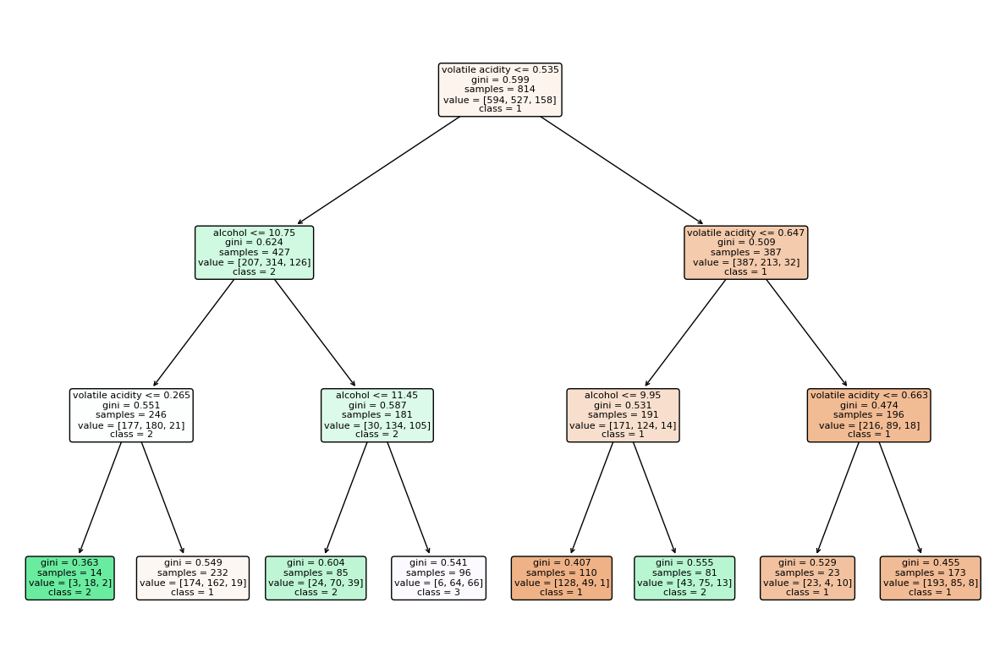

In [ ]:
RandomForest('alcohol','volatile acidity','categoryNum',redWines,True)

#####Sin K-Fold Cross Validation

              precision    recall  f1-score   support

           1       0.65      0.82      0.72       141
           2       0.50      0.42      0.46       132
           3       0.41      0.26      0.32        47

    accuracy                           0.57       320
   macro avg       0.52      0.50      0.50       320
weighted avg       0.55      0.57      0.55       320
 



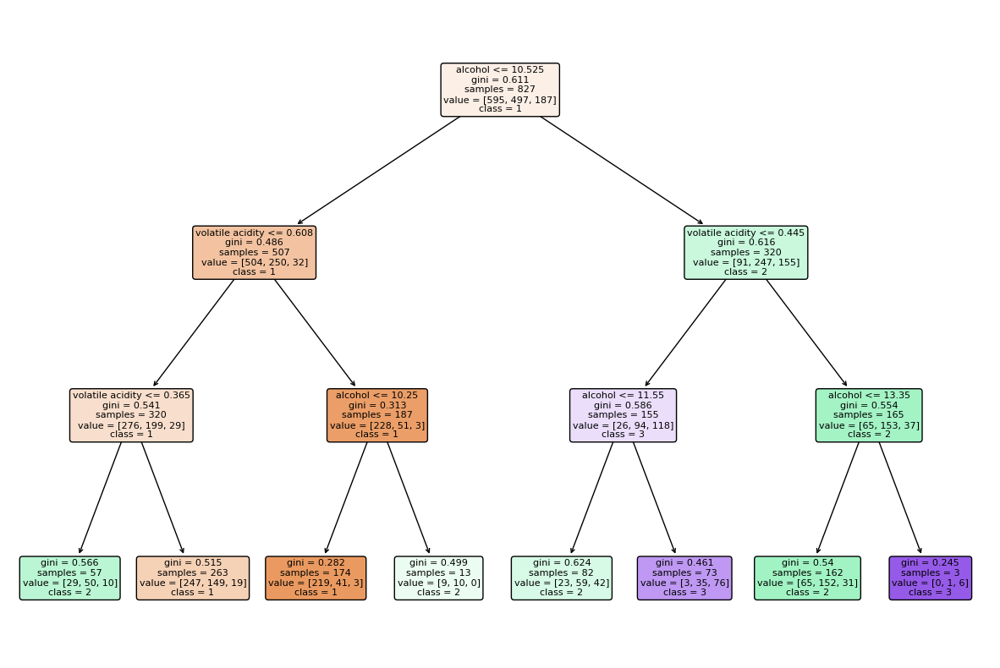

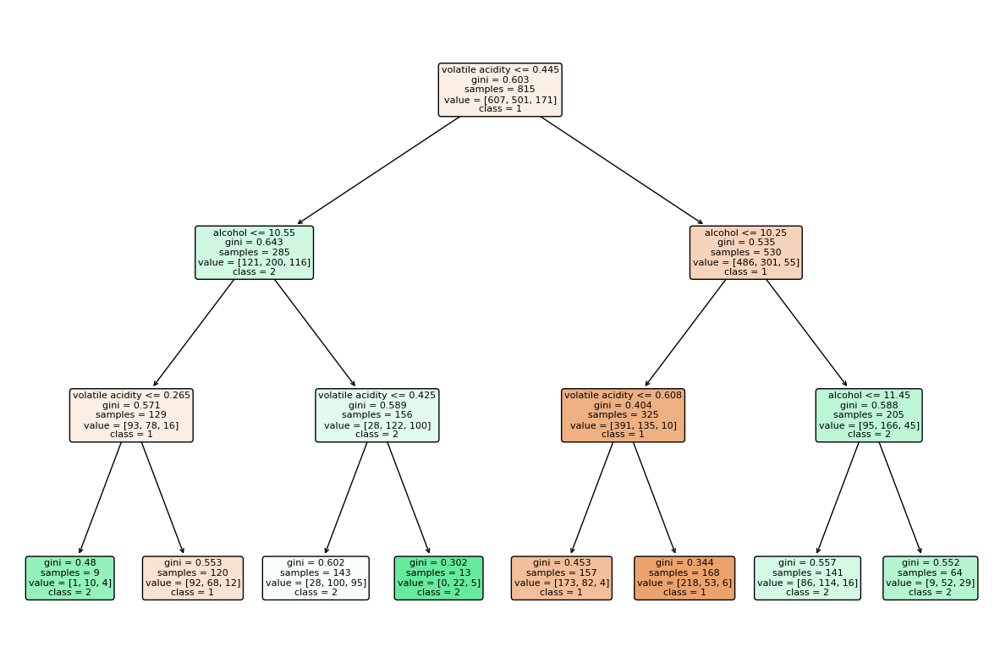

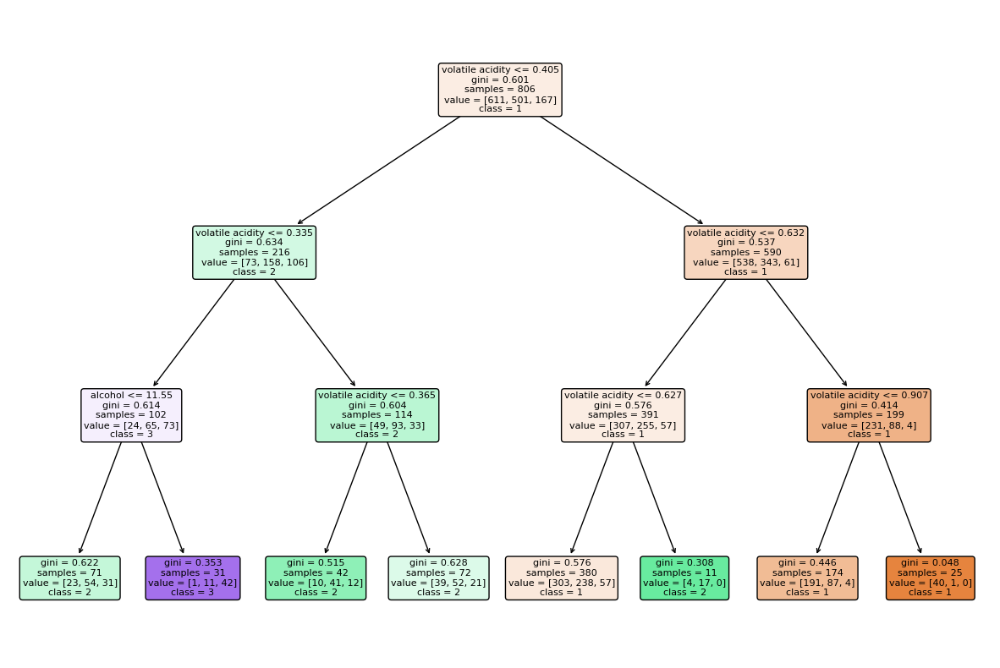

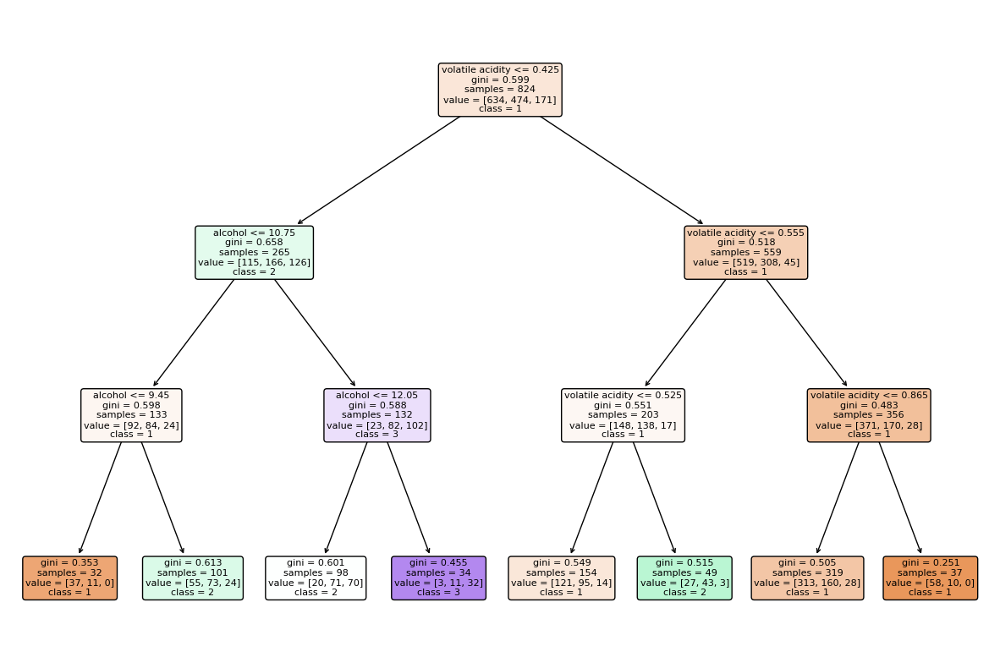

In [ ]:
RandomForest('alcohol','volatile acidity','categoryNum',redWines)

##### Conclusiones y observaciones

+ El randomforest sin kfold presenta unos mejores valores dentro del reporte de clasificación especialmente en la clase 3 debido a que el randomforest con kfold dio un valor muy bajo en el recall, esto dice que el randomforest con kfold tiene muchos más falsos negativos que verdaderos positivos que el randomforest sin kfold.

+ Ambos son muy parecidos en cuanto a la homogeneidad, presentan valores entre 0.4 y 0.7 muy a menudo con algún que otro valor gini con un valor bajo.

####Atributo *sulphates*

#####Con K-Fold Cross Validation

ARBOL CON KFOLD
              precision    recall  f1-score   support

           1       0.54      0.62      0.57       141
           2       0.42      0.50      0.46       132
           3       0.00      0.00      0.00        47

    accuracy                           0.48       320
   macro avg       0.32      0.37      0.34       320
weighted avg       0.41      0.48      0.44       320
 



/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.


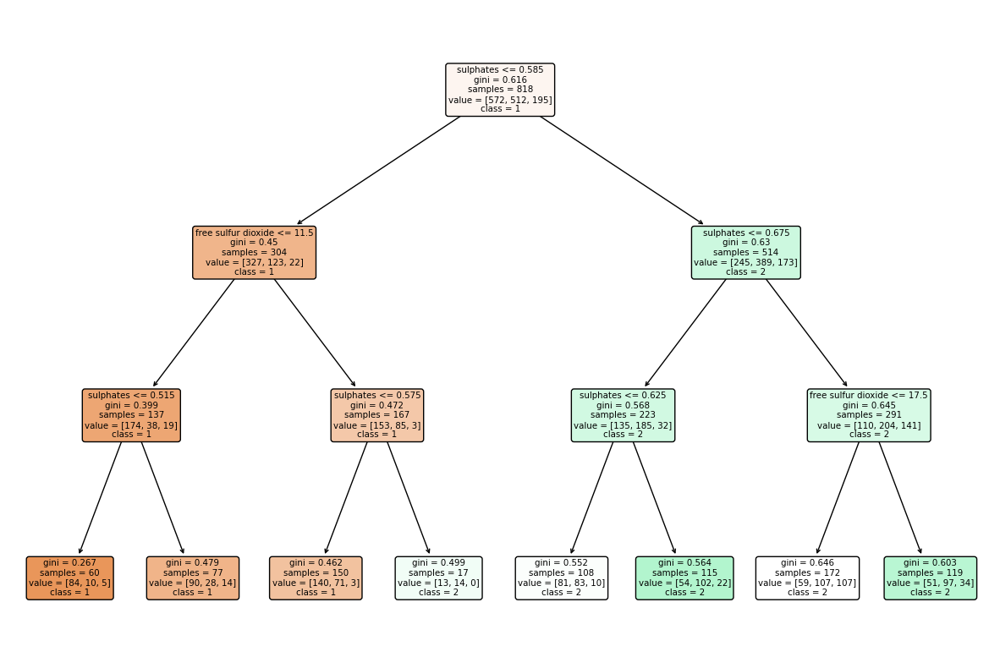

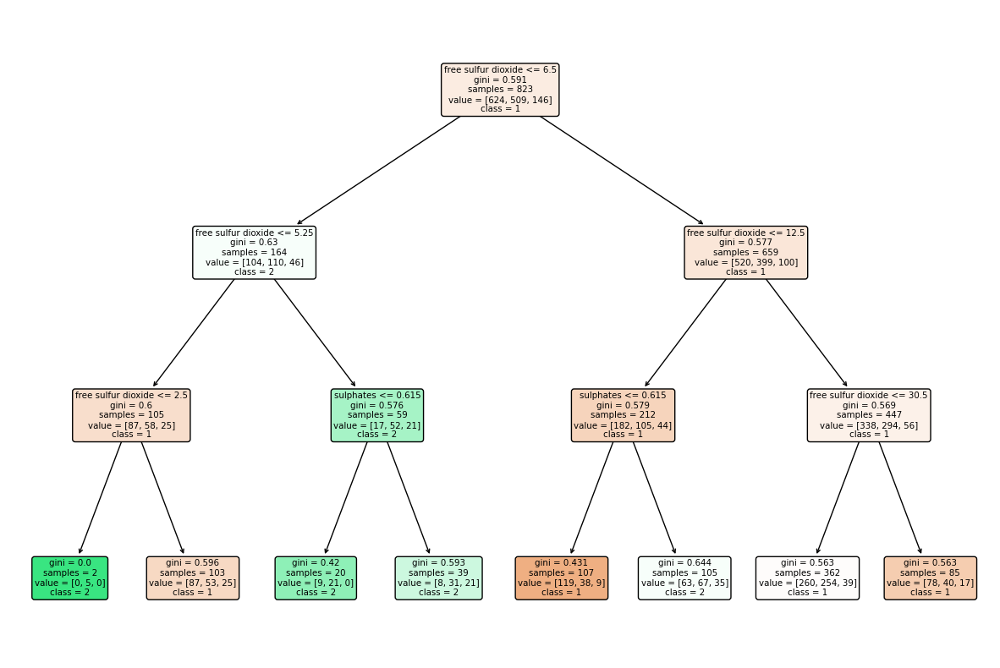

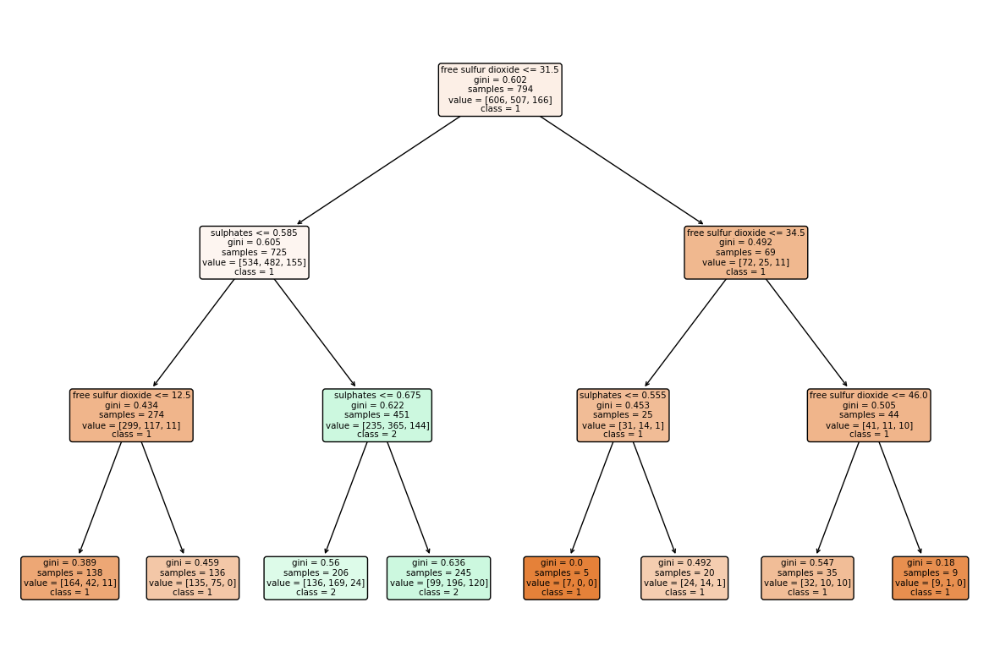

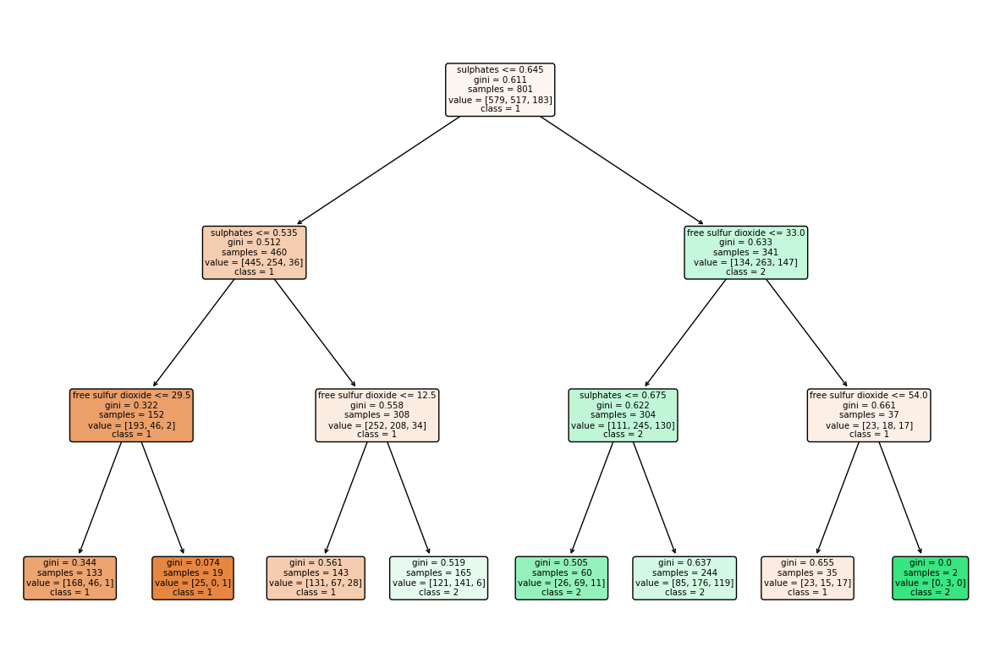

In [ ]:
RandomForest('free sulfur dioxide','sulphates','categoryNum',redWines,True)

#####Sin K-Fold Cross Validation

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.


              precision    recall  f1-score   support

           1       0.56      0.55      0.56       141
           2       0.43      0.59      0.50       132
           3       0.00      0.00      0.00        47

    accuracy                           0.49       320
   macro avg       0.33      0.38      0.35       320
weighted avg       0.42      0.49      0.45       320
 



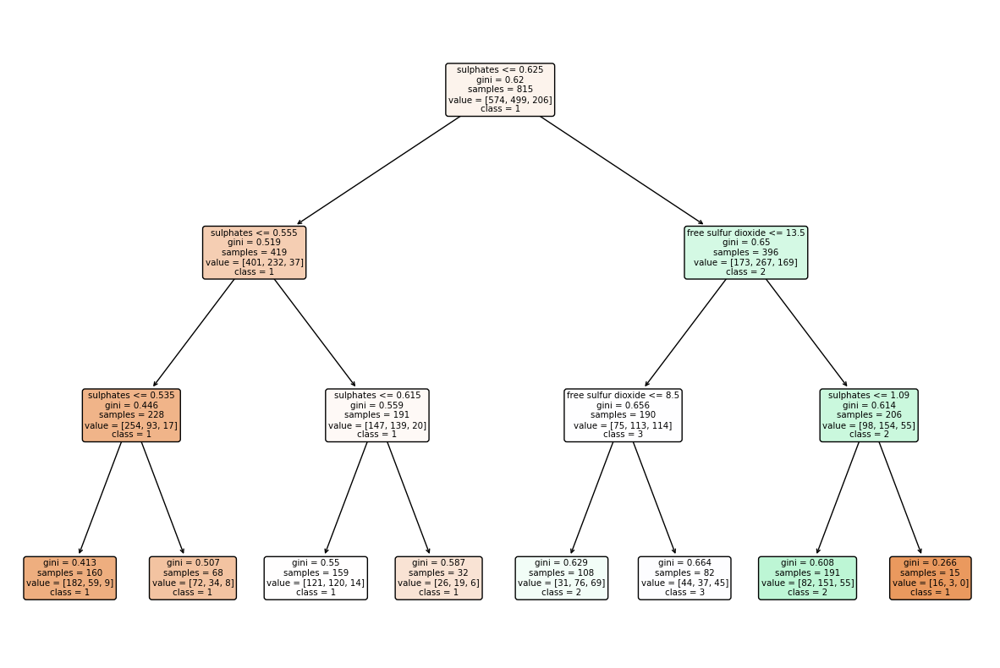

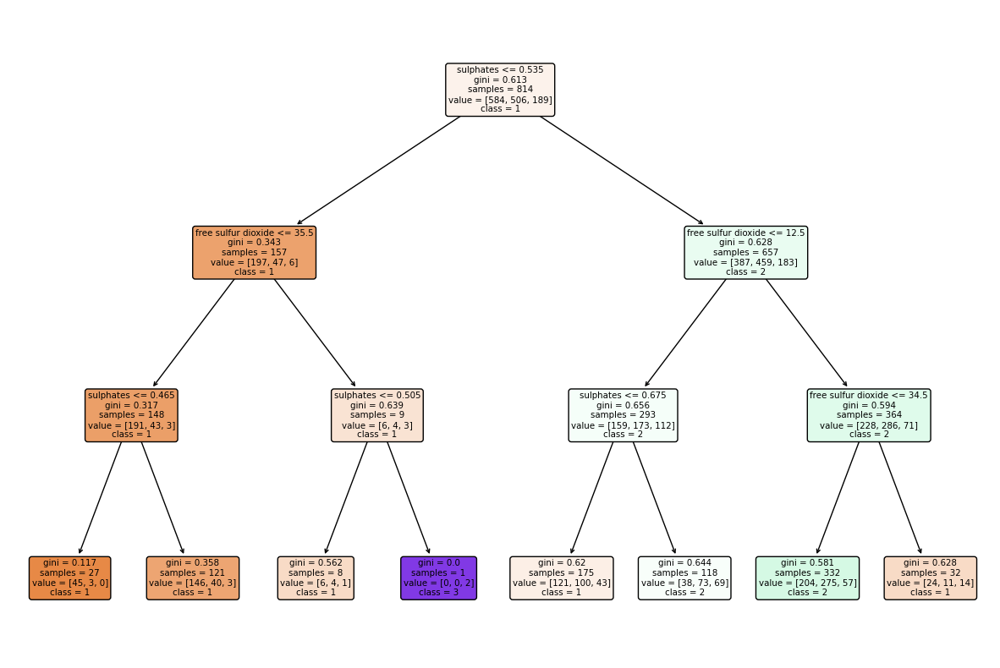

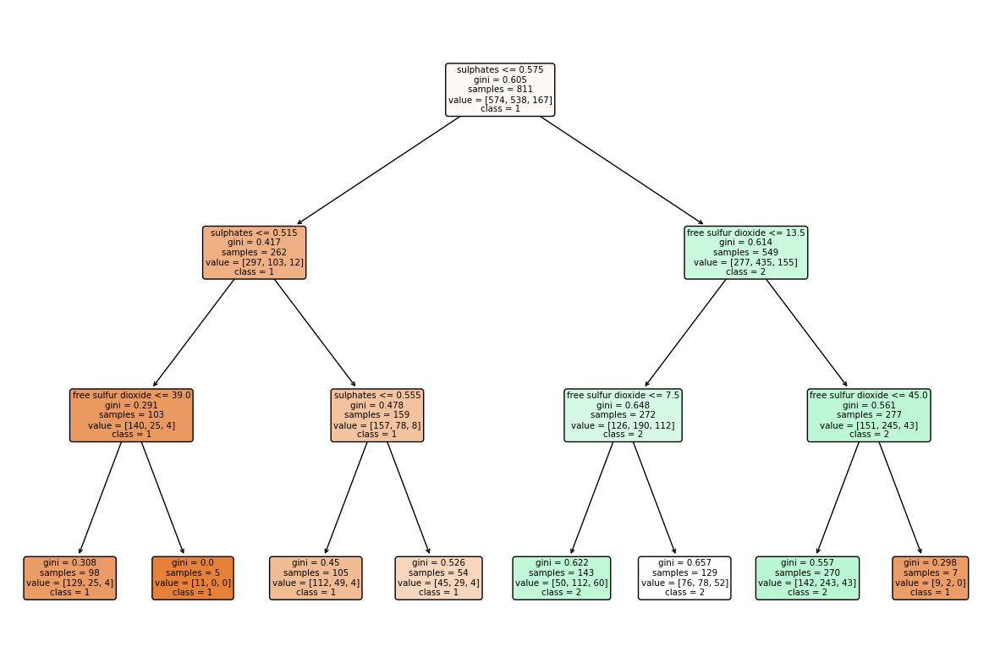

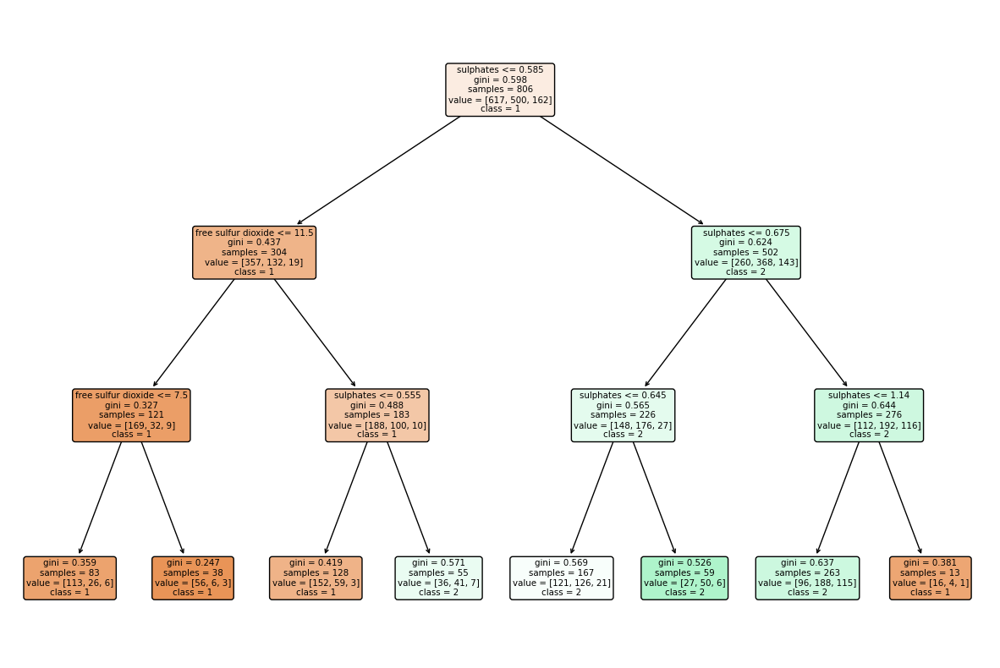

In [ ]:
RandomForest('free sulfur dioxide','sulphates','categoryNum',redWines)

##### Conclusiones y observaciones

+ Ambos randomforest con o sin kfold presentan el problema de obtener como valor 0 en precisión, recall y f1-score en la clase 3 teniendo de nuevo el problema de que no se pudo clasificar bien respecto al clasificador, posiblemente este caso en particular debido a que los dos no pudieron hacerlo se deba a un desequilibrio en los datos.

+ Observando él los árboles de ambos randomforest se ve que ninguno clásica respecto a la clase 3 por lo que no nos sirven ambos modelos.

##Conclusion RandomForest

Para los vinos blancos obtenemos que el mejor modelo fue el total sulfure dioxide sin kfold por obtener un buen reporte de clasificación y una homogeneidad buena con respecto a los otros atributos propuestos para el modelo. En el caso de los vinos rojos obtuvimos que total sulfure dioxide tanto con o sin kfold no fueron capaces de clasificar respecto al atributo clasificador, mientras que el mejor modelo fue el alcohol con un reporte de clasificación bueno e iguales tanto con o sin kfold, pero el que no contenida kfold obtuvo un mejor promedio de homogeneidad aunque por un margen muy pequeño.